# PicoBoi: A Handheld Gaming Device with GPS Functionalities


## Introduction
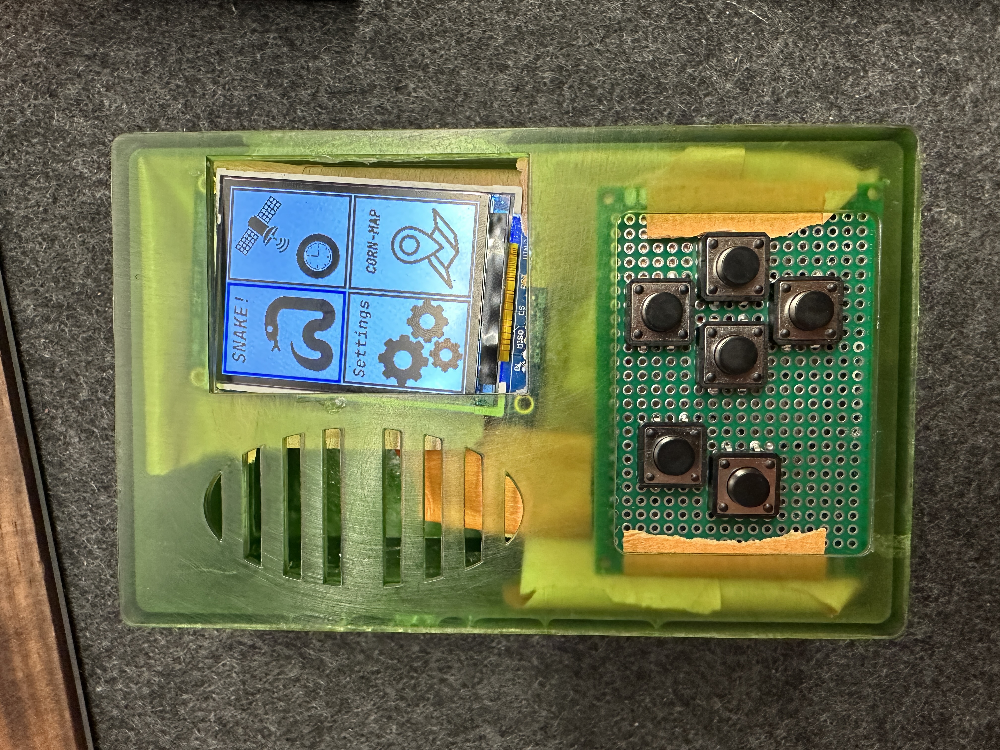
Drawing inspiration from the handheld gaming devices of our youth, we sought to utilize the RP2040 to recreate that experience with some cool and unique additions. Our Picoboi comes packed with a wide range of features, all of which are available in a device with a relatively compact form factor. These features include different game modes, original music, accurate time and GPS navigation. The Picoboi is a culmination of many of the ideas, tools and protocols covered in the course, and our intention was to create a stand alone device and platform capable of hosting a large variety of applications. Through our implementation of snake, GPS navigation and audio our intention is to show that with some creativity and ingenuity the sky's the limit for the Picoboi.

## High level design

This project aims to have a handheld device similar to a traditional GameBoy, but with some modern features. So it should have most of the hardware functionality of a GameBoy, such as a screen, a control pad, a speaker to play music, and a charging system. Besties those, we also added the support for GPS and wrote a library for that usage. Instead of having a linear-style software system, the way we designed our system treated each of the applications separately, meaning each software owns its own running environment and should be able to run in the background if necessary.  As we want to build this device from the ground up, we didn't go with the way of emulation but wrote a user interface system to contain our own applications. For the applications, we wrote a total of four apps: a snake game that the snake has the ability to move diagonally, a setting for the snake game in which the user can change the difficulty of the game, a satellite clock shows the current time in EST and indicating if the GPS module is getting a fix, and a map tracks the path where the user has been going through. This way, the user is able to have this standing-alone device, turn it on, and select the application they wish to run.

We tried several ways to improve the software performance, one of which is bringing the online computation offline, for example, the projection of the latitude and longitude of the user onto the 2D map is being implemented by using a python script to calculate the conversion factors and we hardcoded those coefficients into the GPS library we wrote to improve real-time performance.

### Equirectangular projection
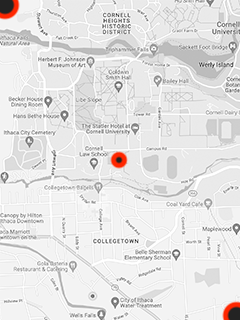

The Latitude and Longtitude infomation we have describes a point on a sphere, however, in order to display that on a 2d flat surface(our screen), we need to project such point onto the plane we have. As the area we gonna display on the screen is farely small(the Cornell Campus), we can use some relative simple projection such as the equirectangular project. Let use $R$ to denote the radius of the earth in meters, $\lambda$ as the longtitude of the point we want to project, $\phi$ as the latitude of the point, and we collect a center point from the map, where $\phi_0$ is the latitude of the center point and $\lambda_0$ is the longtitude of the center point, we can have projection:

$x=R(\lambda-\lambda_0)cos(\lambda_0)$

$y=R(\phi - \phi_0)$

And we can calcuate the $x,y$ value of the top-left and bottom-right point of our map, then do a two point linear regression to convert the $x,y$ value to pixel values on the screen. Those numbers can be computed offline as such:

In [1]:
import numpy as np

In [2]:
#lat-long
mid=[42.444493,-76.483730 ]
up_left=[42.455345,-76.494570]
buttom_right=[42.433823,-76.472446]

home=[42.43528657760313, -76.48587321578678]
R=6371000

In [3]:
X_left=np.cos(mid[1]*(np.pi/180))*R*(np.pi/180)*(up_left[1]-mid[1])
X_right=np.cos(mid[1]*(np.pi/180))*R*(np.pi/180)*(buttom_right[1]-mid[1])

Y_down=R*(np.pi/180)*(buttom_right[0]-mid[0])
Y_up=R*(np.pi/180)*(up_left[0]-mid[0])
print("x1: ", X_left,"x2: ", X_right)
print("y1: ", Y_down,"y2: ", Y_up)

x1:  -281.71688041438676 x2:  293.2558375085227
y1:  -1186.4498672979555 y2:  1206.687343946736


In [4]:
x_proj_slope = (240-0)/(X_right-X_left)
x_proj_bias = 240-x_proj_slope*X_right


y_proj_slope = (320-0)/(Y_up-Y_down)
y_proj_bias = 320-y_proj_slope*Y_up

print("xp=",x_proj_slope,"*x+",x_proj_bias)
print("yp=",y_proj_slope,"*x+",y_proj_bias)

xp= 0.41741110929054287 *x+ 117.59175555964036
yp= 0.1337156927301988 *x+ 158.64696589539855


## Program/hardware design

### Hardware


### The Modularized System
In order to decouple subsystems, we decided to divde our hardware to three separated components: The Control Pad, the Button Pad, and the Screen. The button pad and the screen connects the control pad with a custom connecter onto a custom socket designed for that connecter. This way, we can modulize the whole system to prevent single point failure.

#### The Control Pad
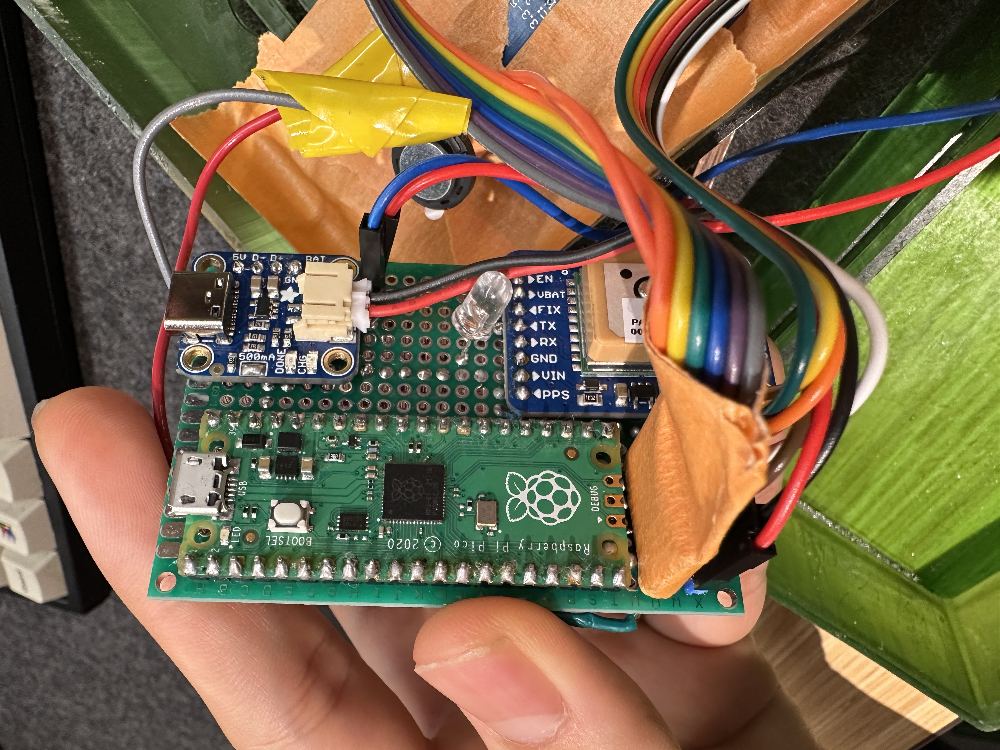


The control pad has most of the electric hardware including the charging/power system, which is the combination of the three components, the 2000mAh Lip battery, the Lipo charger with a Type-C connector, and a switch for the user to turn on and off the device. For the microcontroller, we are using a Raspberry Pi Pico, which is used for all the computing tasks of our program, and the code and the byte array of our images are stored in its 2MB flash. And for the connection with the Adafruit Ultimate GPS module, as we only need to receive data from the GPS we only connect the RX port on the Pi Pico to the TX port on the GPS module. And we connect the coin speaker directly. Even tho we have built the OpAmp circuit while prototyping, for the case we designed, we decided to just connect them directly.


#### The Button Pad
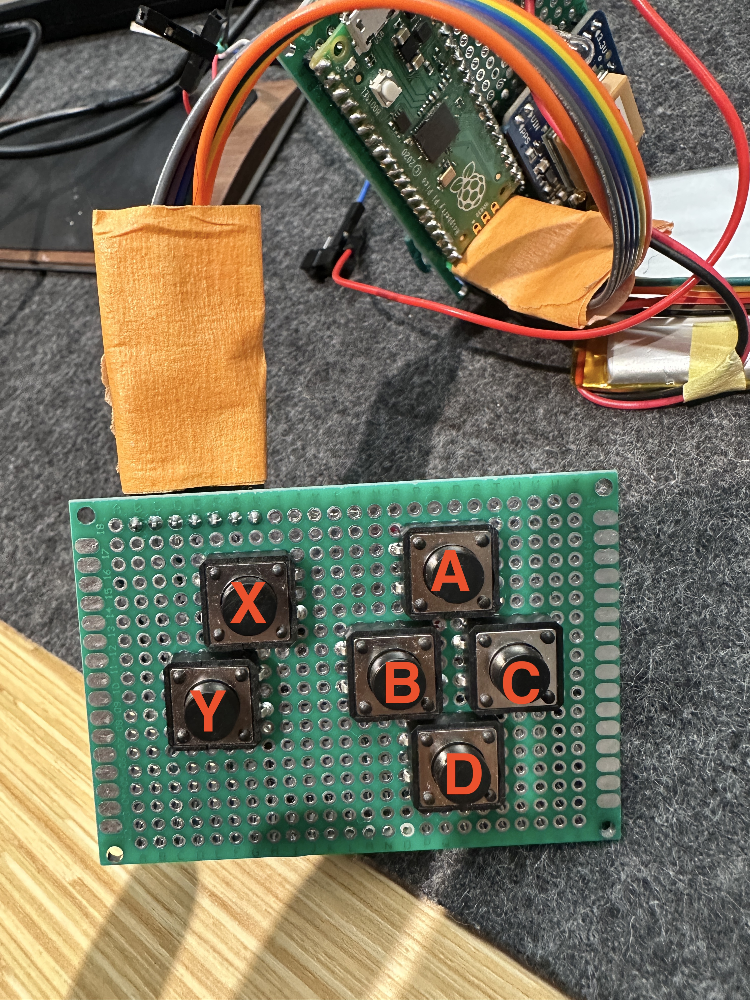

The Button Pad supports all the major user interactions with the 6 buttons on the pad, the button X, Y, A, B, C, D. The X button is used for the "select/enter" functionalities, the Y button is used for "exit" , and the rest 4 buttons are for "select".

### The Case
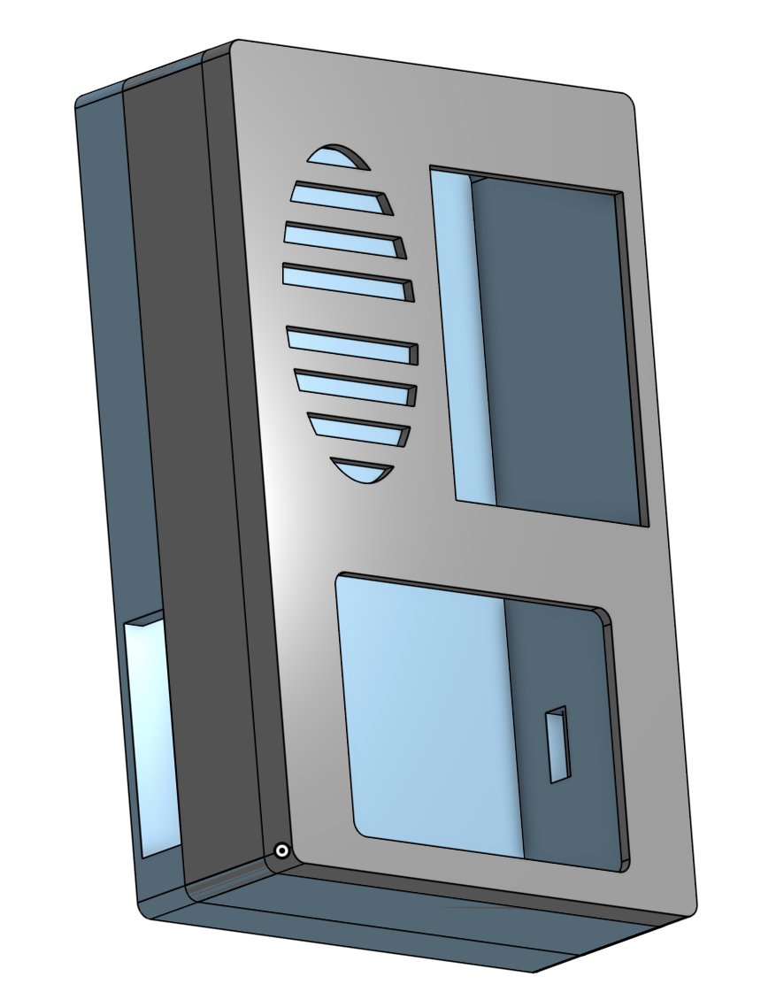

For the case, we developed several prototypes, with the first one being too small(with respect to our socket design). We designed the case using OnShape MCAD tool, and printed it with a resin 3D printer.

### Software

#### System Overview



As for the structure of the system, we have a main() function to do the system initialization, including setting up the GPIO function and interrupts, the repeating timer, and the threads. There are five threads in total running on core 0, one for each application, plus one for the menu. And three interrupt handlers: the RX interrupt handler, the repeating timer interrupt, and the button press interrupt.

#### The State Machine and variables

A global variable is declared to keep track of the current state of the system, for example, we use -1 to indicate the system is in the menu, 0 for in app0, 1 for in app1…etc. In each thread, it first checks if the current state is the application this thread corresponds to, if not, this thread will be ignored.

For each application–including the menu, we have declared a binary initialization variable to indicate if this is the first time this thread got executed. And the thread executes some initial setups depending on the value of those variables.

#### Buttons

The user uses the buttons on the control pad to input instructions, and the functionality of the buttons on the pad depends on the specific application that is currently running.

#### The Debouncing Algorithm

We want to ensure the button presses reflect the real situation, so a debouncing algorithm is implemented to prevent a single press from being detected multiple times. This is achieved by having a repeat timer interrupt triggered every 1 millisecond. In total, we have 6 buttons, and we declared a cool-down variable for each of the buttons, for the cool-down variable being larger than 0, the button is not valid to be detected as pressed. And every valid press of the button will reset this cool-down variable to a predetermined value.

#### The Button Callback function

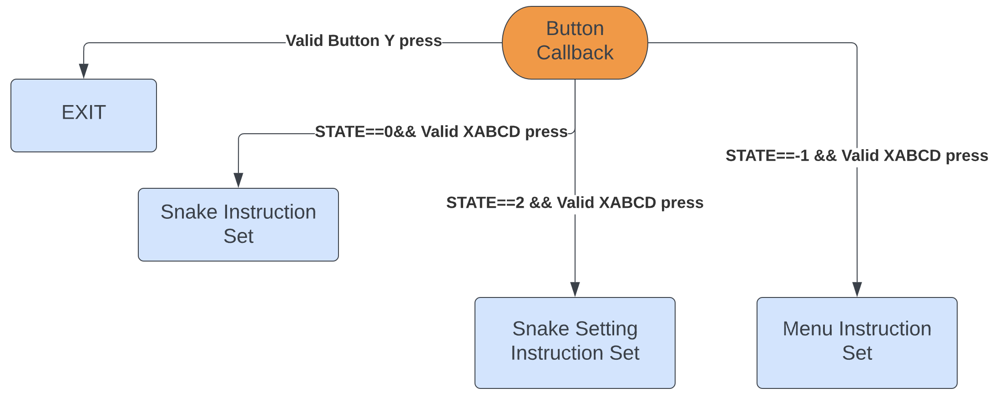

All the GPIOs for the buttons are sharing one single callback function which is triggered on the rising edge of each GPIO port. This function carries the corresponding GPIO number of the one triggered. We validate a button press by checking if its corresponding debouncing cooldown variable reaches zero. However, the response of the button press depends on the current state of the system. Except for the button Y, which is used as an exit button, and that functionality is valid throughout the system. And what it does is reset the cool-down variable for button Y, and set all the initialization variables to 1 as all the apps are exited. And turn off any possible on-playing music.

#### Menu
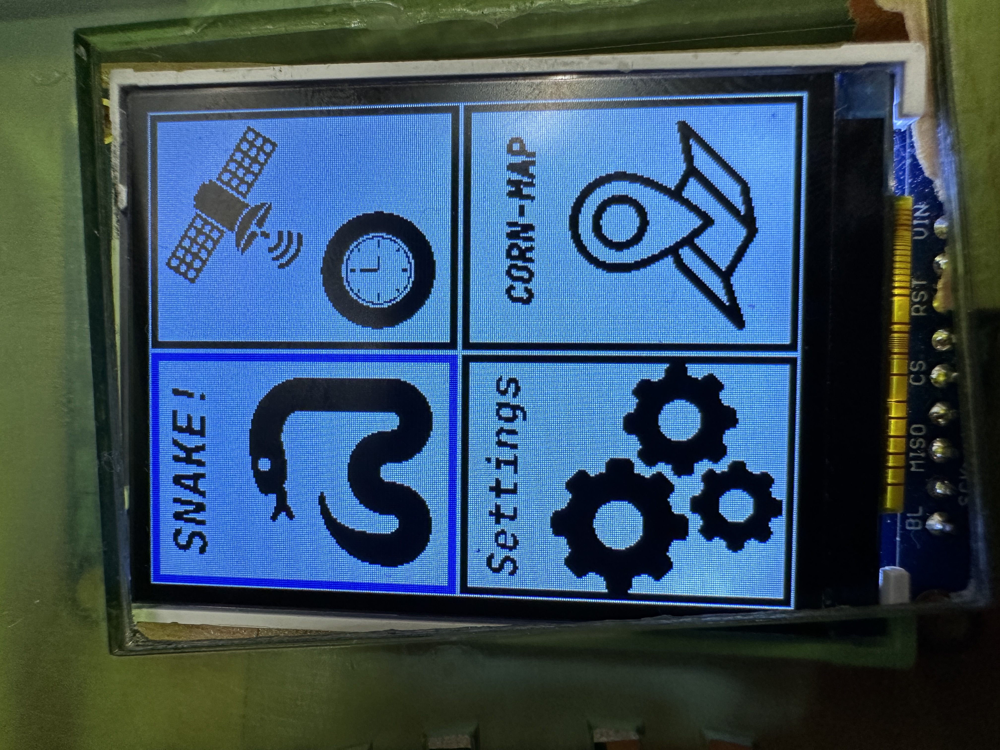

We have created a library for the menu, and the graphics functionalities are based on the library built for the screen we are using. This library is mainly being used to provide functionalities to draw the outlines and logo for each application and the selectors.
The Logo Bitmap
We created some png logos in Photoshop with the correct sizes, converted each pixel to a byte value, formulate the whole picture to a byte array by an online website[1], and we stored the byte array in our header file.

#### Menu Thread
If the current state is the menu, then inside of the thread, for the initialization, it draws a black background and draws the outline and the logo for the apps. And set the currently selected app to app0. As we have two variables, one is used to indicate the currently selected app, and the other one is changed inside of the button callback function to instruct the next app to select(this semaphore approach is used to not delay the interrupt). And for every execution of the thread, it checks if the currently selected app is the same as the draw command sent from the button callback, if they are different, it calls functions from the library to remove the previous selector, draw the one commanded, and reset the current application selected to be the one just drawn.
 

#### The Snake Game
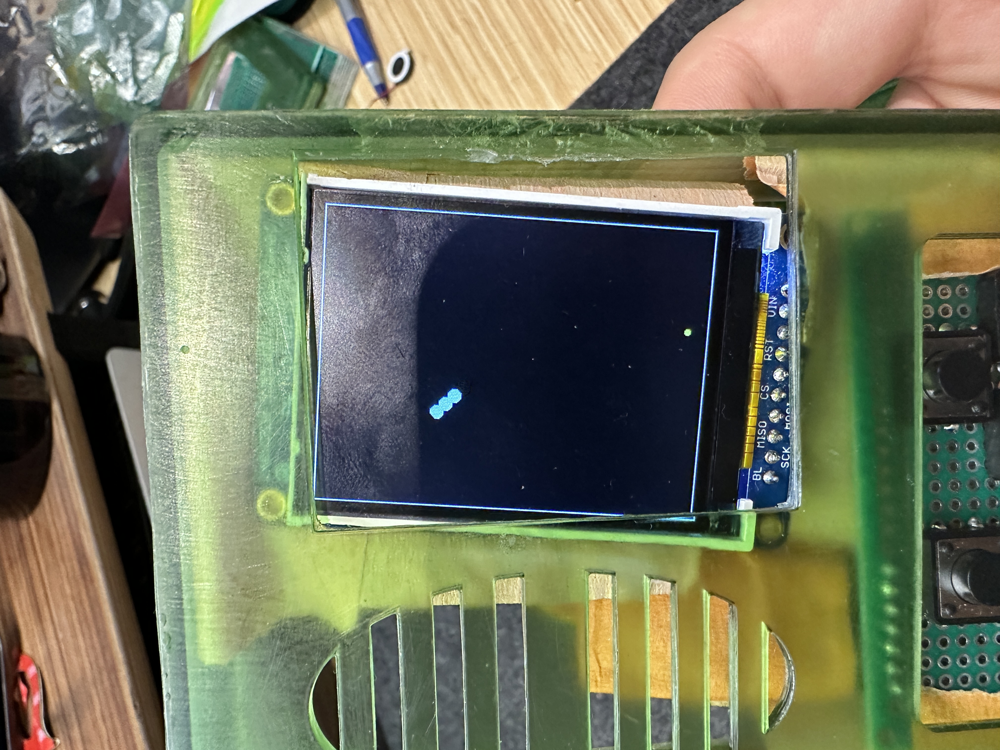

A library written from the snake game has all the functions and struct we needed for the snake game. We have a snake type declared to keep track of all the information during the game, which includes: two arrays that stores the x and y coordinate of the snake body, an int variable that stores the direction of the snake head, which has 8 possibilities as our snake supports diagonal movements, and variable keeps track of the length of the snake, and an array of size two which stores the current location of the food. A snake is declared as a global static variable. As we want a way to control the frame rate of the game, we declared a cooldown variable for the snake game update, which is decremented in the timer callback function.

#### The Snake Thread

```
if (App_0_init)
{
   tft_fillScreen(ILI9340_BLACK);
   draw_boundary();
   spawn_snake(&mysnake);
   draw_snake(&mysnake);
   App_0_init = 0;
}

```
For app initialization, we draw a black background and draw the boundary of the arena, then we call the spawn_snake() function to assign an initial value to each field of the snake, followed by draw_snake() which only draw the new head of the snake while remove_snake removes the tail of the snake.

```
       if(CD_SNAKE_FRAME==0){
           remove_snake(&mysnake);
           if (!update_snake(&mysnake)){
               //game over
               STATE=-2;
           }
           draw_snake(&mysnake);
           CD_SNAKE_FRAME=SNAKE_FRAME_CD;
          
       }

```
If CD_SNAKE_FRAME counts to zero, the next frame is ready to be executed. The update_snake() function returns a boolean value, indicating whether the game is over or not. If the game continues, we draw the snake and reset the frame countdown variable. Otherwise, we switch to the game over state.

### Snake Game Logic

#### ROrand()-The Real Random Number Generator

As the foods are supposed to be spawned randomly, surely, we can call the naive random function with some specified seeds, but that will give the same number every time the board boots up. Because such a random number is calculated with the same parameter every time for that algorithm. So in order to make the foods spawn at different positions, an external random source has to be introduced. On the RP2040s, there is something called ring oscillators, which are basically a bunch of odd-number NOT gates. As a result, the reading of the output for these ring oscillators is not predictable.

```
// return random number by ROSC between 0-2^N
// N should be in [0,32]
fix15 ROrand(int N)
{
 static volatile uint32_t *randbit_reg = (uint32_t *)(ROSC_BASE + ROSC_RANDOMBIT_OFFSET);
 unsigned int random = 0;
 for (int i = 0; i < N; i++)
 {
   fix15 random_bit = 0x1 & (*randbit_reg);
   random = random << 1 | random_bit;
 }
 return int2fix15(random);
}
```
By using this feature, we were able to create a function with an input of integers ranging from 0 to 32, and the function outputs a fix15 ranging from 0-2^16(if unsigned int the range would be  0-2^32). 
***ROSC_BASE + ROSC_RANDOMBIT_OFFSET*** are the register addresses for the random bit value for the ring oscillator, and we can either include the corresponding header file or just define them ourselves. 
Thus we declared a pointer to this register and make it volatile. Depending on the value of the random number we want, we run a for loop, in which we read the value of that random bit and shift that bit into the random number we want to output. This operation should be fairly efficient as the shift operation is very cheap. 

#### Snake Update
We calculate the new location of the head with respect to the direction in which the snake is moving. And we declare a temperate location array, set the first element of the array as the new head, and move the previous location array to the rest of the temp array. This way, we calculate the position array for the next frame. With this new head location, we can check if the next frame is game over, by checking if the new head location is within some distance to the wall or the snake body, or if the game is over because the length of the snake is over the max allowed length. 
We generate the position of the food randomly by using this random number generator. For the event of the new head hitting the food, we remove the old food, copy the temp array to the snake’s field, and increase the length. Otherwise, we don't keep the tail and keep the length unchanged.

#### Game Over
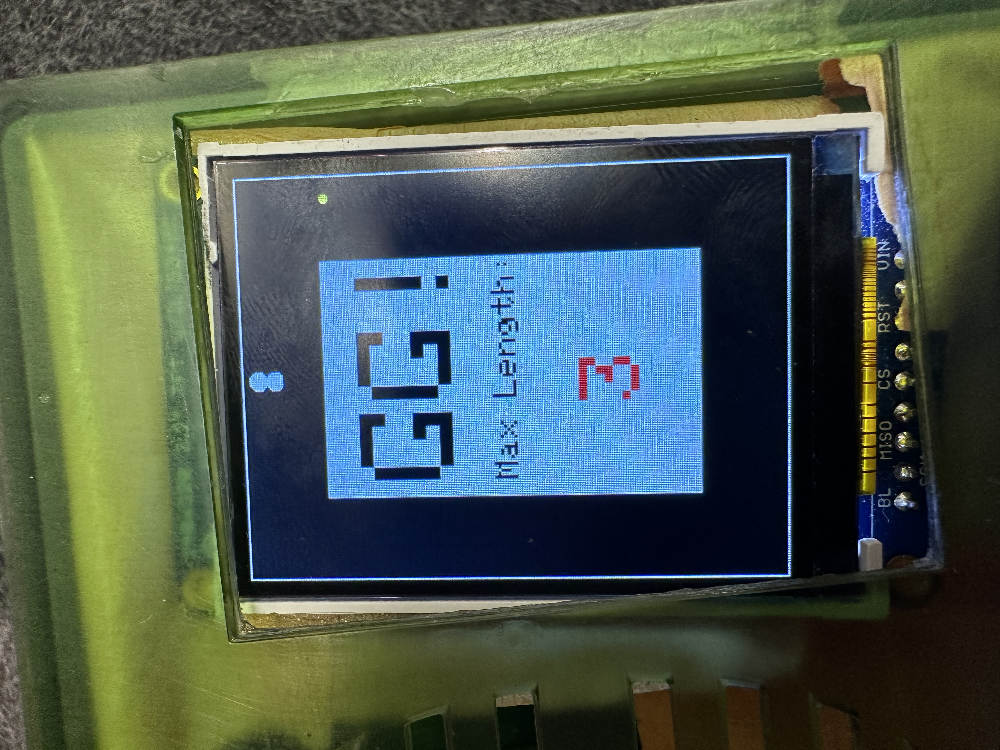

In the event of a game over, we change the current state to the game over state. Which shows a game over the screen and a score showing the length of the snake before death.
 
#### Snake Setting
The difficulty of the snake game is depending on the frame update speed, the faster the snake, the harder the game is. The selection of the difficulty UI reuses the menu graphic library but uses two extra different selection variables currentSettingN and drawSettingN, for the selection of the different difficulty levels, it changes the frame cool-down variable that resets.

### GPS

As the library adafruit provides is dependent on the Arduino filesystem and is written in C++. So we implemented our own GPS library from scratch. 
The GPS module constantly sends GPS messages through the UART channel, we have a UART RX interrupt handler for the event of receiving characters from the UART channel. As we need channel 0 for serial debugging, for the UART communication with the GPS module, we use channel 1. For the GPS struct, we have a buffer array called watch_dog with some specified size to store the latest data from the GPS, a character array stores the UTC time, 3 int variable stores the current hour, minute, and second in EST time, and two float variable each store the Latitude and Longitude information

In the RX interrupt handler we call a function in the library, buffer_shift, that shift a character to the end of the buffer and shift out the first character out from the buffer. This way, the buffer constantly contains the current GPS message. Even though there are a lot of GPS messages with different headers that can provide much different information, the one we care about is the GNRMC messages, which contain the UTC time, fix status, and location information. So we check the first five characters in the array, if that is GNRMC, we know the following data format. This way, we can get the time, location, and fix status by collecting the character at different intervals in the watch_dog. With the RTC battery, the GPS always sends the valid time if it at least got a fix before. However, it is not true for the location as the RTC would not help if there is no fix, thus we only get an update on the location if only the fix status is valid.
For the time, we process the string by converting the UTC hour, minute, and second to integer, and converting to EST time by subtracting the UTC time by 5(with the corresponding time rules). And stores them in the corresponding struct fields. For the fix status, we check if that character is “V” or “A”, if it is V, then the status is not valid, and vice versa. For the latitude and longitude, they are in the unit of degree-minute, and we have the function converting it to the radius.

As the interrupt function runs, the field in the GPS struct keeps updating itself, and we can extract that information as we need.

### The Sat Clock
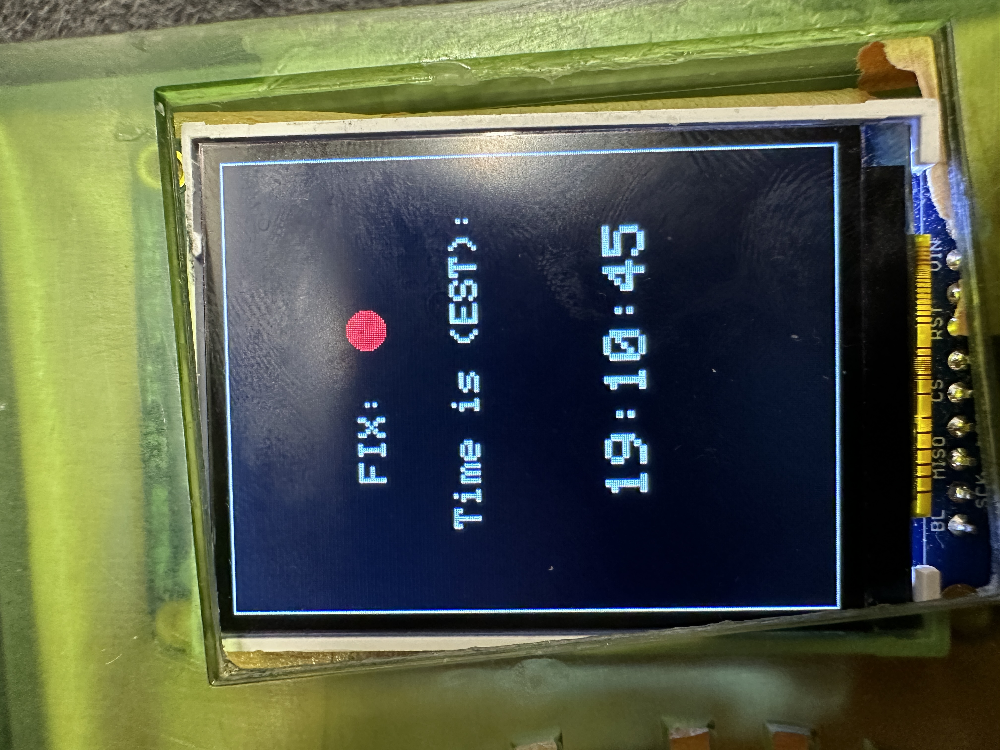
This application provides a fix status indicator and a clock in EST time. For initialization, it draws the background and the boundary using the menu library function.  As we don't want the screen to update too frequently, we also have a cool-down variable for the frame update. With a valid frame update, we display a red dot if we check FIX as 0, and green otherwise. For the time, instead of writing the string and then removing it by drawing a black rectangle. A built-in function in the screen library can let us specify the background color and update the string without the flicking effects. We process the 3 int variables to string and use this function to update the on-screen clock.

### The Sat Map

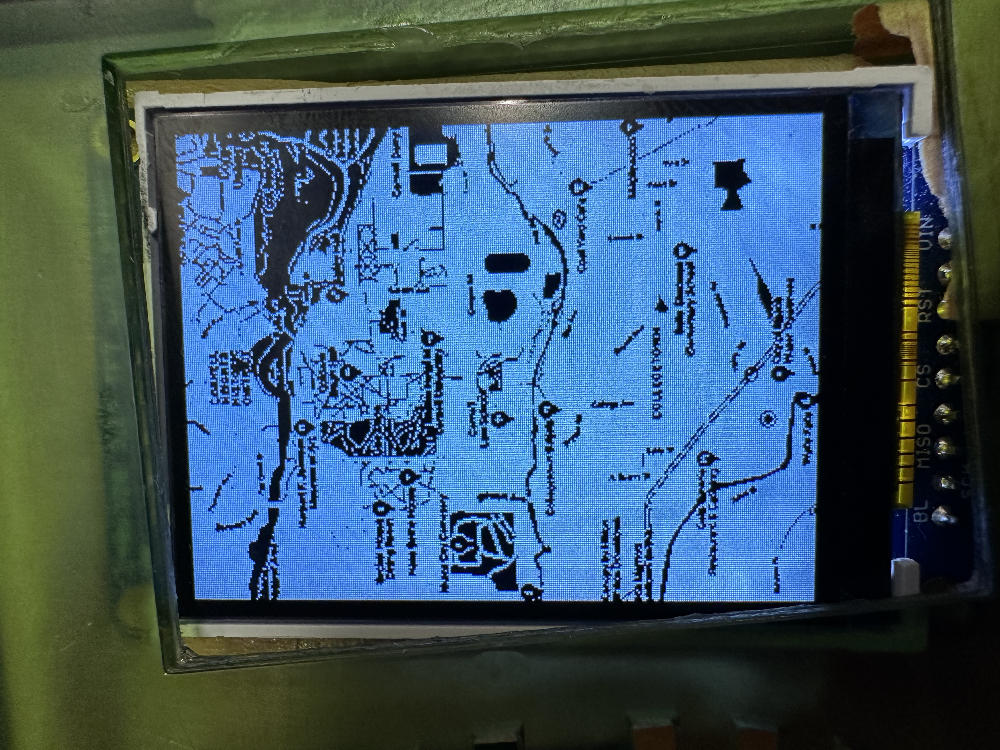

The map shows the Cornell campus as a background, and displays the user’s current location as a blue dot, as we don't remove the previous dot, the app shows the trace of the user has been since the app opened. With the offline projection calculation, we have a conversion function hardcoded. 
We screenshot a piece of the Cornell campus map from Google Maps, and we converted it to a byte array as we did for the logos. 

#### Map Thread
For the thread initialization, we draw the background using the stored Cornell campus bitmap. As for the rest of the thread, what it does is repeatedly poll the current latitude and longitude information from the GPS struct, and convert it to the corresponding pixel values on the screen, and draw it with a blue dot.

### Audio
To achieve the retro sounding music and forgo using a DAC, music and audio is generated using square wave output from a GIPO port configured for PWM. Music and audio were synthesized using interrupts, which were implemented using a repeating timer and a repeating timer callback function. Notes were decomposed into their frequencies which we played and manipulated by setting the PWM wrap by dividing the number of clock cycles per second by our desired frequency in hertz. Furthermore, volume was manipulated by varying the PWM channel level, or duty cycle. The note, or sound, would be changed after a certain number of interrupts where that number is determined by how long we want the sound to be played. With this implementation, we were able to construct songs using an array comprised of all the frequencies of the notes we wanted to play as well as a corresponding array of the desired duration of each of these notes. With this being the case, we were able to iterate through the array changing the note by resetting the wrap value and the duration by adjusting the number of interrupts before the next change.
 

## Results

Any and all test data, scope traces, waveforms, etc
speed of execution (hesitation, filcker, interactiveness, concurrency)
accuracy (numeric, music frequencies, video signal timing, etc)
how you enforced safety in the design.
usability by you and other people

We intended to make the applications in the system isolated and the execution of one of the applications should not halt the execution of the others. So the applications, including the menu are multithreaded and use their own set of variables. The such decoupled design makes adding applications or swapping between applications have less chance to freeze or conflict. And we designed each application to have a similar execution scene--initialization, and app logic that is being executed over and over again.

For button debouncing, we chose a debounce value of 200ms, and we did a test, that is printing out a message from the serial port to indicate a button is pressed. Without debouncing, it has a high chance of showing a button being pressed multiple times in a row while in the reality it was only one press. However, with the debounce algorithm, this issue is fully solved, as no matter how we press the button, there is only one message for one button press. And 200ms is more than enough for our applications.

When we designed the graphics implementation of the snake game, in order to prevent mass flickering each frame the snake moves, instead of removing the whole snake and redrawing the whole new position. We only remove the tail and redraw the new head, so there is no high-frequency removal and redraw, which prevents flickering. 

Also for the clock app, we utilized a built-in function for string drawing, that as we specify the background color, the screen buffers the background and updates the new string without flickering. 

However, for the music, as we didnt have enough room for a large OpAmp circiut we built during prototyping, we directly connected the speaker to the GPIO pin, which makes the sound quality not modern enough.

In general, PicoBoi is a very stale device, there is no flickering or performance issue that the user can notice, including the video signal and the music.

## Conclusion

Throughout the process of developing the PicoBoi, in some realms, we ultimately needed to shift our expectations. As with most projects under a time crunch, evolving expectations are necessary as it becomes apparent that some goals may be more, or less, achievable than initially thought. In addition, hardware technical difficulties resulted in setbacks, but overcoming these challenges, at least in retrospect, were some of the most interesting aspects of Picoboi's development. All this being said, the Picoboi was able to meet our expectations as it came complete with all of the features we had initially intended. 

Although we were generally pleased with the Picoboi we had constructed, that is not to say there aren’t optimizations to be made. One of the primary reasons this project was so interesting is that all of our design choices were in many ways a battle between form and function. In its development, we ultimately wanted to include as many features as possible to maximize user experience; however if those additions required adding hardware, then we would have to increase the size of the device in turn decreasing user experience. This required a lot of critical decisions to be made. For example, we did not include the amplifier circuit that we built because it was too large, but as a result we are limited in our audio volume and quality. Design choices like using a PCB rather than a solder board and buying an amplifier rather than building an amplifier circuit are just a few ways we can improve the PicoBoi and shift our device more in the handheld pocket friendly direction.

All of our code was built from the ground up which extends to code design and music. We did not utilize anything that is open source or in the public domain. Although choosing to go this route may have hindered us in the quantity of features we were able to offer, our final product is something that is unique and the experience of building all of its features was a great learning experience. Although the implementations may be unique, there is nothing specifically new or novel related to our project and as a result, there aren’t any apparent patent opportunities
From an ethical standpoint, our project doesn’t raise any red flags. Foregoing the dangers associated with any toy or handheld gaming device, The PicoBoi doesn’t appear to pose any significant risks to the user however there are probably steps that would need to be taken before it could meet industry standard if it were to go into production. Outside of some of the graphics that were used to indicate game modes and features on our GUI, we do not utilize anyone else’s intellectual property so there are no major legal considerations to be made.

Development of the PicoBoi was both a fun project and a great learning experience. In doing so we were able to continue to explore many of the topics covered in this class and delve into some of the features and capabilities of the RP2040.

## Appendix A: Permissions

#### The group approves this report for inclusion on the course website.

#### The group approves the video for inclusion on the course youtube channel.


## Appendix B: Code
```
# PicoBoi.c
#include <stdio.h>
#include <stdlib.h>
#include <math.h>
#include <string.h>

#include "pico/stdlib.h"
#include "pico/multicore.h"

#include "hardware/dma.h"
#include "hardware/irq.h"
#include "hardware/adc.h"
#include "hardware/pio.h"
#include "hardware/uart.h"
#include "hardware/pwm.h"
// Include custom libraries
#include "pt_cornell_rp2040_v1.h"
#include "TFT/TFTMaster.h"
//#include "Adafruit_GPS-1.7.1/src/Adafruit_GPS.h"
#include "menu.h"
#include "snake.h"
#include "GPS.h"
#include "music.h"

#define BUTTON_X_PIN 8
#define BUTTON_Y_PIN 9

#define BUTTON_A_PIN  10
#define BUTTON_B_PIN  11
#define BUTTON_C_PIN  12
#define BUTTON_D_PIN  13

//#define UART_ID uart1
#define BAUD_RATE 9600
#define DATA_BITS 8
#define STOP_BITS 1
#define PARITY UART_PARITY_NONE

//#define UART_TX_PIN 4
#define UART_RX_PIN 21
// ms
#define DEBOUNCE_CD 200
#define PRESS_SOUND_CD 100

int SNAKE_FRAME_CD = 200;

#define CLOCK_FRAME_CD 500
#define MAP_FRAME_CD 500

int CD_X = 0;
int CD_Y = 0;
int CD_A = 0;
int CD_B = 0;
int CD_C = 0;
int CD_D = 0;

int CD_SNAKE_FRAME=0;
int CD_CLOCK_FRAME=0;
int CD_PRESS_SOUND=0;
int CD_MAP_FRAME=0;
//-1:menu 0:app0 -2:app0 gameover 1:app1 2:app2 3:app3
int STATE =-1;
//init semphares

int menu_init = 1;
//SNAKE
int App_0_init = 1;
int App_0_over_init = 1;
//CLOCK
int App_1_init = 1;
//settings
int App_2_init = 1;
//map
int App_3_init = 1;

int currentSelectorN = 0;
int drawSelectorN = 0;

int currentSettingN = 0;
int drawSettingN = 0;

static snake mysnake;
static GPS myGPS;




// RX interrupt handler
void on_uart_rx()
{
    //int i_char=0;
    //clean watch_dog
    while (uart_is_readable(uart1))
    {
        
        uint8_t new_char = uart_getc(uart1);

        buffer_shift(&myGPS, new_char);

        if (check_GNRMC(&myGPS))
        {
            
           get_time(&myGPS);
           get_fix_status(&myGPS);
           if(myGPS.FIX){
               get_loc(&myGPS);
           }

        }



    }

}



bool repeating_timer_callback_core_0(struct repeating_timer *t){

    if (CD_SNAKE_FRAME> 0)
    {
        CD_SNAKE_FRAME--;
    }

    if (CD_CLOCK_FRAME > 0)
    {
        CD_CLOCK_FRAME--;
    }

    if(STATE!=0){
        if (CD_PRESS_SOUND > 0)
        {
            CD_PRESS_SOUND--;
        }else{
            pwm_set_chan_level(pwm_gpio_to_slice_num(2), PWM_CHAN_A, 0);
        }
    }

    if (CD_X > 0)
    {
        CD_X--;
    }
    if (CD_Y > 0)
    {
        CD_Y--;
    }
    if(CD_A>0){
        CD_A--;
    }
    if (CD_B > 0)
    {
        CD_B--;
    }
    if (CD_C > 0)
    {
        CD_C--;
    }
    if (CD_D > 0)
    {
        CD_D--;
    }

    if (STATE == 0)
    {
        volume=0.99;
        if (count < (1125 * dur))
        {
            count++;
        }
        else
        {
            count = 0;
            if (state == 0)
            {
                state = 1;
                dur = pause;
                vol = 0;
            }
            else
            {
                state = 0;
                dur = duration[ind];
                vol = 1000000 / (notes[ind] * (1 / volume));
            }
            uint slice_num = pwm_gpio_to_slice_num(2);

            pwm_set_wrap(slice_num, (1000000 / notes[ind]));
            pwm_set_chan_level(slice_num, PWM_CHAN_A, vol);
            if (state == 0)
            {
                if (ind == (arraylen - 1))
                {
                    ind = 0;
                }
                else
                {
                    ind++;
                }
            }
        }
        return true;
    }

    // if(new_c){
    //     for (int i = 0; i < 5; i++)
    //     {
    //         printf("%c", myGPS.watch_dog[i]);
    //     }
    //     printf("\n------------------------------------------------\n");

    //     new_c=0;
    // }

    


    //printf("currentSelectorN: %d, drawSelectorN: %d\n", currentSelectorN, drawSelectorN);
    //printf("currentSettingN: %d, drawSettingN: %d\n", currentSettingN, drawSettingN);
    //printf("STATE: %d , menu_init: %d, App0_init: %d, currentSelectorN: %d \n", STATE, menu_init, App_0_init, currentSelectorN);
    //printf("SNAKE_CD: %d , SNAKE_X: %d, SNAKE_Y: %d, DIR: %d \n", CD_SNAKE_FRAME, mysnake.x, mysnake.y, mysnake.direction);
}

static PT_THREAD(pt_drawslr(struct pt *pt))
{

    PT_BEGIN(pt);
    if(STATE == -1){

        if(menu_init){
            tft_fillScreen(ILI9340_BLACK);
            draw_menu();
            draw_Selector(0);
            currentSelectorN = 0;
            menu_init = 0;
        }

        if (drawSelectorN != currentSelectorN)
        {
            removeAllSelector();
            draw_Selector(drawSelectorN);
            currentSelectorN = drawSelectorN;
        }
    }
    PT_END(pt);
   
}

static PT_THREAD(pt_app0(struct pt *pt))
{

    PT_BEGIN(pt);
    if (STATE == 0)
    {
        if (App_0_init)
        {
            tft_fillScreen(ILI9340_BLACK);
            draw_boundary();
            spawn_snake(&mysnake);
            draw_snake(&mysnake);
            App_0_init = 0;
        }

        if(CD_SNAKE_FRAME==0){

            remove_snake(&mysnake);
            if (!update_snake(&mysnake)){
                //game over
                STATE=-2;
            }
            draw_snake(&mysnake);
            CD_SNAKE_FRAME=SNAKE_FRAME_CD;
            
        }
    }else if(STATE==-2){
        //game over
        if (App_0_over_init)
        {
            draw_gameover(&mysnake);
            App_0_over_init = 0;
        }
    }
    PT_END(pt);
}

static PT_THREAD(pt_app1(struct pt *pt))
{

    PT_BEGIN(pt);
    if (STATE == 1)
    {
        
        if (App_1_init)
        {
            tft_fillScreen(ILI9340_BLACK);
            draw_boundary();

            App_1_init = 0;
        }

        if (CD_CLOCK_FRAME == 0)
        {

            draw_time_fix(&myGPS);
            
            CD_CLOCK_FRAME = CLOCK_FRAME_CD;
        }
    }

    PT_END(pt);
}

static PT_THREAD(pt_app2(struct pt *pt))
{

    PT_BEGIN(pt);
    if (STATE == 2)
    {
        if (App_2_init)
        {
            tft_fillScreen(ILI9340_BLACK);
            draw_setting();
            draw_Selector(0);
            App_2_init = 0;
        }

        if (drawSettingN != currentSettingN)
        {
            removeAllSelector();
            draw_Selector(drawSettingN);
            currentSettingN = drawSettingN;
        }

        
    }

    PT_END(pt);
}

static PT_THREAD(pt_app3(struct pt *pt))
{

    PT_BEGIN(pt);
    if (STATE == 3)
    {

        if (App_3_init)
        {
            tft_fillScreen(ILI9340_BLACK);
            draw_map();
            App_3_init = 0;
        }

        if(myGPS.FIX){
            draw_me(&myGPS);
        }
        // if (CD_CLOCK_FRAME == 0)
        // {

        //     draw_time_fix(&myGPS);

        //     CD_CLOCK_FRAME = CLOCK_FRAME_CD;
        // }
    }

    PT_END(pt);
}

void button_cb(uint gpio, uint32_t events)
{
        //exit to menu
        if (CD_Y == 0 && gpio == BUTTON_Y_PIN)
        {
            CD_Y = DEBOUNCE_CD;
            printf("Button: Y Back to menu\n");
            menu_init = 1; 
            App_0_init = 1;
            App_0_over_init = 1;
            App_1_init = 1;
            App_2_init=1;
            App_3_init = 1;

            //turn off any music
            pwm_set_chan_level(pwm_gpio_to_slice_num(2), PWM_CHAN_A, 0);
            if(STATE!=0){
                // button press music
                pwm_set_wrap(pwm_gpio_to_slice_num(2), (1000000 / C4));
                pwm_set_chan_level(pwm_gpio_to_slice_num(2), PWM_CHAN_A, 1000000 / (C4 * (1 / 0.99)));
                CD_PRESS_SOUND = PRESS_SOUND_CD;
            }

            STATE = -1;
        }


        //app0 snake
        if(STATE==0){
            if (CD_A == 0 && gpio == BUTTON_A_PIN)
            {
                if(CD_C>0&&CD_C>CD_B){
                    //A+C 0+1
                    mysnake.direction = 4;
                }
                else if (CD_B>0)
                {
                    //A+B 0+3
                    mysnake.direction = 7;
                }else{
                    mysnake.direction = 0;
                }

                CD_A = DEBOUNCE_CD;
            }
            if (CD_B == 0 && gpio == BUTTON_B_PIN)
            {
                if (CD_A > 0 && CD_A > CD_D)
                {
                    //B+A 3+0
                    mysnake.direction = 7;
                }
                else if (CD_D > 0)
                {
                    //B+D 3+2
                    mysnake.direction = 6;
                }else{
                    mysnake.direction = 3;
                }

                CD_B = DEBOUNCE_CD;
            }
            if (CD_C == 0 && gpio == BUTTON_C_PIN)
            {
                if (CD_A > 0 && CD_A > CD_D)
                {
                    //C+A 1+0
                    mysnake.direction = 4;
                }
                else if (CD_D > 0)
                {
                    //C+D
                    mysnake.direction = 5;
                }
                else
                {
                    mysnake.direction = 1;
                }
                CD_C = DEBOUNCE_CD;
            }
            if (CD_D == 0 && gpio == BUTTON_D_PIN)
            {
                if (CD_B > 0 && CD_B > CD_C)
                {
                    //D+B 2+3
                    mysnake.direction = 6;
                }
                else if (CD_C > 0)
                {
                    //D+C
                    mysnake.direction = 5;
                }
                else
                {
                    mysnake.direction = 2;
                }
                CD_D = DEBOUNCE_CD;
            }
        }
        //menu
        if(STATE==-1){
            if (CD_X == 0 && gpio == BUTTON_X_PIN)
            {
                printf("Button: X, Selecting Block: %d \n", currentSelectorN);
                CD_X = DEBOUNCE_CD;
                if (currentSelectorN == 0)
                {
                    // SNAKE
                    STATE = 0;
                }
                if (currentSelectorN == 1)
                {
                    // CLOCK
                    STATE = 1;
                }
                if (currentSelectorN == 2)
                {
                    // SETTING
                    STATE = 2;
                }
                if (currentSelectorN == 3)
                {
                    // MAP
                    STATE = 3;
                }
                if (STATE != 0)
                {
                    // button press music
                    pwm_set_wrap(pwm_gpio_to_slice_num(2), (1000000 / C4));
                    pwm_set_chan_level(pwm_gpio_to_slice_num(2), PWM_CHAN_A, 1000000 / (C4 * (1 / 0.99)));
                    CD_PRESS_SOUND = PRESS_SOUND_CD;
                }
            }
            if (CD_A == 0 && gpio == BUTTON_A_PIN)
            {
                printf("Button: A\n");
                if(currentSelectorN==2){
                    drawSelectorN = 0;
                }
                if (currentSelectorN == 3)
                {
                    drawSelectorN = 1;
                }
                if (STATE != 0)
                {
                    // button press music
                    pwm_set_wrap(pwm_gpio_to_slice_num(2), (1000000 / C4));
                    pwm_set_chan_level(pwm_gpio_to_slice_num(2), PWM_CHAN_A, 1000000 / (C4 * (1 / 0.99)));
                    CD_PRESS_SOUND = PRESS_SOUND_CD;
                }
                CD_A = DEBOUNCE_CD;
            }
            if (CD_B == 0 && gpio == BUTTON_B_PIN)
            {
                printf("Button: B\n");
                if (currentSelectorN == 1)
                {
                    drawSelectorN = 0;
                }
                if (currentSelectorN == 3)
                {
                    drawSelectorN = 2;
                }
                if (STATE != 0)
                {
                    // button press music
                    pwm_set_wrap(pwm_gpio_to_slice_num(2), (1000000 / C4));
                    pwm_set_chan_level(pwm_gpio_to_slice_num(2), PWM_CHAN_A, 1000000 / (C4 * (1 / 0.99)));
                    CD_PRESS_SOUND = PRESS_SOUND_CD;
                }
                CD_B = DEBOUNCE_CD;
            }
            if (CD_C == 0 && gpio == BUTTON_C_PIN)
            {
                printf("Button: C\n");
                if (currentSelectorN == 0)
                {
                    drawSelectorN = 1;
                }
                if (currentSelectorN == 2)
                {
                    drawSelectorN = 3;
                }
                if (STATE != 0)
                {
                    // button press music
                    pwm_set_wrap(pwm_gpio_to_slice_num(2), (1000000 / C4));
                    pwm_set_chan_level(pwm_gpio_to_slice_num(2), PWM_CHAN_A, 1000000 / (C4 * (1 / 0.99)));
                    CD_PRESS_SOUND = PRESS_SOUND_CD;
                }
                CD_C = DEBOUNCE_CD;
            }
            if (CD_D == 0 && gpio == BUTTON_D_PIN)
            {
                printf("Button: D\n");
                if (currentSelectorN == 0)
                {
                    drawSelectorN = 2;
                }
                if (currentSelectorN == 1)
                {
                    drawSelectorN = 3;
                }
                if (STATE != 0)
                {
                    // button press music
                    pwm_set_wrap(pwm_gpio_to_slice_num(2), (1000000 / C4));
                    pwm_set_chan_level(pwm_gpio_to_slice_num(2), PWM_CHAN_A, 1000000 / (C4 * (1 / 0.99)));
                    CD_PRESS_SOUND = PRESS_SOUND_CD;
                }
                CD_D = DEBOUNCE_CD;
            }
        }
        //settings
        if (STATE == 2)
        {
            printf("currentSettingN: %d, drawSettingN: %d\n", currentSettingN, drawSettingN);
            if (CD_X == 0 && gpio == BUTTON_X_PIN)
            {
                CD_X = DEBOUNCE_CD;
                if (currentSettingN == 0)
                {
                    // SNAKE
                    printf("ez mode\n");
                    SNAKE_FRAME_CD=500;

                }
                if (currentSettingN == 1)
                {
                    // SNAKE
                    SNAKE_FRAME_CD = 300;

                }
                if (currentSettingN == 2)
                {
                    // SETTING
                    SNAKE_FRAME_CD = 200;
                }
                if (currentSettingN == 3)
                {
                    // SETTING
                    SNAKE_FRAME_CD = 100;
                }
                if (STATE != 0)
                {
                    // button press music
                    pwm_set_wrap(pwm_gpio_to_slice_num(2), (1000000 / C4));
                    pwm_set_chan_level(pwm_gpio_to_slice_num(2), PWM_CHAN_A, 1000000 / (C4 * (1 / 0.99)));
                    CD_PRESS_SOUND = PRESS_SOUND_CD;
                }
            }
            if (CD_A == 0 && gpio == BUTTON_A_PIN)
            {
                printf("Button: A\n");
                if (currentSettingN == 2)
                {
                    drawSettingN = 0;
                }
                if (currentSettingN == 3)
                {
                    drawSettingN = 1;
                }
                if (STATE != 0)
                {
                    // button press music
                    pwm_set_wrap(pwm_gpio_to_slice_num(2), (1000000 / C4));
                    pwm_set_chan_level(pwm_gpio_to_slice_num(2), PWM_CHAN_A, 1000000 / (C4 * (1 / 0.99)));
                    CD_PRESS_SOUND = PRESS_SOUND_CD;
                }
                CD_A = DEBOUNCE_CD;
            }
            if (CD_B == 0 && gpio == BUTTON_B_PIN)
            {
                printf("Button: B\n");
                if (currentSettingN == 1)
                {
                    drawSettingN = 0;
                }
                if (currentSettingN == 3)
                {
                    drawSettingN = 2;
                }
                if (STATE != 0)
                {
                    // button press music
                    pwm_set_wrap(pwm_gpio_to_slice_num(2), (1000000 / C4));
                    pwm_set_chan_level(pwm_gpio_to_slice_num(2), PWM_CHAN_A, 1000000 / (C4 * (1 / 0.99)));
                    CD_PRESS_SOUND = PRESS_SOUND_CD;
                }
                CD_B = DEBOUNCE_CD;
            }
            if (CD_C == 0 && gpio == BUTTON_C_PIN)
            {
                printf("Button: C\n");
                if (currentSettingN == 0)
                {
                    drawSettingN = 1;
                }
                if (currentSettingN == 2)
                {
                    drawSettingN = 3;
                }
                if (STATE != 0)
                {
                    // button press music
                    pwm_set_wrap(pwm_gpio_to_slice_num(2), (1000000 / C4));
                    pwm_set_chan_level(pwm_gpio_to_slice_num(2), PWM_CHAN_A, 1000000 / (C4 * (1 / 0.99)));
                    CD_PRESS_SOUND = PRESS_SOUND_CD;
                }
                CD_C = DEBOUNCE_CD;
            }
            if (CD_D == 0 && gpio == BUTTON_D_PIN)
            {
                printf("Button: D\n");
                if (currentSettingN == 0)
                {
                    drawSettingN = 2;
                }
                if (currentSettingN == 1)
                {
                    drawSettingN = 3;
                }
                if (STATE != 0)
                {
                    // button press music
                    pwm_set_wrap(pwm_gpio_to_slice_num(2), (1000000 / C4));
                    pwm_set_chan_level(pwm_gpio_to_slice_num(2), PWM_CHAN_A, 1000000 / (C4 * (1 / 0.99)));
                    CD_PRESS_SOUND = PRESS_SOUND_CD;
                }
                CD_D = DEBOUNCE_CD;
            }
        }

}

int main() {


    stdio_init_all();

    /////MUSIC///
    gpio_set_function(2, GPIO_FUNC_PWM);

    uint slice_num = pwm_gpio_to_slice_num(2);

    pwm_set_clkdiv(slice_num, CLKDIV);

    pwm_set_wrap(slice_num, 1000000 / 261.6);

    pwm_set_chan_level(slice_num, PWM_CHAN_A, 0);

    pwm_set_enabled(slice_num, true);

    //////////// UART////////////
    uart_init(uart1, 2400);

    //gpio_set_function(UART_TX_PIN, GPIO_FUNC_UART);
    gpio_set_function(UART_RX_PIN, GPIO_FUNC_UART);

    int __unused actual = uart_set_baudrate(uart1, BAUD_RATE);
    uart_set_hw_flow(uart1, false, false);
    uart_set_format(uart1, DATA_BITS, STOP_BITS, PARITY);


    irq_set_exclusive_handler(UART1_IRQ, on_uart_rx);
    irq_set_enabled(UART1_IRQ, true);
    uart_set_irq_enables(uart1, true, false);
    ////////////////////////////

    tft_init_hw();
    tft_begin();

    gpio_init(BUTTON_X_PIN);
    gpio_set_dir(BUTTON_X_PIN, GPIO_IN);

    gpio_init(BUTTON_Y_PIN);
    gpio_set_dir(BUTTON_Y_PIN, GPIO_IN);

    gpio_init(BUTTON_A_PIN);
    gpio_set_dir(BUTTON_A_PIN, GPIO_IN);

    gpio_init(BUTTON_B_PIN);
    gpio_set_dir(BUTTON_B_PIN, GPIO_IN);

    gpio_init(BUTTON_C_PIN);
    gpio_set_dir(BUTTON_C_PIN, GPIO_IN);

    gpio_init(BUTTON_D_PIN);
    gpio_set_dir(BUTTON_D_PIN, GPIO_IN);

    gpio_set_irq_enabled_with_callback(BUTTON_X_PIN, GPIO_IRQ_EDGE_RISE, true, &button_cb);
    gpio_set_irq_enabled_with_callback(BUTTON_Y_PIN, GPIO_IRQ_EDGE_RISE, true, &button_cb);
    gpio_set_irq_enabled_with_callback(BUTTON_A_PIN, GPIO_IRQ_EDGE_RISE, true, &button_cb);
    gpio_set_irq_enabled_with_callback(BUTTON_B_PIN, GPIO_IRQ_EDGE_RISE, true, &button_cb);
    gpio_set_irq_enabled_with_callback(BUTTON_C_PIN, GPIO_IRQ_EDGE_RISE, true, &button_cb);
    gpio_set_irq_enabled_with_callback(BUTTON_D_PIN, GPIO_IRQ_EDGE_RISE, true, &button_cb);


    struct repeating_timer timer_core_0;
    add_repeating_timer_ms(-1,
                           repeating_timer_callback_core_0, NULL, &timer_core_0);
    pt_add_thread(pt_drawslr);
    pt_add_thread(pt_app0);
    pt_add_thread(pt_app1);
    pt_add_thread(pt_app2);
    pt_add_thread(pt_app3);
    pt_schedule_start;

}

```

```
// menu.h

void draw_menu(void);
void draw_setting(void); 
void draw_Selector(int blockN);
void removeAllSelector();
void draw_map(void); 
struct menuSelect;

static const unsigned char snake_logo[] = {
    // 'snake_logo', 110x150px
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0x83, 0xf8, 0xf8, 0xfe, 0x1f, 0xe3, 0xe1, 0xc0, 0x07, 0xf8, 0xff, 0xfc,
    0xff, 0xfe, 0x00, 0xf0, 0x78, 0xfc, 0x0f, 0xc3, 0xc3, 0xc0, 0x07, 0xf0, 0xff, 0xfc, 0xff, 0xfc,
    0x00, 0xf0, 0x78, 0xfc, 0x0f, 0xc3, 0xc3, 0xc0, 0x07, 0xf0, 0xff, 0xfc, 0xff, 0xf8, 0x70, 0xf0,
    0x78, 0xfc, 0x0f, 0xc3, 0x87, 0x87, 0xff, 0xf0, 0xff, 0xfc, 0xff, 0xf8, 0xf8, 0x70, 0x70, 0xf8,
    0x0f, 0xc7, 0x0f, 0x87, 0xff, 0xf1, 0xff, 0xfc, 0xff, 0xf8, 0xff, 0xf0, 0x71, 0xf8, 0x8f, 0xc7,
    0x0f, 0x87, 0xff, 0xf1, 0xff, 0xfc, 0xff, 0xf0, 0xff, 0xe2, 0x31, 0xf0, 0x8f, 0xc6, 0x1f, 0x8f,
    0xff, 0xf1, 0xff, 0xfc, 0xff, 0xf8, 0x3f, 0xe2, 0x31, 0xf1, 0x8f, 0x80, 0x1f, 0x87, 0xff, 0xf1,
    0xff, 0xfc, 0xff, 0xf8, 0x07, 0xe2, 0x31, 0xf1, 0x8f, 0x80, 0x3f, 0x80, 0x1f, 0xe1, 0xff, 0xfc,
    0xff, 0xfc, 0x03, 0xe3, 0x31, 0xe1, 0x8f, 0x80, 0x3f, 0x00, 0x1f, 0xe3, 0xff, 0xfc, 0xff, 0xff,
    0x01, 0xe3, 0x31, 0xe3, 0x8f, 0x80, 0x3f, 0x00, 0x3f, 0xe3, 0xff, 0xfc, 0xff, 0xff, 0xe1, 0xe3,
    0x13, 0xc0, 0x07, 0x8e, 0x3f, 0x0f, 0xff, 0xe3, 0xff, 0xfc, 0xff, 0xff, 0xf1, 0xc3, 0x03, 0xc0,
    0x07, 0x8e, 0x1f, 0x1f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf1, 0xc7, 0x03, 0xc0, 0x07, 0x0e,
    0x1f, 0x1f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xe1, 0xe1, 0xc7, 0x03, 0x87, 0x87, 0x0e, 0x1f, 0x1f,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xe0, 0xc1, 0xc7, 0x83, 0x8f, 0xc7, 0x0f, 0x1e, 0x00, 0x3f, 0xc7,
    0xff, 0xfc, 0xff, 0xe0, 0x03, 0xc7, 0x83, 0x0f, 0xc7, 0x1f, 0x0e, 0x00, 0x3f, 0xc3, 0xff, 0xfc,
    0xff, 0xf0, 0x07, 0xc7, 0x87, 0x0f, 0xc7, 0x1f, 0x0e, 0x00, 0x3f, 0xc7, 0xff, 0xfc, 0xff, 0xfe,
    0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x0f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xe0, 0x00, 0x00, 0x00, 0x0f, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0x00, 0x00, 0x00, 0x00, 0x03, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x00,
    0x00, 0x00, 0x00, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x00, 0xf0, 0x00, 0x00,
    0x00, 0x3f, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x01, 0xf8, 0x00, 0x00, 0x00, 0x1f,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x01, 0xf8, 0x00, 0x00, 0x00, 0x0f, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xc0, 0x01, 0xf8, 0x00, 0x00, 0x00, 0x07, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xc0, 0x01, 0xf8, 0x00, 0x00, 0x00, 0x03, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xe0, 0x00, 0xf0, 0x00, 0x00, 0x00, 0x01, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xe0,
    0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xf8, 0x3f, 0xe0, 0x00, 0x00,
    0x00, 0x00, 0x00, 0x00, 0x7f, 0xfc, 0xff, 0xff, 0xff, 0xf8, 0x07, 0xe0, 0x00, 0x00, 0x00, 0x00,
    0x00, 0x00, 0x3f, 0xfc, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00,
    0x3f, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x1f, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0x80, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x1f, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xc0, 0x00, 0x00, 0x00, 0x03, 0xc0, 0x00, 0x00, 0x0f, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xc0, 0x01, 0x00, 0x00, 0x3f, 0xfc, 0x00, 0x00, 0x0f, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x00, 0x07,
    0xc0, 0x07, 0xff, 0xff, 0x00, 0x00, 0x07, 0xfc, 0xff, 0xff, 0xff, 0xfe, 0x03, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xc0, 0x00, 0x07, 0xfc, 0xff, 0xff, 0xff, 0xfc, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xe0, 0x00, 0x07, 0xfc, 0xff, 0xff, 0xff, 0xfc, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x00,
    0x07, 0xfc, 0xff, 0xff, 0xff, 0xfe, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x00, 0x03, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xf8, 0x00, 0x03, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00,
    0x03, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x1f, 0xff, 0xff,
    0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x80, 0x07, 0xff, 0xff, 0xff, 0xff,
    0xf8, 0x00, 0x03, 0xfc, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x07, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00,
    0x03, 0xfc, 0xff, 0xff, 0xff, 0xf0, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc,
    0xff, 0xff, 0xff, 0xc0, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xff,
    0xff, 0x80, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xff, 0xfe, 0x00,
    0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xff, 0xfc, 0x00, 0x7f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xff, 0xf8, 0x00, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xff, 0xe0, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xf8, 0x00, 0x03, 0xfc, 0xff, 0xff, 0xc0, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00,
    0x03, 0xfc, 0xff, 0xff, 0x80, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc,
    0xff, 0xff, 0x00, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xff,
    0x00, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xfe, 0x00, 0x0f,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xfc, 0x00, 0x0f, 0xff, 0xff,
    0xc0, 0x0f, 0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xf8, 0x00, 0x1f, 0xff, 0xfe, 0x00, 0x00,
    0xff, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xf8, 0x00, 0x1f, 0xff, 0xf8, 0x00, 0x00, 0x3f, 0xff,
    0xf8, 0x00, 0x03, 0xfc, 0xff, 0xf0, 0x00, 0x1f, 0xff, 0xe0, 0x00, 0x00, 0x1f, 0xff, 0xf8, 0x00,
    0x03, 0xfc, 0xff, 0xf0, 0x00, 0x3f, 0xff, 0xc0, 0x00, 0x00, 0x07, 0xff, 0xf8, 0x00, 0x03, 0xfc,
    0xff, 0xe0, 0x00, 0x3f, 0xff, 0x80, 0x00, 0x00, 0x03, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xe0,
    0x00, 0x3f, 0xfe, 0x00, 0x00, 0x00, 0x01, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xc0, 0x00, 0x3f,
    0xfe, 0x00, 0x00, 0x00, 0x00, 0xff, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xc0, 0x00, 0x3f, 0xfc, 0x00,
    0x00, 0x00, 0x00, 0x7f, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xc0, 0x00, 0x3f, 0xf8, 0x00, 0x00, 0x00,
    0x00, 0x7f, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0xc0, 0x00, 0x7f, 0xf8, 0x00, 0x00, 0x00, 0x00, 0x3f,
    0xf8, 0x00, 0x03, 0xfc, 0xff, 0x80, 0x00, 0x7f, 0xf0, 0x00, 0x00, 0x00, 0x00, 0x3f, 0xf8, 0x00,
    0x03, 0xfc, 0xff, 0x80, 0x00, 0x7f, 0xf0, 0x00, 0x00, 0x00, 0x00, 0x1f, 0xf8, 0x00, 0x03, 0xfc,
    0xff, 0x80, 0x00, 0x7f, 0xe0, 0x00, 0x00, 0x00, 0x00, 0x1f, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0x80,
    0x00, 0x7f, 0xe0, 0x00, 0x00, 0x00, 0x00, 0x1f, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0x80, 0x00, 0x7f,
    0xe0, 0x00, 0x00, 0x00, 0x00, 0x0f, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0x80, 0x00, 0x7f, 0xc0, 0x00,
    0x00, 0x00, 0x00, 0x0f, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0x00, 0x00, 0x7f, 0xc0, 0x00, 0x07, 0xc0,
    0x00, 0x0f, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0x00, 0x00, 0x7f, 0xc0, 0x00, 0x0f, 0xe0, 0x00, 0x0f,
    0xf8, 0x00, 0x03, 0xfc, 0xff, 0x00, 0x00, 0x7f, 0xc0, 0x00, 0x1f, 0xe0, 0x00, 0x0f, 0xf8, 0x00,
    0x03, 0xfc, 0xff, 0x00, 0x00, 0x7f, 0xc0, 0x00, 0x1f, 0xf0, 0x00, 0x0f, 0xf8, 0x00, 0x03, 0xfc,
    0xff, 0x00, 0x00, 0x7f, 0xc0, 0x00, 0x1f, 0xf0, 0x00, 0x0f, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0x00,
    0x00, 0x3f, 0xc0, 0x00, 0x1f, 0xf0, 0x00, 0x07, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0x00, 0x00, 0x3f,
    0xc0, 0x00, 0x1f, 0xf0, 0x00, 0x07, 0xf8, 0x00, 0x03, 0xfc, 0xff, 0x00, 0x00, 0x1f, 0x80, 0x00,
    0x1f, 0xf0, 0x00, 0x07, 0xf0, 0x00, 0x03, 0xfc, 0xff, 0x00, 0x00, 0x0f, 0x00, 0x00, 0x3f, 0xf0,
    0x00, 0x01, 0xe0, 0x00, 0x03, 0xfc, 0xff, 0x80, 0x00, 0x00, 0x00, 0x00, 0x3f, 0xf0, 0x00, 0x00,
    0x00, 0x00, 0x03, 0xfc, 0xff, 0x80, 0x00, 0x00, 0x00, 0x00, 0x3f, 0xf0, 0x00, 0x00, 0x00, 0x00,
    0x07, 0xfc, 0xff, 0x80, 0x00, 0x00, 0x00, 0x00, 0x3f, 0xf8, 0x00, 0x00, 0x00, 0x00, 0x07, 0xfc,
    0xff, 0xc0, 0x00, 0x00, 0x00, 0x00, 0x7f, 0xf8, 0x00, 0x00, 0x00, 0x00, 0x07, 0xfc, 0xff, 0xc0,
    0x00, 0x00, 0x00, 0x00, 0x7f, 0xf8, 0x00, 0x00, 0x00, 0x00, 0x0f, 0xfc, 0xff, 0xc0, 0x00, 0x00,
    0x00, 0x00, 0x7f, 0xfc, 0x00, 0x00, 0x00, 0x00, 0x0f, 0xfc, 0xff, 0xe0, 0x00, 0x00, 0x00, 0x00,
    0xff, 0xfc, 0x00, 0x00, 0x00, 0x00, 0x1f, 0xfc, 0xff, 0xe0, 0x00, 0x00, 0x00, 0x01, 0xff, 0xfe,
    0x00, 0x00, 0x00, 0x00, 0x1f, 0xfc, 0xff, 0xf0, 0x00, 0x00, 0x00, 0x01, 0xff, 0xff, 0x00, 0x00,
    0x00, 0x00, 0x3f, 0xfc, 0xff, 0xf8, 0x00, 0x00, 0x00, 0x03, 0xff, 0xff, 0x80, 0x00, 0x00, 0x00,
    0x7f, 0xfc, 0xff, 0xfc, 0x00, 0x00, 0x00, 0x07, 0xff, 0xff, 0x80, 0x00, 0x00, 0x00, 0xff, 0xfc,
    0xff, 0xfe, 0x00, 0x00, 0x00, 0x0f, 0xff, 0xff, 0xc0, 0x00, 0x00, 0x01, 0xff, 0xfc, 0xff, 0xff,
    0x00, 0x00, 0x00, 0x1f, 0xff, 0xff, 0xf0, 0x00, 0x00, 0x03, 0xff, 0xfc, 0xff, 0xff, 0x80, 0x00,
    0x00, 0x3f, 0xff, 0xff, 0xf8, 0x00, 0x00, 0x07, 0xff, 0xfc, 0xff, 0xff, 0xe0, 0x00, 0x00, 0xff,
    0xff, 0xff, 0xfe, 0x00, 0x00, 0x1f, 0xff, 0xfc, 0xff, 0xff, 0xf8, 0x00, 0x03, 0xff, 0xff, 0xff,
    0xff, 0x80, 0x00, 0x7f, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x80, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xf0,
    0x03, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc

};

static const unsigned char sat_clk_logo[] = {
    // 'sat logo', 110x150px
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x3f, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xf3, 0x87, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xe3, 0xc3, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xc3, 0x80, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xc1, 0x98, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x80, 0x1e,
    0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x9c, 0x3c, 0x07, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x1e, 0x0c, 0xc3, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfe, 0x0c, 0x00, 0xe0, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xfe, 0x00, 0xe1, 0xf0, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xfc, 0xe0, 0xf0, 0xe6, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xf8, 0xf0, 0x60, 0x07, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xf8,
    0xf0, 0x06, 0x0f, 0x83, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xf8, 0x67, 0x07,
    0x87, 0x21, 0xe4, 0x7f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfe, 0x07, 0x87, 0x00, 0x38,
    0x40, 0x3f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x07, 0x81, 0x30, 0x7c, 0xc0, 0x0f,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xc3, 0x10, 0x78, 0x78, 0x80, 0x03, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x3c, 0x38, 0x11, 0x00, 0x01, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xf8, 0x7c, 0x19, 0x03, 0x00, 0x00, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xfc, 0x38, 0x81, 0xc2, 0x00, 0x01, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0x01, 0xc3, 0xc4, 0x00, 0x01, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc3,
    0xe0, 0xcc, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe1, 0xc4, 0x08,
    0x00, 0x00, 0x7f, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x0e, 0x18, 0x00, 0x00,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x1f, 0x30, 0x00, 0x00, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x0e, 0x20, 0x00, 0x01, 0x3f, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x84, 0x60, 0x00, 0x03, 0x0f, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xe0, 0xc0, 0x00, 0x02, 0x07, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xf0, 0x80, 0x00, 0x04, 0x61, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xfd, 0x80, 0x00, 0x0c, 0xf0, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x00,
    0x00, 0x08, 0xf0, 0x3f, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x00, 0x18,
    0x72, 0x1f, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x00, 0x30, 0x23, 0x87,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x00, 0x23, 0x07, 0x83, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x00, 0x67, 0x87, 0x90, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfe, 0x01, 0xc0, 0x00, 0xc3, 0x81, 0x1c, 0x3f, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xf8, 0x00, 0x30, 0x00, 0x81, 0x18, 0x3c, 0x1f, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe,
    0x00, 0x0c, 0x01, 0x98, 0x3c, 0x3c, 0x07, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe1, 0xc0, 0x02,
    0x03, 0x1c, 0x3c, 0x08, 0xc3, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x60, 0x01, 0x82, 0x3c,
    0x08, 0x81, 0xe0, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x18, 0x00, 0xc6, 0x1c, 0xc1, 0xe1,
    0xe0, 0x7c, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x06, 0x00, 0x47, 0x80, 0xe1, 0xe0, 0xc6, 0x1c,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x03, 0x00, 0x2f, 0xc1, 0xe0, 0x44, 0x0f, 0x1c, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0x01, 0xc0, 0x1f, 0xf0, 0xe4, 0x0e, 0x0f, 0x3c, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xc1, 0xf0, 0x1f, 0xf8, 0x47, 0x0f, 0x06, 0x3c, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xe1, 0xd8, 0x0f, 0xfe, 0x0f, 0x07, 0x20, 0x7c, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf3, 0x84,
    0x0f, 0xff, 0x0f, 0x00, 0x70, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x03, 0x0f, 0xff,
    0xc2, 0x30, 0x78, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf1, 0x01, 0x87, 0xff, 0xe0, 0x7c,
    0x39, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf1, 0x80, 0xc7, 0xff, 0xf8, 0x78, 0x03, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe1, 0xe0, 0x27, 0xff, 0xfe, 0x11, 0x83, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xe3, 0xf8, 0x17, 0xff, 0xff, 0x03, 0xc7, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xf1, 0xe3, 0xfe, 0x0f, 0xff, 0xff, 0xc3, 0xc7, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf1,
    0xff, 0xff, 0x87, 0xff, 0xff, 0xe1, 0x8f, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0x31, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xf8, 0x1f, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0x38, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0x1f, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0x18, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff,
    0x3f, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xf3, 0x1c, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xf1, 0x8e, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xf1, 0x87, 0x81, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xf1, 0xc3, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xf8, 0xe0,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x70, 0x01, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x3c, 0x01, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x1f, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0x83, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xc0, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xf0, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe,
    0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x87, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xe0, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0x00, 0x00, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xfc, 0x00, 0x00, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xf0, 0x00, 0x00, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe0, 0x00,
    0x00, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0x80, 0x00, 0x00, 0x00,
    0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0x00, 0x00, 0x00, 0x00, 0x03, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xfe, 0x00, 0x00, 0x00, 0x00, 0x01, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xfc, 0x00, 0x00, 0x00, 0x00, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xf8, 0x00, 0x00, 0x00, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xf0, 0x00, 0x00, 0xfc, 0x00, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xf0,
    0x00, 0x0f, 0xff, 0xc0, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xe0, 0x00, 0x38,
    0x00, 0x70, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xc0, 0x00, 0x63, 0xff, 0x18,
    0x00, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xc0, 0x01, 0x9f, 0xcf, 0xe6, 0x00, 0x0f,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0x80, 0x03, 0x3f, 0xcf, 0xf3, 0x00, 0x07, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0x80, 0x06, 0xff, 0xcf, 0xfd, 0x80, 0x07, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0x00, 0x04, 0xff, 0xff, 0xfc, 0x80, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0x00, 0x09, 0x3f, 0xff, 0xf2, 0x40, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0x00,
    0x1b, 0xff, 0xcf, 0xff, 0x60, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xfe, 0x00, 0x17, 0xff,
    0xcf, 0xff, 0xa0, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xfe, 0x00, 0x37, 0xff, 0xcf, 0xff,
    0xb0, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xfe, 0x00, 0x2f, 0xff, 0xcf, 0xff, 0xd0, 0x01,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xfe, 0x00, 0x2f, 0xff, 0xcf, 0xff, 0xd0, 0x01, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xfe, 0x00, 0x6f, 0xff, 0xcf, 0xff, 0xd8, 0x01, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xfc, 0x00, 0x4f, 0xff, 0xcf, 0xff, 0xc8, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xfc, 0x00, 0x5f, 0xff, 0xcf, 0xff, 0xe8, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xfc, 0x00,
    0x5f, 0xff, 0xcf, 0xff, 0xe8, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xfc, 0x00, 0x50, 0xff,
    0xe0, 0x3c, 0x28, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xfc, 0x00, 0x5f, 0xff, 0xff, 0xff,
    0xe8, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xfc, 0x00, 0x5f, 0xff, 0xff, 0xff, 0xc8, 0x00,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xfe, 0x00, 0x6f, 0xff, 0xff, 0xff, 0xd8, 0x01, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xfe, 0x00, 0x6f, 0xff, 0xff, 0xff, 0xd0, 0x01, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xfe, 0x00, 0x2f, 0xff, 0xff, 0xff, 0xd0, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xfe, 0x00, 0x27, 0xff, 0xff, 0xff, 0x90, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xfe, 0x00,
    0x17, 0xff, 0xff, 0xff, 0xa0, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xfe, 0x00, 0x13, 0xff,
    0xff, 0xff, 0x20, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0x00, 0x0b, 0xbf, 0xff, 0xf7,
    0x40, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0x00, 0x0d, 0x3f, 0xff, 0xf2, 0xc0, 0x03,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0x80, 0x06, 0xff, 0xff, 0xfd, 0x80, 0x07, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0x80, 0x03, 0x7f, 0xcf, 0xfb, 0x00, 0x07, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xc0, 0x01, 0x9f, 0xcf, 0xe6, 0x00, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xc0, 0x00, 0xcf, 0xcf, 0x8c, 0x00, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xe0,
    0x00, 0x70, 0xfc, 0x30, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xe0, 0x00, 0x1e,
    0x01, 0xe0, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xf0, 0x00, 0x03, 0xff, 0x00,
    0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xf8, 0x00, 0x00, 0x00, 0x00, 0x00, 0x7f,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xfc, 0x00, 0x00, 0x00, 0x00, 0x00, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xfe, 0x00, 0x00, 0x00, 0x00, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0x00, 0x00, 0x00, 0x00, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0x80, 0x00, 0x00, 0x00, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xc0, 0x00, 0x00, 0x00, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf0, 0x00,
    0x00, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf8, 0x00, 0x00, 0x00,
    0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfe, 0x00, 0x00, 0x01, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc0, 0x00, 0x0f, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfc, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc
    };

static const unsigned char settings_logo[] = {
    // 'settings', 110x150px
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xc1,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0x80, 0xff, 0xff,
    0xe3, 0xfe, 0x3f, 0xf8, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0x00, 0x7f, 0xff, 0xe3, 0xfe,
    0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xfe, 0x3c, 0x7f, 0xff, 0xe7, 0xfe, 0x3f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xfe, 0x3f, 0xfc, 0x1e, 0x00, 0x30, 0x03, 0xc0, 0xfc, 0xc7,
    0xf0, 0x9f, 0x03, 0xfc, 0xfe, 0x3f, 0xf0, 0x0e, 0x00, 0x70, 0x03, 0xc0, 0xf8, 0x03, 0xc0, 0x1e,
    0x01, 0xfc, 0xfe, 0x0f, 0xf3, 0x8e, 0x00, 0x70, 0x07, 0xc1, 0xf8, 0x61, 0xc6, 0x1c, 0x78, 0xfc,
    0xff, 0x03, 0xe3, 0xc7, 0xc7, 0xfc, 0x7f, 0xf9, 0xf8, 0xf1, 0xcf, 0x1c, 0x7f, 0xfc, 0xff, 0x81,
    0xe3, 0xc7, 0xc7, 0xfc, 0x7f, 0xf1, 0xf8, 0xf3, 0x8f, 0x1c, 0x3f, 0xfc, 0xff, 0xf0, 0xe0, 0x0f,
    0xcf, 0xfc, 0x7f, 0xf1, 0xf8, 0xe3, 0x8f, 0x1e, 0x03, 0xfc, 0xff, 0xf8, 0xe7, 0xff, 0xcf, 0xfc,
    0x7f, 0xf1, 0xf9, 0xe3, 0x8f, 0x1f, 0xc1, 0xfc, 0xfc, 0xf8, 0xc7, 0xff, 0x8f, 0xfc, 0x7f, 0xf1,
    0xf1, 0xe3, 0x8e, 0x3f, 0xf1, 0xfc, 0xfc, 0x71, 0xc7, 0x9f, 0x8f, 0xfc, 0x7f, 0xf1, 0xf1, 0xe3,
    0x80, 0x38, 0xf1, 0xfc, 0xfc, 0x01, 0xe0, 0x1f, 0x80, 0xfc, 0x0f, 0x00, 0x31, 0xe3, 0xc0, 0x38,
    0x01, 0xfc, 0xfe, 0x03, 0xe0, 0x3f, 0xc0, 0xfc, 0x0f, 0x00, 0x71, 0xe7, 0xe6, 0x3c, 0x03, 0xfc,
    0xff, 0x9f, 0xf8, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x3f, 0x1f, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x7f, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc0, 0x7f, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xc1, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xfc, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xe0, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc0,
    0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc0, 0x01, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc0, 0x01, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc0, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc0, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xf0, 0xff, 0x80, 0x00, 0x7f, 0x87, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xe0, 0x7c, 0x00, 0x00, 0x1f, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xc0,
    0x10, 0x00, 0x00, 0x06, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0x80, 0x00, 0x00,
    0x00, 0x00, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0x00, 0x00, 0x00, 0x00, 0x00,
    0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xfe, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x3f,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xfc, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x1f, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xfc, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xfc, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xfe, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xfe, 0x00,
    0x00, 0x00, 0x00, 0x00, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0x00, 0x00, 0x00,
    0x00, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0x80, 0x00, 0x00, 0x00, 0x00,
    0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0x80, 0x00, 0x00, 0x00, 0x00, 0x00, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0x80, 0x00, 0x01, 0xe0, 0x00, 0x00, 0x7f, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0x00, 0x00, 0x0f, 0xfc, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0x00, 0x00, 0x3f, 0xff, 0x00, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xfe, 0x00, 0x00, 0x7f, 0xff, 0x80, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xfe, 0x00,
    0x00, 0xff, 0xff, 0xc0, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xf8, 0x00, 0x01, 0xff,
    0xff, 0xc0, 0x00, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x80, 0x00, 0x03, 0xff, 0xff, 0xe0,
    0x00, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x00, 0x03, 0xff, 0xff, 0xe0, 0x00, 0x00,
    0x7f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x00, 0x03, 0xff, 0xff, 0xf0, 0x00, 0x00, 0x7f, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0x00, 0x00, 0x07, 0xff, 0xff, 0xf0, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0x00, 0x00, 0x07, 0xff, 0xff, 0xf0, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0x00, 0x00, 0x07, 0xff, 0xff, 0xf0, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x00,
    0x07, 0xff, 0xff, 0xf0, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x00, 0x07, 0xff,
    0xff, 0xf0, 0x00, 0x00, 0x7f, 0xfc, 0x07, 0xff, 0xff, 0xfc, 0x00, 0x00, 0x07, 0xff, 0xff, 0xf0,
    0x00, 0x00, 0x7f, 0xf8, 0x03, 0xff, 0xff, 0xfc, 0x00, 0x00, 0x03, 0xff, 0xff, 0xf0, 0x00, 0x00,
    0x7f, 0xf0, 0x01, 0xff, 0xff, 0xfc, 0x00, 0x00, 0x03, 0xff, 0xff, 0xe0, 0x00, 0x00, 0x7f, 0xf0,
    0x01, 0xff, 0xff, 0xfc, 0x80, 0x00, 0x01, 0xff, 0xff, 0xe0, 0x00, 0x00, 0xff, 0xf0, 0x01, 0xfe,
    0x3f, 0xfc, 0xc0, 0x00, 0x01, 0xff, 0xff, 0xc0, 0x00, 0x01, 0xff, 0xf0, 0x00, 0x7c, 0x1f, 0xfc,
    0xfe, 0x00, 0x00, 0xff, 0xff, 0x80, 0x00, 0x3f, 0xff, 0xe0, 0x00, 0x08, 0x07, 0xfc, 0xff, 0x00,
    0x00, 0x7f, 0xff, 0x00, 0x00, 0x3f, 0x87, 0x80, 0x00, 0x00, 0x03, 0xfc, 0xff, 0x00, 0x00, 0x3f,
    0xfe, 0x00, 0x00, 0x3f, 0x02, 0x00, 0x00, 0x00, 0x01, 0xfc, 0xff, 0x00, 0x00, 0x0f, 0xf8, 0x00,
    0x00, 0x7e, 0x00, 0x00, 0x00, 0x00, 0x01, 0xfc, 0xff, 0x80, 0x00, 0x00, 0x00, 0x00, 0x00, 0x7c,
    0x00, 0x00, 0x00, 0x00, 0x01, 0xfc, 0xff, 0x80, 0x00, 0x00, 0x00, 0x00, 0x00, 0xf8, 0x00, 0x00,
    0x00, 0x00, 0x01, 0xfc, 0xff, 0x80, 0x00, 0x00, 0x00, 0x00, 0x00, 0xf8, 0x00, 0x00, 0x00, 0x00,
    0x01, 0xfc, 0xff, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x70, 0x00, 0x00, 0x00, 0x00, 0x03, 0xfc,
    0xff, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x38, 0x00, 0x00, 0x00, 0x00, 0x03, 0xfc, 0xfe, 0x00,
    0x00, 0x00, 0x00, 0x00, 0x00, 0x38, 0x00, 0x00, 0x00, 0x00, 0x03, 0xfc, 0xfc, 0x00, 0x00, 0x00,
    0x00, 0x00, 0x00, 0x1c, 0x00, 0x00, 0x00, 0x00, 0x01, 0xfc, 0xfc, 0x00, 0x00, 0x00, 0x00, 0x00,
    0x00, 0x1e, 0x00, 0x00, 0x7c, 0x00, 0x01, 0xfc, 0xfc, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x1e,
    0x00, 0x03, 0xff, 0x00, 0x00, 0xfc, 0xfe, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x3e, 0x00, 0x07,
    0xff, 0xc0, 0x00, 0x0c, 0xff, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x7c, 0x00, 0x0f, 0xff, 0xe0,
    0x00, 0x04, 0xff, 0x80, 0x00, 0x00, 0x00, 0x00, 0x00, 0xfc, 0x00, 0x1f, 0xff, 0xe0, 0x00, 0x00,
    0xff, 0xc0, 0x10, 0x00, 0x00, 0x04, 0x01, 0xfc, 0x00, 0x1f, 0xff, 0xf0, 0x00, 0x00, 0xff, 0xe0,
    0x3e, 0x00, 0x00, 0x1f, 0x03, 0xe0, 0x00, 0x3f, 0xff, 0xf0, 0x00, 0x00, 0xff, 0xf0, 0xff, 0x80,
    0x00, 0xff, 0x87, 0x80, 0x00, 0x3f, 0xff, 0xf8, 0x00, 0x00, 0xff, 0xff, 0xff, 0xc0, 0x01, 0xff,
    0xff, 0x80, 0x00, 0x3f, 0xff, 0xf8, 0x00, 0x00, 0xff, 0xff, 0xff, 0xc0, 0x01, 0xff, 0xff, 0x00,
    0x00, 0x3f, 0xff, 0xf8, 0x00, 0x00, 0xff, 0xff, 0xff, 0xc0, 0x01, 0xff, 0xff, 0x00, 0x00, 0x3f,
    0xff, 0xf8, 0x00, 0x00, 0xff, 0xff, 0xff, 0xc0, 0x01, 0xff, 0xff, 0x80, 0x00, 0x3f, 0xff, 0xf8,
    0x00, 0x00, 0xff, 0xff, 0xff, 0xc0, 0x01, 0xff, 0xff, 0x80, 0x00, 0x3f, 0xff, 0xf0, 0x00, 0x04,
    0xff, 0xff, 0xff, 0xc0, 0x03, 0xff, 0xff, 0x80, 0x00, 0x1f, 0xff, 0xf0, 0x00, 0x7c, 0xff, 0xff,
    0xff, 0xf0, 0x07, 0xff, 0xff, 0x80, 0x00, 0x1f, 0xff, 0xe0, 0x00, 0x7c, 0xff, 0xff, 0xff, 0xff,
    0xff, 0x01, 0xff, 0x80, 0x00, 0x0f, 0xff, 0xe0, 0x00, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00,
    0xff, 0xc0, 0x00, 0x07, 0xff, 0xc0, 0x00, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0xff, 0xfe,
    0x00, 0x03, 0xff, 0x80, 0x00, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0xff, 0xfe, 0x00, 0x00,
    0xfe, 0x00, 0x01, 0xfc, 0xff, 0xff, 0xff, 0xfc, 0xfc, 0x00, 0x7f, 0xff, 0x00, 0x00, 0x00, 0x00,
    0x00, 0xfc, 0xff, 0xff, 0xff, 0xf8, 0x30, 0x00, 0x1c, 0x3f, 0x00, 0x00, 0x00, 0x00, 0x00, 0x7c,
    0xff, 0xff, 0xff, 0xf0, 0x00, 0x00, 0x00, 0x1f, 0x80, 0x00, 0x00, 0x00, 0x00, 0x7c, 0xff, 0xff,
    0xff, 0xe0, 0x00, 0x00, 0x00, 0x0f, 0x80, 0x00, 0x00, 0x00, 0x00, 0x3c, 0xff, 0xff, 0xff, 0xc0,
    0x00, 0x00, 0x00, 0x07, 0x00, 0x00, 0x00, 0x00, 0x00, 0x3c, 0xff, 0xff, 0xff, 0xc0, 0x00, 0x00,
    0x00, 0x07, 0x00, 0x00, 0x00, 0x00, 0x00, 0x3c, 0xff, 0xff, 0xff, 0xc0, 0x00, 0x00, 0x00, 0x06,
    0x00, 0x00, 0x00, 0x00, 0x00, 0x7c, 0xff, 0xff, 0xff, 0xe0, 0x00, 0x00, 0x00, 0x0e, 0x00, 0x00,
    0x00, 0x00, 0x00, 0xfc, 0xff, 0xff, 0xff, 0xf0, 0x00, 0x00, 0x00, 0x1e, 0x00, 0x00, 0x00, 0x00,
    0x01, 0xfc, 0xff, 0xff, 0xff, 0xf0, 0x00, 0x00, 0x00, 0x1f, 0x00, 0x00, 0x00, 0x03, 0x83, 0xfc,
    0xff, 0xff, 0xff, 0xe0, 0x00, 0xfe, 0x00, 0x0f, 0x80, 0x00, 0x00, 0x0f, 0xc7, 0xfc, 0xff, 0xff,
    0xff, 0xe0, 0x01, 0xff, 0x00, 0x0f, 0xc0, 0x78, 0x00, 0x1f, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc0,
    0x03, 0xff, 0x80, 0x0f, 0xe0, 0xfe, 0x00, 0x1f, 0xff, 0xfc, 0xff, 0xff, 0xfe, 0x00, 0x07, 0xff,
    0xc0, 0x01, 0xff, 0xfe, 0x00, 0x1f, 0xff, 0xfc, 0xff, 0xff, 0xfc, 0x00, 0x0f, 0xff, 0xc0, 0x00,
    0xff, 0xff, 0x00, 0x3f, 0xff, 0xfc, 0xff, 0xff, 0xfc, 0x00, 0x0f, 0xff, 0xe0, 0x00, 0x7f, 0xff,
    0x00, 0x3f, 0xff, 0xfc, 0xff, 0xff, 0xf8, 0x00, 0x0f, 0xff, 0xe0, 0x00, 0x7f, 0xff, 0x00, 0x7f,
    0xff, 0xfc, 0xff, 0xff, 0xf8, 0x00, 0x0f, 0xff, 0xe0, 0x00, 0x7f, 0xff, 0xc7, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xf8, 0x00, 0x0f, 0xff, 0xe0, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xfc, 0x00, 0x0f, 0xff, 0xe0, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfc, 0x00,
    0x0f, 0xff, 0xc0, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfe, 0x00, 0x07, 0xff,
    0xc0, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc0, 0x03, 0xff, 0x80, 0x07,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xe0, 0x01, 0xff, 0x00, 0x0f, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xe0, 0x00, 0xfe, 0x00, 0x0f, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xf0, 0x00, 0x00, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xe0, 0x00, 0x00, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xe0, 0x00, 0x00, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc0,
    0x00, 0x00, 0x00, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc0, 0x00, 0x00,
    0x00, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc0, 0x00, 0x00, 0x00, 0x0f,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc0, 0x00, 0x00, 0x00, 0x0f, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xe0, 0x00, 0x00, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xf0, 0x30, 0x00, 0x10, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xfc, 0xfc, 0x00, 0xfc, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xfc, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xfc, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x01,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x01, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc};

static const unsigned char baby_snake_logo[] = {
    // 'babysnake_logo', 110x150px
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xfe, 0x0f, 0xff, 0xff, 0xff, 0xe7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfc, 0x07,
    0xff, 0xff, 0xff, 0xc7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf8, 0x03, 0xff, 0xff,
    0xff, 0xc7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf1, 0xe3, 0xff, 0xff, 0xff, 0xc7,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf1, 0xff, 0x88, 0x7e, 0x11, 0xc7, 0x8f, 0x03,
    0xfc, 0x7f, 0xff, 0xfc, 0xff, 0xff, 0xf1, 0xff, 0x80, 0x3c, 0x01, 0xc7, 0x1e, 0x01, 0xf8, 0x7f,
    0xff, 0xfc, 0xff, 0xff, 0xf0, 0x7f, 0x04, 0x38, 0x43, 0xce, 0x3c, 0x71, 0xf8, 0x7f, 0xff, 0xfc,
    0xff, 0xff, 0xf8, 0x0f, 0x1e, 0x38, 0xe3, 0x8c, 0x3c, 0x79, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xfc, 0x07, 0x1e, 0x39, 0xe3, 0x80, 0x7c, 0x71, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x87,
    0x1e, 0x31, 0xe3, 0x80, 0xf8, 0x01, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc7, 0x1c, 0x71,
    0xe3, 0x80, 0xf8, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe7, 0xc7, 0x1c, 0x71, 0xe3, 0x8c,
    0x78, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe3, 0x87, 0x3c, 0x71, 0xc3, 0x9c, 0x78, 0xf3,
    0xf8, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe0, 0x0e, 0x3c, 0x70, 0x07, 0x1e, 0x38, 0x03, 0xf0, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xf0, 0x1e, 0x3c, 0x78, 0x07, 0x1e, 0x3c, 0x07, 0xf0, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xfc, 0x7f, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x1f, 0xf9, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xc0, 0xff, 0x8f, 0xe0, 0x7c, 0x7c, 0x7f, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x80, 0x3f,
    0x07, 0xc0, 0x1c, 0x7c, 0x7f, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x80, 0x3f, 0x07, 0xc0,
    0x1e, 0x78, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x8e, 0x1e, 0x07, 0xc7, 0x0e, 0x38,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x8f, 0x3e, 0x27, 0xc7, 0x9e, 0x31, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x9e, 0x3e, 0x67, 0xcf, 0x1e, 0x23, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0x00, 0x7c, 0x67, 0x80, 0x3f, 0x23, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0x00, 0xfc, 0x67, 0x80, 0x7f, 0x07, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0x00, 0x78, 0xe7, 0x80, 0x3f, 0x07, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x1e, 0x38,
    0xc7, 0x8f, 0x1f, 0x8f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x1e, 0x38, 0x07, 0x8f,
    0x1f, 0x8f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x3e, 0x30, 0x03, 0x9f, 0x1f, 0x1f,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x3c, 0x71, 0xe3, 0x9e, 0x3f, 0x1f, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x61, 0xe3, 0x00, 0x3f, 0x1f, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xfe, 0x01, 0xe3, 0xe3, 0x00, 0xff, 0x1f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xf9, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xe0, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xc0, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x00, 0x0f,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x07, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x03, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xf0, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xe0, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xe0,
    0x00, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc0, 0x00, 0x00,
    0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x80, 0x00, 0x00, 0x1f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x80, 0x00, 0x00, 0x0f, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x00, 0x00, 0x00, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xfe, 0x00, 0x00, 0x00, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xfe, 0x00, 0x00, 0x00, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xfc, 0x00, 0x00, 0x00, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfc, 0x00,
    0x00, 0x00, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf8, 0x00, 0x00, 0x00,
    0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf8, 0x00, 0x00, 0x00, 0x00, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf0, 0x00, 0x00, 0x00, 0x00, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf0, 0x00, 0x00, 0x00, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xe0, 0x00, 0x00, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xe0, 0x00, 0x40, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xe0, 0x01, 0xc0, 0x00, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xc0, 0x03,
    0xe0, 0x00, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xc0, 0x01, 0xe0, 0x00,
    0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0x80, 0x01, 0xe0, 0x00, 0x00, 0x1f,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0x80, 0x00, 0xf0, 0x00, 0x00, 0x3f, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0x80, 0x00, 0xf0, 0x80, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0x00, 0x00, 0x7b, 0xc0, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0x00, 0x00, 0x7f, 0xf0, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0x00, 0x00, 0x7f, 0xfc, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xfe, 0x00, 0x00,
    0xff, 0xfe, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xfe, 0x00, 0x03, 0xfc, 0x3f,
    0xfe, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xfe, 0x00, 0x0f, 0xf0, 0x1f, 0xfc, 0x00,
    0x01, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xfe, 0x00, 0x3f, 0xc0, 0x07, 0xf8, 0x00, 0x00, 0x1f,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xfc, 0x00, 0x3f, 0x00, 0x01, 0xe0, 0x00, 0x00, 0x03, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xfc, 0x00, 0x1c, 0x00, 0x01, 0xe0, 0x00, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xfc,
    0xff, 0xfc, 0x00, 0x00, 0x00, 0x03, 0xc0, 0x00, 0x00, 0x00, 0x1f, 0xff, 0xff, 0xfc, 0xff, 0xfc,
    0x00, 0x00, 0x00, 0x03, 0xfc, 0x00, 0x00, 0x00, 0x07, 0xff, 0xff, 0xfc, 0xff, 0xf8, 0x00, 0x00,
    0x00, 0x03, 0xff, 0xfc, 0x00, 0x00, 0x03, 0xff, 0xff, 0xfc, 0xff, 0xf8, 0x00, 0x00, 0x00, 0x03,
    0xff, 0xff, 0xf0, 0x00, 0x01, 0xff, 0xff, 0xfc, 0xff, 0xf8, 0x00, 0x00, 0x00, 0x03, 0xff, 0xff,
    0xfe, 0x00, 0x00, 0xff, 0xff, 0xfc, 0xff, 0xf8, 0x00, 0x00, 0x00, 0x07, 0x81, 0xff, 0xff, 0xc0,
    0x00, 0xff, 0xff, 0xfc, 0xff, 0xf8, 0x00, 0x00, 0x00, 0x07, 0x80, 0x03, 0xff, 0xf0, 0x00, 0x7f,
    0xff, 0xfc, 0xff, 0xf8, 0x00, 0x00, 0x00, 0x07, 0x80, 0x01, 0xff, 0xf8, 0x00, 0x7f, 0xff, 0xfc,
    0xff, 0xf8, 0x00, 0x00, 0x00, 0x07, 0x00, 0x01, 0xff, 0xfc, 0x00, 0x7f, 0xff, 0xfc, 0xff, 0xf8,
    0x00, 0x00, 0x00, 0x1f, 0x00, 0x01, 0xff, 0xfc, 0x00, 0x7f, 0xff, 0xfc, 0xff, 0xf8, 0x00, 0x00,
    0x07, 0xff, 0x00, 0x01, 0xff, 0xfe, 0x00, 0x3f, 0xff, 0xfc, 0xff, 0xf8, 0x00, 0x00, 0x7f, 0xff,
    0x80, 0x01, 0xff, 0xfe, 0x00, 0x3f, 0xff, 0xfc, 0xff, 0xf8, 0x00, 0x00, 0x7f, 0xff, 0xc0, 0x01,
    0xff, 0xfe, 0x00, 0x3f, 0xff, 0xfc, 0xff, 0xf8, 0x00, 0x00, 0x3f, 0xc3, 0xe0, 0x01, 0xff, 0xfc,
    0x00, 0x7f, 0xff, 0xfc, 0xff, 0xf8, 0x00, 0x00, 0x30, 0x01, 0xf0, 0x03, 0xff, 0xfc, 0x00, 0x7f,
    0xff, 0xfc, 0xff, 0xfc, 0x00, 0x00, 0x00, 0x00, 0xe0, 0x03, 0xff, 0xfc, 0x00, 0x7f, 0xff, 0xfc,
    0xff, 0xfc, 0x00, 0x00, 0x00, 0x00, 0x40, 0x07, 0xff, 0xf8, 0x00, 0xff, 0xff, 0xfc, 0xff, 0xfe,
    0x00, 0x00, 0x00, 0x00, 0x00, 0x0f, 0xff, 0xf0, 0x00, 0xff, 0xff, 0xfc, 0xff, 0xfe, 0x00, 0x00,
    0x00, 0x00, 0x00, 0x0f, 0xff, 0xe0, 0x01, 0xff, 0xff, 0xfc, 0xff, 0xff, 0x00, 0x00, 0x00, 0x00,
    0x00, 0x1f, 0xff, 0xc0, 0x03, 0xff, 0xff, 0xfc, 0xff, 0xff, 0x80, 0x00, 0x00, 0x00, 0x00, 0x3f,
    0xff, 0x00, 0x07, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe0, 0x00, 0x00, 0x00, 0x00, 0x7f, 0xfe, 0x00,
    0x0f, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf0, 0x00, 0x00, 0x00, 0x01, 0xff, 0xf8, 0x00, 0x1f, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xfc, 0x00, 0x00, 0x00, 0x03, 0xff, 0xe0, 0x00, 0x7f, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0x00, 0x00, 0x00, 0x0f, 0xff, 0xc0, 0x00, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xc0, 0x00, 0x00, 0x3f, 0xff, 0x00, 0x01, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfc,
    0x00, 0x01, 0xff, 0xfe, 0x00, 0x07, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x3f,
    0xff, 0xfc, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8,
    0x00, 0x3f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x00, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x01, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x03, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x03, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x03, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xf0, 0x03, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xf0, 0x01, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8,
    0x01, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x7f,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x1f, 0xf8, 0x7f,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x00, 0x00, 0x0f, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x00, 0x00, 0x03, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x00, 0x00, 0x03, 0x80, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xc0, 0x00, 0x07, 0xc0, 0x7f, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xe0, 0x00, 0x03, 0xc0, 0x1f, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xf8, 0x00, 0x03, 0x80, 0x0f, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x00,
    0x00, 0x00, 0x07, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x00, 0x00, 0x00,
    0x03, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc0, 0x00, 0x00, 0x07, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x00, 0x0f, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x00, 0x00, 0x3f, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x01, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc};

static const unsigned char ez_snake_logo[] = {
        // 'ez', 110x150px
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
        0xfe, 0x0f, 0xff, 0xff, 0xff, 0xe7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfc, 0x07,
        0xff, 0xff, 0xff, 0xc7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf8, 0x03, 0xff, 0xff,
        0xff, 0xc7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf1, 0xe3, 0xff, 0xff, 0xff, 0xc7,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf1, 0xff, 0x88, 0x7e, 0x11, 0xc7, 0x8f, 0x03,
        0xfc, 0x7f, 0xff, 0xfc, 0xff, 0xff, 0xf1, 0xff, 0x80, 0x3c, 0x01, 0xc7, 0x1e, 0x01, 0xf8, 0x7f,
        0xff, 0xfc, 0xff, 0xff, 0xf0, 0x7f, 0x04, 0x38, 0x43, 0xce, 0x3c, 0x71, 0xf8, 0x7f, 0xff, 0xfc,
        0xff, 0xff, 0xf8, 0x0f, 0x1e, 0x38, 0xe3, 0x8c, 0x3c, 0x79, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
        0xfc, 0x07, 0x1e, 0x39, 0xe3, 0x80, 0x7c, 0x71, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x87,
        0x1e, 0x31, 0xe3, 0x80, 0xf8, 0x01, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc7, 0x1c, 0x71,
        0xe3, 0x80, 0xf8, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe7, 0xc7, 0x1c, 0x71, 0xe3, 0x8c,
        0x78, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe3, 0x87, 0x3c, 0x71, 0xc3, 0x9c, 0x78, 0xf3,
        0xf8, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe0, 0x0e, 0x3c, 0x70, 0x07, 0x1e, 0x38, 0x03, 0xf0, 0xff,
        0xff, 0xfc, 0xff, 0xff, 0xf0, 0x1e, 0x3c, 0x78, 0x07, 0x1e, 0x3c, 0x07, 0xf0, 0xff, 0xff, 0xfc,
        0xff, 0xff, 0xfc, 0x7f, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x1f, 0xf9, 0xff, 0xff, 0xfc, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
        0xc0, 0x1f, 0x8f, 0xe0, 0x1c, 0x7c, 0x7f, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xc0, 0x1f,
        0x07, 0xe0, 0x1c, 0x7c, 0x7f, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x80, 0x1f, 0x07, 0xc0,
        0x1e, 0x78, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x8f, 0xfe, 0x07, 0xfe, 0x1e, 0x38,
        0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x8f, 0xfe, 0x27, 0xfe, 0x3e, 0x31, 0xff, 0xff,
        0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x8f, 0xfe, 0x67, 0xfc, 0x7e, 0x23, 0xff, 0xff, 0xff, 0xfc,
        0xff, 0xff, 0xff, 0xff, 0x80, 0x7c, 0x67, 0xf8, 0x7f, 0x23, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
        0xff, 0xff, 0x80, 0x7c, 0x67, 0xf0, 0xff, 0x07, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
        0x00, 0x78, 0xe7, 0xf1, 0xff, 0x07, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x1f, 0xf8,
        0xc7, 0xe3, 0xff, 0x8f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x1f, 0xf8, 0x07, 0xc3,
        0xff, 0x8f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x1f, 0xf0, 0x03, 0xc7, 0xff, 0x1f,
        0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x1f, 0xf1, 0xe3, 0x87, 0xff, 0x1f, 0xff, 0xff,
        0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x00, 0x61, 0xe3, 0x80, 0x3f, 0x1f, 0xff, 0xff, 0xff, 0xfc,
        0xff, 0xff, 0xff, 0xff, 0x00, 0x63, 0xe3, 0x00, 0x3f, 0x1f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x3f, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x0f, 0xff, 0xff, 0xff, 0x7f, 0xff, 0xfc,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x00, 0x01, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfc, 0xff, 0xff,
        0xff, 0xff, 0xff, 0x80, 0x00, 0x00, 0x00, 0x3f, 0xf9, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
        0xfe, 0x00, 0x07, 0x80, 0x00, 0x3f, 0xf3, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x00,
        0x1f, 0xc0, 0x00, 0x3f, 0xc7, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xc0, 0x00, 0x3f, 0xe0,
        0x00, 0x30, 0x03, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x00, 0x00, 0x7d, 0xf0, 0x00, 0x07,
        0xf9, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x00, 0x7d, 0xf0, 0x00, 0x3f, 0xfd, 0xff,
        0xff, 0xfc, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x00, 0x7d, 0xf8, 0x00, 0x3f, 0xfe, 0xff, 0xff, 0xfc,
        0xff, 0xff, 0xff, 0xf0, 0x00, 0x00, 0x7d, 0xf8, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
        0xff, 0xe0, 0x00, 0x00, 0x7d, 0xf0, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x80,
        0x00, 0x00, 0x7d, 0xf0, 0x00, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x80, 0x00, 0x00,
        0x3d, 0xe0, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x00, 0x00, 0x00, 0x1f, 0xc0,
        0x7f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfe, 0x00, 0x00, 0x00, 0x0f, 0x80, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfe, 0x00, 0x00, 0x00, 0x00, 0x01, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xfc, 0xff, 0xff, 0xfc, 0x00, 0x00, 0x00, 0x00, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
        0xff, 0xff, 0xfc, 0x00, 0x00, 0x00, 0x00, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
        0xfc, 0x00, 0x00, 0x00, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfc, 0x00,
        0x40, 0x00, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfc, 0x00, 0xfe, 0x00,
        0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfc, 0x00, 0x3f, 0xc0, 0x03, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfc, 0x00, 0x07, 0xfc, 0x7f, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfc, 0x00, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xfc, 0xff, 0xff, 0xfc, 0x00, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
        0xff, 0xff, 0xfe, 0x00, 0x00, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
        0xfe, 0x00, 0x00, 0x00, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfe, 0x00,
        0x00, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x00, 0x00, 0x00,
        0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x80, 0x00, 0x00, 0x00, 0x1f,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc0, 0x00, 0x00, 0x00, 0x0f, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xe0, 0x00, 0x00, 0x00, 0x0f, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xfc, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x00, 0x00, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
        0xff, 0xff, 0xff, 0xfe, 0x00, 0x00, 0x00, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
        0xff, 0xff, 0xe0, 0x00, 0x00, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xf0, 0x00, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
        0x00, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x07,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x00, 0x07, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe3, 0x80, 0x0f, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc0, 0xc0, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
        0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x40, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
        0xff, 0xff, 0xe0, 0x00, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfc,
        0x00, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xe0, 0x00, 0x00,
        0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x80, 0x00, 0x00, 0x07, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x00, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfe, 0x00, 0x00, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xfc, 0xff, 0xff, 0xfc, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
        0xff, 0xff, 0xfc, 0x00, 0x03, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
        0xf8, 0x00, 0x07, 0x80, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf8, 0x00,
        0x1e, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf8, 0x00, 0x18, 0x00,
        0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf8, 0x00, 0x00, 0x00, 0x0f, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf8, 0x00, 0x00, 0x00, 0x07, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf8, 0x00, 0x00, 0x00, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xfc, 0xff, 0xff, 0xf8, 0x00, 0x00, 0x00, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
        0xff, 0xff, 0xf8, 0x00, 0x00, 0x00, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
        0xfc, 0x00, 0x00, 0x00, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfc, 0x00,
        0x00, 0x00, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfe, 0x00, 0x00, 0x00,
        0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfe, 0x00, 0x00, 0x00, 0x00, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x00, 0x00, 0x00, 0x00, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x80, 0x0f, 0xf8, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0x80, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xc0, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xc0, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe0, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe0, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe0, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe0, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe0, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xf0, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
        0xff, 0xff, 0xff, 0xfc};

static const unsigned char normal_snake_logo[] = {
    // 'normallogo', 110x150px
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xfe, 0x0f, 0xff, 0xff, 0xff, 0xe7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfc, 0x07,
    0xff, 0xff, 0xff, 0xc7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf8, 0x03, 0xff, 0xff,
    0xff, 0xc7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf1, 0xe3, 0xff, 0xff, 0xff, 0xc7,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf1, 0xff, 0x88, 0x7e, 0x11, 0xc7, 0x8f, 0x03,
    0xfc, 0x7f, 0xff, 0xfc, 0xff, 0xff, 0xf1, 0xff, 0x80, 0x3c, 0x01, 0xc7, 0x1e, 0x01, 0xf8, 0x7f,
    0xff, 0xfc, 0xff, 0xff, 0xf0, 0x7f, 0x04, 0x38, 0x43, 0xce, 0x3c, 0x71, 0xf8, 0x7f, 0xff, 0xfc,
    0xff, 0xff, 0xf8, 0x0f, 0x1e, 0x38, 0xe3, 0x8c, 0x3c, 0x79, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xfc, 0x07, 0x1e, 0x39, 0xe3, 0x80, 0x7c, 0x71, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x87,
    0x1e, 0x31, 0xe3, 0x80, 0xf8, 0x01, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc7, 0x1c, 0x71,
    0xe3, 0x80, 0xf8, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe7, 0xc7, 0x1c, 0x71, 0xe3, 0x8c,
    0x78, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe3, 0x87, 0x3c, 0x71, 0xc3, 0x9c, 0x78, 0xf3,
    0xf8, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe0, 0x0e, 0x3c, 0x70, 0x07, 0x1e, 0x38, 0x03, 0xf0, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xf0, 0x1e, 0x3c, 0x78, 0x07, 0x1e, 0x3c, 0x07, 0xf0, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xfc, 0x7f, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x1f, 0xf9, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf8, 0xf3,
    0xf0, 0x7c, 0x0f, 0xc7, 0x8f, 0xc7, 0xf9, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf8, 0xf3, 0xc0, 0x3c,
    0x03, 0xc7, 0x8f, 0x83, 0xf1, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf0, 0x73, 0x80, 0x3c, 0x01, 0xc7,
    0x0f, 0x83, 0xf1, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf0, 0x73, 0x8e, 0x38, 0xf1, 0x83, 0x0f, 0x03,
    0xf1, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf0, 0x63, 0x8f, 0x38, 0xf1, 0x82, 0x0f, 0x13, 0xf1, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xf2, 0x63, 0x9e, 0x38, 0xf1, 0x92, 0x0f, 0x33, 0xf1, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xf2, 0x63, 0x1e, 0x38, 0xe1, 0x90, 0x9e, 0x33, 0xe3, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xf2, 0x27, 0x1e, 0x38, 0x03, 0x90, 0x9e, 0x33, 0xe3, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf3, 0x27,
    0x1e, 0x38, 0x07, 0x99, 0x9c, 0x73, 0xe3, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe3, 0x27, 0x1e, 0x30,
    0x0f, 0x9f, 0x1c, 0x63, 0xe3, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe3, 0x07, 0x1e, 0x71, 0x8f, 0x1f,
    0x1c, 0x03, 0xe3, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe3, 0x07, 0x3c, 0x71, 0xcf, 0x1f, 0x18, 0x01,
    0xe3, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe7, 0x07, 0x1c, 0x71, 0xc7, 0x1f, 0x18, 0xf1, 0xe3, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xe7, 0x07, 0x00, 0xf1, 0xc7, 0x1f, 0x30, 0xf1, 0xc0, 0x1f, 0xff, 0xfc,
    0xff, 0xff, 0xe7, 0x8f, 0x01, 0xf1, 0xc7, 0x3f, 0x31, 0xf1, 0xc0, 0x1f, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xc7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xf7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xef, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xef, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xef, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xef, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xef, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xe7, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xf3, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xf0, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xfc, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xfe, 0x00, 0x00, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0x80, 0x00, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xf0, 0x00, 0x00, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xf0, 0x00, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc0,
    0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfc, 0x03, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfc, 0x03, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xf0, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc0, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0x00, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xfc, 0x00, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xf8, 0x00, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf0, 0x00,
    0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf0, 0x00, 0x7f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe0, 0x01, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe0, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe0, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xe0, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xe0, 0x00, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc0, 0x00, 0xff, 0xfc, 0xff, 0xff,
    0xe0, 0x00, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0x00, 0x00, 0x07, 0xfc, 0xff, 0xff, 0xf0, 0x00,
    0x00, 0x00, 0xff, 0xff, 0xff, 0xff, 0x00, 0x00, 0x07, 0xfc, 0xff, 0xff, 0xf0, 0x00, 0x00, 0x00,
    0x0f, 0xff, 0xff, 0xfe, 0x00, 0x00, 0x07, 0xfc, 0xff, 0xff, 0xf8, 0x00, 0x00, 0x00, 0x01, 0xff,
    0xff, 0xfc, 0x00, 0x00, 0x0f, 0xfc, 0xff, 0xff, 0xfc, 0x00, 0x00, 0x00, 0x00, 0x3f, 0xff, 0xf8,
    0x00, 0x00, 0x97, 0xfc, 0xff, 0xff, 0xff, 0x00, 0x00, 0x00, 0x00, 0x0f, 0xff, 0xf0, 0x00, 0x3f,
    0xf7, 0xfc, 0xff, 0xff, 0xff, 0xc0, 0x00, 0x00, 0x00, 0x03, 0xff, 0xf0, 0x00, 0x00, 0x07, 0xfc,
    0xff, 0xff, 0xff, 0xf0, 0x00, 0x00, 0x00, 0x01, 0xff, 0xf0, 0x00, 0x00, 0x0f, 0xfc, 0xff, 0xff,
    0xff, 0xfe, 0x00, 0x00, 0x00, 0x00, 0x7f, 0xf0, 0x00, 0x00, 0x1f, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xe0, 0x00, 0x00, 0x00, 0x3f, 0xf8, 0x00, 0x0f, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0x80,
    0x00, 0x00, 0x1f, 0xfc, 0x00, 0x1f, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x00,
    0x0f, 0xfc, 0x00, 0x07, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x80, 0x00, 0x07, 0xfe,
    0x00, 0x01, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x00, 0x07, 0xff, 0x80, 0x00,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x03, 0xff, 0xc0, 0x00, 0x3f, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x00, 0x03, 0xff, 0xe0, 0x00, 0x1f, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0x80, 0x01, 0xff, 0xf8, 0x00, 0x07, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xc0, 0x01, 0xff, 0xfc, 0x00, 0x03, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xe0, 0x00, 0xff, 0xff, 0x00, 0x01, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe0,
    0x00, 0xff, 0xff, 0x80, 0x00, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x00, 0xff,
    0xff, 0xe0, 0x00, 0x7c, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x00, 0xff, 0xff, 0xf0,
    0x00, 0x7c, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x00, 0x7f, 0xff, 0xfc, 0x00, 0x3c,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x7f, 0xff, 0xfe, 0x00, 0x3c, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x1f, 0xff, 0xff, 0x00, 0x1c, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xf8, 0x00, 0x07, 0xff, 0xff, 0x80, 0x1c, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xf8, 0x00, 0x00, 0xff, 0xfe, 0x00, 0x1c, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8,
    0x00, 0x00, 0x00, 0x00, 0x00, 0x1c, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x00,
    0x00, 0x00, 0x00, 0x1c, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x00, 0x00, 0x00,
    0x00, 0x1c, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x00, 0x00, 0x00, 0x00, 0x1c,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x00, 0x00, 0x00, 0x00, 0x00, 0x3c, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x80, 0x00, 0x00, 0x00, 0x00, 0x3c, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xc0, 0x00, 0x00, 0x00, 0x00, 0x7c, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xf0, 0x00, 0x00, 0x00, 0x00, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xfc, 0x00, 0x00, 0x00, 0x03, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x00,
    0x00, 0x00, 0x0f, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x00, 0x00,
    0x3f, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x01, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc};

static const unsigned char hard_snake_logo[] = {
    // 'hardlogo', 110x150px
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xfe, 0x0f, 0xff, 0xff, 0xff, 0xe7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xfc, 0x07,
    0xff, 0xff, 0xff, 0xc7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf8, 0x03, 0xff, 0xff,
    0xff, 0xc7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf1, 0xe3, 0xff, 0xff, 0xff, 0xc7,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xf1, 0xff, 0x88, 0x7e, 0x11, 0xc7, 0x8f, 0x03,
    0xfc, 0x7f, 0xff, 0xfc, 0xff, 0xff, 0xf1, 0xff, 0x80, 0x3c, 0x01, 0xc7, 0x1e, 0x01, 0xf8, 0x7f,
    0xff, 0xfc, 0xff, 0xff, 0xf0, 0x7f, 0x04, 0x38, 0x43, 0xce, 0x3c, 0x71, 0xf8, 0x7f, 0xff, 0xfc,
    0xff, 0xff, 0xf8, 0x0f, 0x1e, 0x38, 0xe3, 0x8c, 0x3c, 0x79, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xfc, 0x07, 0x1e, 0x39, 0xe3, 0x80, 0x7c, 0x71, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x87,
    0x1e, 0x31, 0xe3, 0x80, 0xf8, 0x01, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc7, 0x1c, 0x71,
    0xe3, 0x80, 0xf8, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe7, 0xc7, 0x1c, 0x71, 0xe3, 0x8c,
    0x78, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe3, 0x87, 0x3c, 0x71, 0xc3, 0x9c, 0x78, 0xf3,
    0xf8, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xe0, 0x0e, 0x3c, 0x70, 0x07, 0x1e, 0x38, 0x03, 0xf0, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xf0, 0x1e, 0x3c, 0x78, 0x07, 0x1e, 0x3c, 0x07, 0xf0, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xfc, 0x7f, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x1f, 0xf9, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xcf, 0x1f, 0x8f, 0xe0, 0x7e, 0x07, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x8f, 0x1f,
    0x07, 0xc0, 0x1e, 0x01, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x8f, 0x1f, 0x07, 0xc0,
    0x1e, 0x00, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x8f, 0x3e, 0x07, 0xc7, 0x0c, 0x70,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x8e, 0x3e, 0x27, 0xc7, 0x8c, 0x78, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x8e, 0x3e, 0x67, 0xcf, 0x8c, 0x78, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0x00, 0x3c, 0x67, 0x8f, 0x1c, 0x78, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0x00, 0x3c, 0x67, 0x80, 0x1c, 0x78, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0x00, 0x38, 0xe7, 0x80, 0x7c, 0xf8, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x1e, 0x38,
    0xc7, 0x80, 0xf8, 0xf1, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x1c, 0x78, 0x07, 0x8c,
    0x78, 0xf1, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x1c, 0x70, 0x03, 0x8c, 0x78, 0xf1,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x3c, 0x71, 0xe3, 0x9c, 0x78, 0xc1, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xfe, 0x3c, 0x61, 0xe3, 0x1e, 0x38, 0x03, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xfe, 0x3c, 0x63, 0xe3, 0x1e, 0x38, 0x07, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xfa, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xc7, 0x47, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0x9f, 0xf1, 0x80, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xe0, 0x30, 0x0d, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfe,
    0x60, 0x1f, 0x0d, 0x67, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x40, 0x0f,
    0xc7, 0xa7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfc, 0x80, 0x07, 0xe7, 0xa3,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x01, 0xf9, 0xf3, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfb, 0x00, 0x01, 0xfc, 0xfb, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xf9, 0x01, 0x33, 0xff, 0xe5, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xfe, 0x04, 0x93, 0x7f, 0xb1, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xfb, 0x02, 0x48, 0xbf, 0xd8, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xf9,
    0x19, 0x18, 0x3e, 0x7e, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xf8, 0x0e, 0x98,
    0x3f, 0x3e, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfb, 0x03, 0x38, 0x33, 0x9e,
    0x7f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xf9, 0x8d, 0x9c, 0x7b, 0xce, 0xbf, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfd, 0x06, 0x7c, 0x1d, 0xe7, 0xbf, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xfd, 0xb1, 0x9e, 0x3e, 0xfb, 0xbf, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xfc, 0xde, 0x7e, 0x1e, 0x3b, 0x9f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xfe, 0x83, 0x5f, 0x06, 0x0c, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfe,
    0x48, 0xcf, 0x03, 0x40, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x7f, 0xaf,
    0xc1, 0x0f, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xb1, 0xff, 0x80, 0x8f,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x90, 0x1b, 0x81, 0x87, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xdf, 0xe3, 0xe1, 0x93, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xe7, 0xfc, 0xe1, 0xf1, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xf2, 0x0f, 0xf0, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xf1, 0x41, 0x70, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xf9, 0xff, 0xbc, 0xff, 0xf8, 0x0f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfe, 0x1c, 0x02,
    0x9c, 0x7f, 0xc1, 0xc0, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xf0, 0x02, 0x36, 0xaf, 0x3e,
    0x1d, 0xb6, 0x3f, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xe4, 0xc1, 0x1f, 0xff, 0x18, 0x3e, 0xfc,
    0x1f, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xdf, 0xa0, 0x02, 0x55, 0xc0, 0x06, 0x7d, 0x8f, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0x8f, 0xe0, 0x04, 0xf7, 0xe0, 0x06, 0x8f, 0x67, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0x9d, 0x80, 0x01, 0xfa, 0x58, 0x04, 0x86, 0xc7, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0x93, 0xc0, 0x00, 0x0b, 0x78, 0x00, 0x05, 0x87, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x83,
    0xe0, 0x04, 0x0f, 0xa3, 0xe0, 0x11, 0x17, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x84, 0xfe, 0x02,
    0x25, 0x9e, 0xff, 0x66, 0xc3, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x92, 0xfa, 0x00, 0x04, 0xd9,
    0x73, 0x98, 0x83, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc3, 0xdb, 0x40, 0x46, 0xef, 0xf1, 0x92,
    0x87, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xc6, 0xcd, 0x00, 0x10, 0xe4, 0xcf, 0xe6, 0xa7, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xe3, 0x4d, 0xc0, 0x04, 0x32, 0xfe, 0xe4, 0x07, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xf0, 0x6e, 0x00, 0x03, 0x1b, 0x77, 0x01, 0x8f, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xf8, 0x36, 0x00, 0x00, 0x81, 0xb7, 0x3b, 0x1f, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xfe,
    0x02, 0x00, 0x00, 0x30, 0x18, 0x30, 0x3f, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x80, 0x00,
    0x00, 0x00, 0x00, 0xc0, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x00, 0x01, 0x80,
    0xc0, 0x03, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x00, 0x1e, 0x00, 0x01, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x00, 0x7f, 0x00, 0x01, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x00, 0x1f, 0xc0, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xf8, 0x02, 0xcf, 0xe0, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xf8, 0x0a, 0xd3, 0xf0, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xfc, 0x06, 0xda, 0x18, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xfa, 0x1b,
    0x6b, 0x6d, 0x40, 0x1f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x0a, 0x4f, 0xe5,
    0xb0, 0x1f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x0b, 0xfd, 0xb7, 0xf0, 0x1f,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xc0, 0x00, 0x25, 0xfa, 0x68, 0x1f, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xc0, 0x00, 0xbe, 0xdb, 0xc8, 0x1f, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xc0, 0x00, 0x96, 0xdd, 0x30, 0x1f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xc2, 0x00, 0x03, 0x6d, 0xb0, 0x3f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xc7, 0x00, 0x00, 0x27, 0x80, 0x7f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xc7, 0xb8,
    0x0c, 0x00, 0x00, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xe7, 0xdc, 0x00, 0x00,
    0x03, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xe3, 0xef, 0x00, 0x00, 0x7f, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xf1, 0xf3, 0x80, 0x00, 0x3f, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xf8, 0xf8, 0x80, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xfc, 0xf6, 0x01, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xfc, 0xba, 0x01, 0x80, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0x3f, 0xe8, 0x80, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0x8f,
    0xff, 0x98, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc3, 0xff, 0x76,
    0x0f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf1, 0xd5, 0xee, 0x0f, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x3e, 0xb9, 0x0f, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x0b, 0xf6, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x01, 0x44, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xf8, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xf8, 0x1f, 0x9f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8,
    0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x7f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf1, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xf1, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xf8, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xf8, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x1f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x8f, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xcf, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc
    };

static const unsigned char map[] = {
    // 'map', 240x320px
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xcf, 0xff, 0xff, 0xff, 0xf9, 0xff, 0xff, 0x3f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x1b, 0x00, 0x21, 0x04, 0x03, 0xfd, 0xd9, 0xfd, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0x8f, 0xff, 0xff, 0xff, 0xf9, 0xff, 0xff, 0x9f, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0x82, 0x90, 0x24, 0x04, 0x03, 0xfd, 0x9b, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xcf, 0xff, 0xff, 0xff, 0xf9, 0xff, 0xff, 0xcf, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfe, 0xa6, 0x18, 0xa4, 0x0e, 0x07, 0xf9, 0x9d, 0xfe, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xcf, 0xff, 0xff, 0xff, 0xf9, 0xff, 0xff, 0xcf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xdf, 0xff, 0x6f, 0xff, 0x0f, 0xfb, 0x9c, 0xfe, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xcf,
    0xff, 0xff, 0xff, 0xf1, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xdf, 0xff, 0xff, 0xff, 0x3f, 0xff,
    0x1f, 0xf7, 0x8f, 0xf3, 0xdc, 0xfe, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc7, 0xff, 0xff,
    0xff, 0xe3, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xcf, 0xdf, 0xe0,
    0x9f, 0xf7, 0xdf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xcf, 0xff, 0xff, 0xff, 0xc7,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x7f, 0xef, 0xcf, 0xcb, 0x9f, 0xf7,
    0xde, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x87, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xcf, 0xff, 0xfc, 0xfe, 0x3b, 0xef, 0xa7, 0x9f, 0xe0, 0x07, 0xce, 0x7f,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x07, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0x90, 0xff, 0xf2, 0x7e, 0x1d, 0xef, 0x92, 0x7f, 0xf8, 0x27, 0xee, 0xf3, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfe, 0x7f, 0xff, 0xff, 0xff, 0xff, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0x9f,
    0xfe, 0x7f, 0xf3, 0x3c, 0xde, 0xdf, 0xfb, 0x7f, 0xff, 0xef, 0xef, 0x64, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfe, 0x3f, 0xff, 0xff, 0xff, 0xfe, 0x3f, 0xff, 0xff, 0xdf, 0xff, 0xff, 0x87, 0xff, 0x3e,
    0xec, 0xd9, 0xef, 0x3e, 0x7c, 0xff, 0xff, 0xff, 0xef, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfd,
    0x9f, 0xff, 0xff, 0xff, 0xfe, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0x83, 0xff, 0x9e, 0xe4, 0x41,
    0xf7, 0x3d, 0x9e, 0xff, 0xff, 0xff, 0xf7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfb, 0xff, 0x83, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0x7f, 0xff, 0xdf, 0xff, 0xc1, 0xff, 0xdf, 0x72, 0x24, 0xfb, 0x7c,
    0xdd, 0xff, 0xff, 0xec, 0xf7, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x7f, 0xc0, 0x7f, 0xff, 0xff,
    0xff, 0xff, 0xfe, 0x31, 0x14, 0x16, 0x7f, 0xf8, 0x7f, 0xf6, 0xf9, 0x9c, 0x7c, 0xfc, 0x3d, 0xff,
    0xff, 0xe0, 0xf7, 0xe0, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x7f, 0xfc, 0x1f, 0xff, 0xff, 0xff, 0xff,
    0xfe, 0xe1, 0x10, 0x12, 0x7f, 0xfc, 0xff, 0xf8, 0xfc, 0x9d, 0xbc, 0xfb, 0x3d, 0xff, 0xff, 0xe0,
    0xf2, 0x7e, 0xff, 0xff, 0xff, 0xff, 0xf8, 0xff, 0xfe, 0x07, 0xff, 0xff, 0xff, 0xff, 0xfe, 0xe4,
    0x11, 0x36, 0x7f, 0xff, 0x1f, 0xfb, 0x7e, 0x6f, 0xbe, 0xfb, 0x7f, 0xff, 0xff, 0xe0, 0xf8, 0x3f,
    0xff, 0xff, 0xff, 0xff, 0xf0, 0xff, 0xff, 0xc7, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x05, 0x10,
    0x1f, 0xff, 0x1f, 0xe7, 0xbf, 0x73, 0x7e, 0xf3, 0x79, 0xff, 0xff, 0xe0, 0xf0, 0x07, 0xff, 0xff,
    0xff, 0xff, 0xf9, 0xff, 0xff, 0xf8, 0xff, 0xff, 0xff, 0xff, 0xff, 0x3f, 0xff, 0x99, 0x9f, 0xff,
    0xbf, 0xcf, 0xde, 0xf8, 0x7e, 0x77, 0x7b, 0xff, 0xff, 0xe0, 0xf0, 0x00, 0xff, 0xff, 0xff, 0xff,
    0xf8, 0xff, 0xff, 0xf8, 0xff, 0xff, 0xff, 0xff, 0xfe, 0xd9, 0x6f, 0xe6, 0x7f, 0xff, 0x9f, 0xdf,
    0xec, 0xfc, 0xfe, 0x76, 0xfb, 0xff, 0xff, 0xe0, 0xf2, 0x00, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff,
    0xff, 0xfc, 0x7f, 0xff, 0xff, 0xff, 0xfe, 0x50, 0x44, 0x20, 0x3f, 0xff, 0xcf, 0xbf, 0xf3, 0xfc,
    0x7d, 0x26, 0xf3, 0xff, 0xff, 0xc0, 0xf2, 0x00, 0xff, 0xff, 0xff, 0xff, 0xf8, 0xff, 0xff, 0xfe,
    0x1f, 0xff, 0xff, 0xff, 0xfe, 0x10, 0x14, 0x26, 0x3f, 0xff, 0xc7, 0x3f, 0xf3, 0x73, 0x80, 0x65,
    0xe3, 0xff, 0xff, 0xe0, 0xf2, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xf8, 0xff, 0xff, 0xff, 0x9f, 0xff,
    0xff, 0xff, 0xfe, 0x12, 0x40, 0x24, 0x3f, 0xff, 0xff, 0x7f, 0xf4, 0x07, 0x91, 0xfc, 0xe9, 0xff,
    0xff, 0xc0, 0x62, 0x70, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xef, 0xbf, 0xff, 0xff, 0xff,
    0xfe, 0x50, 0x44, 0xa4, 0x3f, 0xff, 0xfc, 0xff, 0xf6, 0x4f, 0x27, 0xfe, 0x5e, 0x40, 0x00, 0x86,
    0xef, 0xd0, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x7f, 0xff, 0xff, 0xef, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xfd, 0xff, 0xf7, 0x7e, 0xaf, 0xff, 0x3f, 0x80, 0x40, 0x94, 0x40, 0x80,
    0xff, 0xff, 0xff, 0xff, 0xfc, 0x7f, 0xff, 0xff, 0xfd, 0xff, 0xff, 0xff, 0xfc, 0xa8, 0x8c, 0x89,
    0x1f, 0xff, 0xfd, 0xff, 0xff, 0x9e, 0x9f, 0xfe, 0xbf, 0xff, 0xff, 0x99, 0x10, 0x00, 0xff, 0xff,
    0xff, 0xff, 0xfc, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xfe, 0xff, 0xfc, 0x28, 0xc8, 0x00, 0x1f, 0xff,
    0xfc, 0xff, 0xff, 0xde, 0x9f, 0xfd, 0xdf, 0xff, 0xff, 0x91, 0x10, 0x00, 0xff, 0xff, 0xff, 0xff,
    0xfc, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x24, 0xd2, 0x08, 0x7f, 0xff, 0xfe, 0xff,
    0xff, 0xe6, 0xbf, 0xf9, 0x1f, 0xff, 0xff, 0x84, 0x10, 0x80, 0xff, 0xff, 0xff, 0xff, 0xff, 0x3f,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xa0, 0x48, 0x01, 0x1f, 0xff, 0xfe, 0x7f, 0xff, 0xf2,
    0xbf, 0xe3, 0x7f, 0xff, 0xff, 0xee, 0x80, 0xc2, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x3f, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xfd, 0xfc, 0xfc, 0x01, 0xbf, 0xff, 0xfd, 0xff, 0xff, 0xfe, 0x7e, 0xaf,
    0xff, 0xff, 0xff, 0xff, 0x29, 0x43, 0xf8, 0x7f, 0xff, 0xbf, 0xff, 0xcf, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0x7f, 0xaf, 0x02, 0xdf, 0xdb, 0xfb, 0xff, 0xff, 0xfb, 0x61, 0x3f, 0xcf, 0xff,
    0xf2, 0x79, 0x7f, 0xc0, 0x00, 0x0f, 0xfc, 0x03, 0xff, 0x8f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xfe, 0x28, 0x08, 0x01, 0x1f, 0xff, 0xbe, 0x7f, 0xff, 0xf2, 0x81, 0x20, 0x43, 0xff, 0xf2, 0x08,
    0x84, 0x00, 0x00, 0x00, 0xf8, 0x01, 0xff, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x80,
    0xc8, 0x05, 0x3f, 0xff, 0xff, 0x7f, 0xff, 0x90, 0x81, 0x40, 0x47, 0xff, 0xf2, 0x00, 0x00, 0x80,
    0x00, 0x00, 0x10, 0x01, 0xff, 0xc3, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xa0, 0x48, 0x85,
    0x3f, 0xff, 0xdf, 0x7f, 0xff, 0xb9, 0xef, 0xff, 0xef, 0xff, 0xf2, 0x00, 0x00, 0x80, 0x80, 0x00,
    0x00, 0x01, 0xff, 0xe0, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x20, 0x4a, 0x01, 0x3f, 0xff,
    0xdf, 0xbf, 0xff, 0xff, 0xff, 0xff, 0xfb, 0xff, 0xf8, 0x80, 0x04, 0x82, 0x69, 0x00, 0x00, 0x00,
    0xff, 0xf8, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x7d, 0xfe, 0x52, 0x1f, 0xff, 0xef, 0xaf,
    0xff, 0xff, 0xff, 0xff, 0xf9, 0xff, 0xfd, 0xfc, 0xa0, 0x0a, 0x27, 0xf0, 0x00, 0x00, 0x1f, 0xf9,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x0c, 0xcf, 0xff, 0xef, 0x8f, 0xff, 0xff,
    0xff, 0xff, 0xfd, 0xff, 0xff, 0xfc, 0x9b, 0x0d, 0x02, 0x4c, 0x00, 0x00, 0x03, 0xff, 0xff, 0x3f,
    0x7e, 0x47, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x07, 0xff, 0xf7, 0x8f, 0xff, 0xff, 0xff, 0xff,
    0xfc, 0xff, 0xff, 0xdc, 0x81, 0x08, 0x00, 0x00, 0x80, 0x00, 0x01, 0xff, 0xff, 0x02, 0x00, 0x43,
    0xff, 0xff, 0xff, 0xff, 0xe0, 0x00, 0x03, 0xff, 0xf3, 0x8f, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x7f,
    0xff, 0x7c, 0x01, 0x08, 0x00, 0x10, 0x80, 0x00, 0x01, 0xff, 0xfe, 0xc2, 0x80, 0x47, 0xff, 0xff,
    0xff, 0xff, 0x99, 0xe0, 0x01, 0xff, 0xfb, 0x4f, 0xfe, 0x3f, 0xff, 0xff, 0xff, 0x07, 0xff, 0xf8,
    0x00, 0x04, 0x00, 0x00, 0x30, 0x00, 0x00, 0xff, 0xff, 0xc3, 0x3f, 0xef, 0xff, 0xbf, 0xff, 0xfe,
    0x60, 0x0c, 0x00, 0xff, 0xf8, 0xcf, 0xfd, 0x80, 0x00, 0x00, 0x00, 0xc0, 0xff, 0xf9, 0x00, 0x85,
    0xff, 0xfe, 0xcf, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0x9f, 0xff, 0xf9, 0x80, 0x02,
    0x00, 0xff, 0xfd, 0xff, 0xf2, 0x00, 0x20, 0x00, 0x00, 0x1c, 0x3f, 0xf9, 0x01, 0x82, 0x4c, 0xbf,
    0x33, 0xf0, 0x00, 0x00, 0x73, 0xff, 0xff, 0xff, 0xff, 0xcf, 0xff, 0xf2, 0x00, 0x01, 0x00, 0x7f,
    0xff, 0xff, 0xf0, 0x40, 0x00, 0x00, 0x00, 0x01, 0x0f, 0xf9, 0x06, 0x00, 0x00, 0x00, 0x32, 0x13,
    0x00, 0x00, 0x70, 0x07, 0xff, 0xff, 0xff, 0xef, 0xff, 0xf4, 0x00, 0x00, 0xc0, 0x7f, 0xf6, 0xcf,
    0xc0, 0x60, 0x0c, 0x00, 0x00, 0x00, 0x40, 0xf0, 0x0c, 0x00, 0x00, 0x00, 0x60, 0x02, 0x20, 0x00,
    0x70, 0x00, 0x7f, 0xff, 0xff, 0xef, 0xff, 0xe8, 0x00, 0x00, 0x60, 0x3f, 0xef, 0x37, 0x80, 0x30,
    0x03, 0x0c, 0x00, 0xc0, 0x0c, 0x00, 0x08, 0x01, 0x80, 0x08, 0x41, 0x03, 0xfe, 0x00, 0x70, 0x00,
    0x0f, 0xff, 0xff, 0xef, 0xff, 0xe8, 0x1e, 0x00, 0x30, 0x3f, 0xde, 0x03, 0x40, 0x0f, 0xf0, 0x3c,
    0xbd, 0x12, 0xd3, 0x83, 0x31, 0x21, 0xe4, 0x1b, 0xdf, 0xb7, 0xff, 0x80, 0x70, 0x00, 0x07, 0xff,
    0xff, 0xef, 0xff, 0xc0, 0x30, 0x60, 0x08, 0x1f, 0x84, 0x00, 0x00, 0x00, 0x20, 0xd3, 0x42, 0x2d,
    0x31, 0xb2, 0xd1, 0x21, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x70, 0x00, 0x03, 0xff, 0xff, 0xef,
    0xff, 0xe0, 0x50, 0x30, 0x04, 0x7f, 0xc8, 0x00, 0x00, 0x00, 0x00, 0x00, 0x02, 0x40, 0x30, 0x00,
    0x03, 0xe1, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf4, 0x00, 0x01, 0xff, 0xe7, 0xef, 0xff, 0x80,
    0xef, 0xfc, 0x03, 0x8e, 0x38, 0x70, 0x00, 0x00, 0x00, 0x12, 0x02, 0x52, 0x20, 0x01, 0x0b, 0x23,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf7, 0xfe, 0x00, 0x00, 0x00, 0x00, 0x00, 0xc0, 0x22, 0x84,
    0x00, 0x8a, 0x28, 0x90, 0x00, 0x00, 0x00, 0x00, 0x02, 0x40, 0x10, 0x00, 0x08, 0x03, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xfb, 0xff, 0x80, 0x00, 0x00, 0x00, 0x00, 0x00, 0x02, 0x00, 0x00, 0x88,
    0x0d, 0xb0, 0x00, 0x00, 0x00, 0x00, 0x00, 0x24, 0x93, 0x24, 0x4c, 0x03, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xfc, 0xff, 0xf0, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x10, 0x04, 0x00,
    0x00, 0x00, 0x00, 0x00, 0x00, 0x1b, 0x6d, 0x5c, 0xe2, 0x06, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xfe, 0xc1, 0xff, 0xc0, 0x00, 0x00, 0x00, 0x00, 0x00, 0x40, 0x00, 0x11, 0x4e, 0x04, 0x00, 0x00,
    0x00, 0x00, 0x00, 0x01, 0x80, 0x03, 0x02, 0x06, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe,
    0x7f, 0x9f, 0x80, 0x00, 0x00, 0x03, 0x7f, 0xff, 0xe0, 0x0f, 0xfe, 0x00, 0x00, 0x00, 0x00, 0x00,
    0x00, 0x02, 0x60, 0x30, 0x1e, 0x0c, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x9f, 0x9f,
    0xf0, 0x00, 0x00, 0x01, 0x80, 0x00, 0x30, 0x0c, 0x0d, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00,
    0x82, 0x03, 0xc0, 0x1c, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xcf, 0xdf, 0xff, 0x00,
    0x00, 0x0c, 0x1e, 0x00, 0x18, 0x18, 0x00, 0x01, 0xe0, 0x00, 0x00, 0x00, 0x00, 0x00, 0x92, 0x4c,
    0x00, 0x18, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf3, 0xdf, 0xcf, 0x7f, 0xff, 0xe0,
    0x1f, 0xc0, 0x0c, 0x30, 0x00, 0x04, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x18,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf9, 0x3f, 0xbd, 0x8f, 0xff, 0xc0, 0x1f, 0xff,
    0x86, 0x60, 0x00, 0x19, 0x00, 0x78, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x18, 0xff, 0xff,
    0xff, 0xff, 0xfd, 0x3e, 0xfe, 0x43, 0x9d, 0xff, 0xff, 0x07, 0xff, 0xef, 0xff, 0xff, 0xf8, 0xc0,
    0x70, 0x29, 0x0f, 0x86, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x00, 0x98, 0xff, 0xff, 0xff, 0xff,
    0xfc, 0x20, 0x20, 0x47, 0x84, 0x01, 0x06, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0x87, 0x08, 0x49,
    0x0f, 0xc1, 0x80, 0x00, 0x00, 0x00, 0x00, 0x00, 0x03, 0x18, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x00,
    0x00, 0x47, 0x80, 0x00, 0x04, 0x71, 0xff, 0xff, 0xff, 0x3f, 0xff, 0xe3, 0x87, 0x89, 0x0f, 0xf8,
    0xc0, 0x00, 0x00, 0x00, 0x00, 0x00, 0x04, 0x18, 0xff, 0xff, 0xff, 0xff, 0xfd, 0x02, 0x02, 0x4a,
    0x00, 0x00, 0x04, 0x51, 0xff, 0xff, 0x00, 0x3f, 0xff, 0xfe, 0xc0, 0x09, 0x0f, 0xfc, 0x30, 0x00,
    0x00, 0x00, 0x00, 0x00, 0x10, 0x78, 0xff, 0xff, 0xff, 0xff, 0xff, 0xee, 0x6f, 0x5b, 0x27, 0xfb,
    0x7c, 0x51, 0xfe, 0xff, 0xb7, 0xbf, 0x3f, 0xfc, 0xf0, 0x00, 0x9f, 0xff, 0x8c, 0x00, 0x00, 0x00,
    0xfe, 0x80, 0x63, 0xb8, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x01,
    0xfe, 0xff, 0xff, 0xb0, 0x7f, 0xfc, 0x88, 0x08, 0x1f, 0xff, 0xce, 0x00, 0x00, 0x04, 0xcf, 0x20,
    0xff, 0x30, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x27, 0xff, 0xff, 0xe6, 0x76, 0x03, 0xfe, 0xff,
    0xff, 0xa1, 0xff, 0xff, 0x00, 0x5f, 0x1e, 0xff, 0xe1, 0x80, 0x00, 0x00, 0x0d, 0x20, 0x04, 0x30,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x20, 0x20, 0x02, 0x0c, 0x43, 0x07, 0xfe, 0xff, 0xff, 0x8f,
    0xff, 0xff, 0xb0, 0x60, 0x04, 0x3f, 0xf0, 0x00, 0x00, 0x00, 0x01, 0x00, 0x00, 0x30, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0x00, 0x00, 0x02, 0x0c, 0x17, 0x87, 0xfe, 0xff, 0xff, 0x3f, 0xff, 0xff,
    0xfc, 0x60, 0x04, 0x3f, 0xff, 0x00, 0x00, 0x00, 0x01, 0x00, 0x01, 0x20, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0x00, 0x04, 0x02, 0x09, 0x13, 0x8f, 0xfe, 0x7c, 0x00, 0x73, 0xff, 0xff, 0xff, 0xfd,
    0xe4, 0x7f, 0xff, 0xe2, 0x00, 0x08, 0x03, 0x00, 0x00, 0x70, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xfd, 0xb6, 0xff, 0x7f, 0x73, 0xdf, 0x02, 0xcc, 0x0c, 0xd7, 0xff, 0xff, 0xff, 0x87, 0xcb, 0xff,
    0xc1, 0xf1, 0x00, 0x00, 0x03, 0x6c, 0x16, 0xfe, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfe, 0x7f, 0xfe, 0xf7, 0xcf, 0xfb, 0xe7, 0xf7, 0xff, 0xff, 0x80, 0x03, 0xff, 0xf2, 0x3c,
    0x80, 0x00, 0x00, 0x98, 0x31, 0xdf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfe, 0x3f, 0x2d, 0xe7, 0xe7, 0xf7, 0xff, 0xff, 0xc0, 0x27, 0xff, 0xf0, 0x8c, 0x40, 0x00,
    0x00, 0xb0, 0x21, 0x83, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe3, 0x27,
    0xcf, 0x70, 0xa4, 0xf6, 0xf7, 0xff, 0xff, 0xc0, 0x27, 0xff, 0xfc, 0x4e, 0x60, 0x00, 0x00, 0x40,
    0x43, 0x80, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc8, 0x03, 0xf2, 0xf2,
    0x00, 0x90, 0x77, 0xff, 0xff, 0xe0, 0x27, 0xff, 0xfa, 0x06, 0x20, 0x00, 0x00, 0x00, 0x83, 0x00,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc4, 0x03, 0xf1, 0xf2, 0x42, 0x00,
    0x77, 0xff, 0xff, 0xfe, 0x07, 0xff, 0xf1, 0x17, 0x10, 0x00, 0x00, 0x01, 0x07, 0x00, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc2, 0x03, 0xf0, 0x78, 0x00, 0x08, 0x6f, 0xff,
    0xff, 0xff, 0x97, 0xff, 0xf0, 0x4b, 0x40, 0x00, 0x00, 0x00, 0x06, 0x00, 0xff, 0xff, 0xff, 0xff,
    0xef, 0xff, 0xff, 0xff, 0xff, 0xff, 0xd8, 0xcb, 0xf2, 0x1c, 0xbd, 0xff, 0xef, 0xff, 0xff, 0xff,
    0x93, 0xff, 0xe0, 0x0b, 0xa0, 0x00, 0x00, 0x02, 0x0e, 0x1c, 0xff, 0xff, 0xff, 0xff, 0xbf, 0xff,
    0xff, 0xff, 0xff, 0xff, 0x8c, 0x1b, 0xf3, 0xc7, 0xfb, 0xd7, 0x9f, 0xff, 0xff, 0xf1, 0xd3, 0xff,
    0xc0, 0x01, 0x90, 0x00, 0x00, 0x04, 0x0c, 0x3e, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0x84, 0x03, 0x77, 0xc0, 0x60, 0x90, 0x0f, 0xff, 0xff, 0xe0, 0x47, 0xff, 0xfc, 0x11,
    0xc8, 0x00, 0x00, 0x08, 0x1c, 0x67, 0xff, 0xff, 0xff, 0xf7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0x02, 0x43, 0x73, 0xc0, 0x20, 0xc0, 0x0f, 0xff, 0xff, 0xc0, 0x67, 0xff, 0xfc, 0x3a, 0xc6, 0x00,
    0x00, 0x10, 0x22, 0xc3, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x02, 0x33,
    0xb1, 0x80, 0x02, 0x90, 0x0f, 0xff, 0xff, 0xc3, 0x27, 0xef, 0xfe, 0xc8, 0xe0, 0xc0, 0x00, 0x20,
    0x48, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x01, 0x33, 0xd5, 0xc2,
    0x07, 0xd0, 0x3f, 0xff, 0xff, 0xc3, 0x02, 0xcb, 0xed, 0x44, 0x70, 0x18, 0x00, 0x00, 0x4c, 0x00,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x93, 0xe6, 0xff, 0xcf, 0xe7,
    0xff, 0xff, 0xff, 0x8c, 0x22, 0x00, 0x21, 0x06, 0x38, 0x03, 0x81, 0x80, 0x60, 0x00, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xbc, 0x09, 0x93, 0xe6, 0x67, 0xb0, 0x56, 0x7f, 0xff,
    0xff, 0xcc, 0x60, 0x00, 0x20, 0x06, 0x5e, 0x00, 0x3c, 0x00, 0xf2, 0x42, 0xff, 0xff, 0xff, 0xef,
    0xfd, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x60, 0x02, 0x13, 0x2f, 0x60, 0x32, 0xff, 0xff, 0xff, 0xc0,
    0x40, 0x03, 0x6c, 0x04, 0x0f, 0x80, 0x00, 0x01, 0xcf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xf1, 0x80, 0x06, 0xf9, 0x8e, 0x40, 0x06, 0x7b, 0xff, 0xff, 0xe0, 0xc6, 0x38,
    0x7f, 0x78, 0x03, 0xe0, 0x00, 0x03, 0x84, 0x24, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xe0, 0x07, 0xe7, 0xf0, 0x9c, 0xc7, 0x1f, 0x3d, 0xff, 0xff, 0xf0, 0xc0, 0x04, 0x80, 0x0e,
    0x00, 0xf8, 0x00, 0x07, 0x40, 0x20, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe0,
    0x08, 0x17, 0xf3, 0x9b, 0xc7, 0x9f, 0x99, 0xff, 0xff, 0xf9, 0xff, 0xff, 0xe7, 0x33, 0x80, 0x3f,
    0x00, 0x1e, 0x40, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe3, 0x10, 0x07,
    0xf3, 0x27, 0x40, 0x1f, 0xe1, 0xff, 0xff, 0xf9, 0xff, 0xff, 0xff, 0xfc, 0x70, 0x07, 0xff, 0xfe,
    0x44, 0x80, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x68, 0x20, 0x07, 0xf3, 0x66,
    0xc0, 0x3f, 0xf1, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x84, 0x00, 0xff, 0xf7, 0x7f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x68, 0xc0, 0x03, 0xfa, 0xd9, 0xa0, 0x3f,
    0xf9, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe7, 0xff, 0xf0, 0x80, 0x07, 0x03, 0x87, 0xe7, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x80, 0x03, 0xfe, 0x91, 0xb0, 0x7f, 0xed, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x00, 0x01, 0x81, 0x00, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xdf, 0xff, 0xf0, 0x07, 0xe0, 0x80, 0x03, 0xf1, 0x8d, 0xb8, 0xff, 0xc9, 0xff, 0xff, 0xff,
    0xff, 0xe7, 0xff, 0xff, 0xff, 0x00, 0x00, 0x01, 0xa0, 0x00, 0xff, 0xff, 0xff, 0xff, 0xf7, 0xff,
    0x3f, 0xff, 0xf2, 0x60, 0x40, 0x03, 0x03, 0x3e, 0x78, 0xff, 0xdd, 0xff, 0xff, 0xff, 0xff, 0xe7,
    0xff, 0xff, 0xff, 0xb0, 0x00, 0x00, 0x80, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x7f, 0xff,
    0xf8, 0x66, 0x20, 0x03, 0x98, 0x00, 0x75, 0xff, 0x9d, 0xff, 0xff, 0xff, 0xc0, 0x00, 0x00, 0x00,
    0x7f, 0xdc, 0x00, 0x00, 0x49, 0xcc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x3f, 0xff, 0xfc, 0xe1,
    0x88, 0x01, 0xd8, 0xfe, 0x67, 0xff, 0xbd, 0xff, 0xff, 0xff, 0xf2, 0x66, 0x37, 0x83, 0x7f, 0xe7,
    0xc0, 0x01, 0x77, 0xbf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xbf, 0xee, 0x3e, 0x60, 0x46, 0x01,
    0x83, 0xfd, 0x87, 0xff, 0x3d, 0xff, 0xff, 0xfd, 0xfa, 0xbc, 0xcf, 0x79, 0x7f, 0xf4, 0x06, 0x02,
    0x18, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe6, 0x8f, 0x60, 0x21, 0x01, 0xb3, 0xfd,
    0x97, 0xff, 0x39, 0xff, 0xff, 0x81, 0xf9, 0xc3, 0x64, 0xfe, 0x7f, 0xff, 0xc0, 0x3e, 0x0c, 0x00,
    0xff, 0xdf, 0xdf, 0xff, 0xff, 0xfc, 0x1f, 0xe5, 0xcf, 0xe9, 0xc8, 0xd5, 0xff, 0xfb, 0x47, 0xff,
    0x71, 0xff, 0xfd, 0xff, 0xfb, 0xe7, 0x71, 0xff, 0x7f, 0xff, 0xf0, 0x00, 0x87, 0x00, 0xff, 0x0f,
    0x5d, 0x6d, 0x7f, 0xb8, 0x0c, 0x73, 0xf7, 0xe1, 0x6c, 0x2d, 0xff, 0xf2, 0xe7, 0xff, 0x44, 0x82,
    0x7b, 0xff, 0xf9, 0xe7, 0x61, 0xfe, 0x7f, 0xff, 0xf9, 0x80, 0x03, 0x80, 0xff, 0x80, 0x00, 0x60,
    0x01, 0x10, 0x09, 0xe7, 0xf3, 0xe5, 0x12, 0x01, 0x27, 0xf5, 0xf7, 0xff, 0x27, 0xff, 0x7f, 0xff,
    0xf9, 0x99, 0x4e, 0x7c, 0x7f, 0xff, 0xfe, 0x61, 0xc1, 0xe0, 0xff, 0x00, 0xc0, 0x60, 0x80, 0x11,
    0x87, 0xf7, 0xf3, 0xe4, 0x01, 0x20, 0x03, 0xf3, 0xf7, 0xff, 0x7f, 0xff, 0x7f, 0xff, 0xfa, 0x7e,
    0xdf, 0x33, 0x7f, 0xff, 0xff, 0x98, 0x00, 0x78, 0xff, 0x82, 0x00, 0x6c, 0x00, 0x11, 0x87, 0x1f,
    0xe7, 0xe0, 0x02, 0x00, 0x83, 0xe7, 0xf7, 0xfb, 0xff, 0xff, 0x7f, 0xff, 0xf2, 0x66, 0x20, 0x00,
    0x00, 0x0b, 0xff, 0xff, 0x00, 0x1f, 0xff, 0xdf, 0x7d, 0xff, 0x65, 0x91, 0x8d, 0x3f, 0xcf, 0xf1,
    0x12, 0x10, 0x23, 0xc0, 0x16, 0x1b, 0xff, 0xfd, 0x7f, 0xff, 0xf7, 0x25, 0x64, 0x6d, 0xff, 0xff,
    0xff, 0xff, 0xe0, 0x0f, 0xff, 0xe2, 0xef, 0xf1, 0xff, 0xf0, 0x0d, 0xf7, 0xdf, 0xeb, 0xfc, 0xee,
    0x7b, 0xdf, 0xf9, 0x3f, 0x7f, 0xc0, 0x73, 0xff, 0xff, 0x8f, 0xf7, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xf8, 0x00, 0xff, 0xe0, 0x01, 0x10, 0x26, 0x18, 0x1e, 0xe7, 0xe3, 0xe0, 0x10, 0x00, 0xcb, 0xbf,
    0xf8, 0x5f, 0xff, 0xc0, 0x03, 0xff, 0xff, 0xe7, 0xf7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x00,
    0xff, 0xec, 0x00, 0x10, 0x00, 0x1c, 0x1f, 0x4f, 0xf3, 0xef, 0xe3, 0x1d, 0xe3, 0xbf, 0xf0, 0x4b,
    0xff, 0xc1, 0x27, 0xff, 0xff, 0xf7, 0xf7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x00, 0xff, 0xe0,
    0x46, 0x10, 0x00, 0x5e, 0x3f, 0x3f, 0xe6, 0x60, 0x00, 0x01, 0x80, 0x00, 0x13, 0x0b, 0xff, 0xc0,
    0x01, 0xff, 0xff, 0xe7, 0xf7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x80, 0xff, 0xe3, 0x47, 0x16,
    0x36, 0x5e, 0x7f, 0x3f, 0xe7, 0x60, 0x08, 0x01, 0xb8, 0x4f, 0xff, 0xe7, 0xff, 0xc4, 0x00, 0xff,
    0xff, 0xe7, 0xf7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe0, 0xff, 0xff, 0xff, 0x3f, 0xff, 0xfe,
    0x7e, 0xdf, 0xf7, 0xee, 0x20, 0xfd, 0xfb, 0x7f, 0xf3, 0x33, 0xfe, 0xc0, 0x00, 0x1e, 0x7f, 0xe7,
    0xf7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfd, 0xcf,
    0xf7, 0xec, 0xc3, 0x01, 0xf9, 0x7f, 0xf0, 0x1b, 0xfe, 0x13, 0x00, 0x1c, 0x3f, 0xf7, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfb, 0xe7, 0xf7, 0xe0,
    0x08, 0x87, 0xf8, 0x7f, 0xff, 0xf9, 0x7e, 0x40, 0x00, 0x1c, 0xff, 0xe7, 0xfe, 0x0f, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0xf3, 0xf6, 0x37, 0xe0, 0x34, 0x46,
    0xfe, 0x7f, 0xff, 0xf9, 0xfd, 0x00, 0x00, 0x1c, 0xdf, 0x3f, 0xf0, 0x0f, 0xff, 0xfc, 0x7f, 0xf9,
    0x9f, 0xfe, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0xf7, 0xf8, 0x0f, 0xe0, 0x82, 0x26, 0xff, 0x7f,
    0xff, 0xf9, 0xfe, 0x10, 0x36, 0x1c, 0x40, 0x1f, 0xf0, 0x0f, 0xff, 0xfc, 0x48, 0x41, 0x8a, 0x12,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x60, 0x10, 0x0f, 0xe2, 0x01, 0x27, 0xff, 0x7f, 0xf7, 0xf9,
    0xfc, 0xff, 0xfc, 0x0c, 0x7f, 0xf7, 0xf0, 0x07, 0xff, 0xf9, 0x80, 0x01, 0xa0, 0x02, 0xff, 0xff,
    0xff, 0xf3, 0xff, 0xfe, 0x2f, 0xf0, 0x07, 0x71, 0x00, 0x03, 0xff, 0x7f, 0xf7, 0xfd, 0xf9, 0xb8,
    0xc3, 0xfe, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x06, 0x01, 0x80, 0x26, 0xff, 0xf9, 0x5b, 0x61,
    0x43, 0x65, 0x7e, 0xf1, 0xc6, 0x60, 0x80, 0x93, 0xff, 0x7f, 0xf7, 0xfd, 0xfc, 0x00, 0xc3, 0xfc,
    0x7f, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x4f, 0xef, 0x99, 0xe6, 0xff, 0xf8, 0x40, 0x20, 0x00, 0x20,
    0x00, 0x10, 0x87, 0x60, 0x70, 0x03, 0x1f, 0x80, 0x53, 0xff, 0xfd, 0x00, 0xc3, 0xfc, 0x7f, 0xff,
    0xe7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xef, 0xff, 0xf8, 0x00, 0x20, 0x04, 0x20, 0x90, 0x08,
    0x07, 0xe0, 0x06, 0x4b, 0xfb, 0xff, 0x73, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x7f, 0xff, 0xe7, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfb, 0x00, 0x30, 0x44, 0x64, 0x00, 0x18, 0x0f, 0xe1,
    0x80, 0x40, 0xfb, 0xff, 0xa3, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x7f, 0xff, 0xf3, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xdf, 0x73, 0x7f, 0x7f, 0x35, 0x9c, 0x1f, 0xe0, 0xc8, 0x04,
    0x1f, 0xff, 0x9b, 0xff, 0xff, 0xdf, 0xff, 0xfe, 0x7f, 0xff, 0xfd, 0xff, 0xff, 0xff, 0xff, 0xdf,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xdf, 0xfe, 0x3f, 0xf0, 0x27, 0x03, 0x47, 0xff,
    0xdb, 0xff, 0xff, 0xdf, 0xff, 0xfc, 0x7f, 0xff, 0xfc, 0xff, 0xff, 0xff, 0x00, 0x40, 0x00, 0x00,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfa, 0x3f, 0xe0, 0xf1, 0x70, 0x87, 0xff, 0xcb, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xbf, 0xff, 0xfe, 0xff, 0xff, 0xfe, 0x00, 0x40, 0x00, 0x00, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xdf, 0xf3, 0x2f, 0xe0, 0x00, 0xcc, 0x26, 0xff, 0x2b, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0x9f, 0xff, 0xf7, 0x7f, 0xff, 0xfe, 0x00, 0x40, 0x00, 0x00, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xcf, 0xf7, 0xef, 0xf0, 0x00, 0x00, 0x03, 0x19, 0x47, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0x6f, 0xff, 0xf7, 0x7f, 0xff, 0xfe, 0x00, 0x41, 0xfc, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xef, 0xe7, 0xe1, 0xe8, 0x02, 0x01, 0xc6, 0xdb, 0xf3, 0xcf, 0xd8, 0x47, 0xff, 0xfc, 0xe0, 0x01,
    0xef, 0xff, 0xff, 0xfc, 0x00, 0x43, 0xfe, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe7, 0xef,
    0xe7, 0xe6, 0x01, 0x90, 0x20, 0xbc, 0xb9, 0x49, 0x30, 0x0f, 0xff, 0xfc, 0x9c, 0x3c, 0xef, 0xff,
    0xff, 0xfc, 0x00, 0x47, 0xfe, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf4, 0x43, 0xef, 0xf3,
    0x48, 0x10, 0x00, 0x04, 0x00, 0x08, 0x20, 0x1f, 0xff, 0xfc, 0xfe, 0x7c, 0xef, 0xff, 0xff, 0xfc,
    0x00, 0x43, 0xfe, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xd8, 0x4f, 0xf1, 0x48, 0x10,
    0x00, 0x04, 0x00, 0x08, 0x20, 0x1f, 0xff, 0xfc, 0x7d, 0x7f, 0xef, 0xff, 0xff, 0xfc, 0x00, 0x43,
    0xfe, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xde, 0x43, 0xf4, 0xc8, 0x10, 0x00, 0x04,
    0x84, 0x08, 0x27, 0x9f, 0xff, 0xfc, 0x7d, 0xbf, 0xef, 0xff, 0xff, 0xfc, 0x00, 0x43, 0xfe, 0x00,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x9f, 0xf2, 0x72, 0x40, 0x1d, 0xef, 0xff, 0xec, 0x3f,
    0xe1, 0x9f, 0xff, 0xff, 0xbc, 0xbf, 0xef, 0xfb, 0xff, 0xfc, 0x00, 0x43, 0xfe, 0x00, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x3f, 0xf8, 0x97, 0x7f, 0xf7, 0xe0, 0x1f,
    0xff, 0xff, 0xbd, 0xdf, 0xef, 0xf9, 0xff, 0xfc, 0x00, 0x43, 0xfe, 0x00, 0xf6, 0xff, 0xf8, 0xff,
    0x1f, 0xff, 0xff, 0x7f, 0xff, 0xdf, 0xf4, 0x28, 0x28, 0x80, 0x33, 0x00, 0xb0, 0x3f, 0xff, 0xff,
    0xbe, 0x9f, 0xef, 0xf9, 0xff, 0xfe, 0x00, 0x43, 0xfe, 0x00, 0xf0, 0x64, 0x90, 0x0a, 0x14, 0x34,
    0xa4, 0xff, 0xff, 0xff, 0xfc, 0x80, 0x00, 0x90, 0x00, 0x00, 0x38, 0x7f, 0xff, 0xff, 0xbe, 0xff,
    0xef, 0xf9, 0xff, 0xfe, 0x00, 0x43, 0xfe, 0x00, 0xf0, 0x20, 0x13, 0x02, 0x60, 0x00, 0x00, 0xff,
    0xff, 0xff, 0xfc, 0x02, 0x00, 0x80, 0x00, 0x41, 0x38, 0x5f, 0xff, 0xff, 0xbd, 0xff, 0xef, 0xf9,
    0xff, 0xfe, 0x00, 0x43, 0xfe, 0x00, 0xf0, 0x01, 0x18, 0x12, 0x00, 0x44, 0x09, 0xff, 0xff, 0xdf,
    0xfe, 0x4a, 0x2c, 0xc8, 0x48, 0x01, 0x3c, 0xff, 0xff, 0xff, 0xbe, 0xef, 0xef, 0xf9, 0xff, 0xfe,
    0x00, 0x43, 0xfe, 0x00, 0xf4, 0xc4, 0x18, 0xd3, 0x37, 0xf4, 0xb9, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xe5, 0xfe, 0x7c, 0xff, 0xff, 0xff, 0xbf, 0x4f, 0xef, 0xf9, 0xff, 0xfe, 0x18, 0x43,
    0xfe, 0x00, 0xff, 0xff, 0xff, 0xf7, 0xff, 0xff, 0xfb, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xef, 0xfd, 0xff, 0xff, 0xff, 0xff, 0xbf, 0x9f, 0xe0, 0x00, 0x00, 0x00, 0x0c, 0x03, 0xfe, 0x00,
    0xff, 0xfc, 0x3f, 0xe0, 0x80, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xef, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xbc, 0x7f, 0xff, 0xff, 0xff, 0xfd, 0xff, 0xc3, 0xfe, 0x0f, 0xff, 0xfc,
    0x10, 0x40, 0x60, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xef, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0xff, 0xc7, 0xfe, 0x1f, 0xff, 0xfc, 0x1f, 0xc0,
    0x7e, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xcf, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x00, 0x1f, 0xff, 0xfc, 0x1f, 0x8c, 0x3f, 0x03,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xcf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x00, 0x3f, 0xff, 0xfc, 0x38, 0x8c, 0x21, 0xc1, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xcf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xf0, 0x00, 0x1f, 0xff, 0xfc, 0x30, 0x88, 0x20, 0xc1, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xcf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xf0, 0x00, 0x3f, 0xff, 0xfc, 0x30, 0x80, 0x20, 0xc1, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xcf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf4,
    0x00, 0x0f, 0xff, 0xfc, 0x70, 0x40, 0x40, 0x61, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xcf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf1, 0x01, 0xff,
    0xff, 0xfc, 0x30, 0x20, 0x80, 0x63, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfb, 0x1f, 0xff, 0xff, 0xfc,
    0x30, 0x31, 0x80, 0x63, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf1, 0xff, 0xff, 0xff, 0xfc, 0x30, 0x11,
    0x00, 0x63, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xf1, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0xfe, 0x3f, 0xff, 0xff, 0xff, 0xf8, 0x30, 0x11, 0x00, 0x33,
    0xff, 0xff, 0xff, 0xff, 0xf8, 0x50, 0x51, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe7, 0xff, 0xc9, 0xff,
    0xff, 0xff, 0xff, 0xfe, 0x82, 0x7f, 0xff, 0xff, 0xff, 0xf8, 0x30, 0x00, 0x00, 0x33, 0xff, 0xff,
    0xff, 0xff, 0xfb, 0x80, 0x09, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc8, 0x00, 0x41, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x33, 0x00, 0x00, 0x73, 0xff, 0xff, 0xff, 0xff,
    0xf8, 0x05, 0x09, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc0, 0x00, 0x41, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x3f, 0xc7, 0xfe, 0x63, 0xf9, 0xff, 0xff, 0xff, 0xfc, 0xdf,
    0xdb, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe7, 0xcf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xf8, 0x1e, 0xff, 0xff, 0x63, 0xe0, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x3c,
    0x13, 0xfc, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xf8, 0x00, 0x78, 0x03, 0x63, 0xe0, 0xff, 0xff, 0xfe, 0x7f, 0xe3, 0x9f, 0xa1, 0xf2, 0xf9,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8,
    0x00, 0xc0, 0x01, 0xe3, 0xf0, 0xff, 0xff, 0xfe, 0x60, 0x24, 0x00, 0x03, 0xf2, 0x3b, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x01, 0xc0,
    0x01, 0xe3, 0xf8, 0xff, 0xff, 0xfe, 0x60, 0x30, 0x82, 0x47, 0xfb, 0x9f, 0xff, 0xff, 0xff, 0xef,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x01, 0x80, 0x00, 0xc3,
    0xf8, 0x7f, 0xff, 0xfe, 0x00, 0x20, 0x00, 0x07, 0xf8, 0xcb, 0xff, 0xff, 0xff, 0x03, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xee, 0x01, 0x80, 0x07, 0xc3, 0xfc, 0xff,
    0xff, 0xff, 0x27, 0xf6, 0x7d, 0xbf, 0xf9, 0x2f, 0xff, 0xff, 0xf8, 0x01, 0xff, 0x81, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc3, 0x01, 0x80, 0x1f, 0xcb, 0xf8, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xf1, 0xc0, 0x37, 0xff, 0xff, 0x00, 0x01, 0xff, 0x00, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xf3, 0xff, 0x81, 0x83, 0x00, 0xfc, 0x7b, 0xf8, 0xff, 0xff, 0xff, 0xff, 0xe0,
    0x7f, 0xe0, 0xe0, 0xdb, 0xff, 0xfe, 0x00, 0x01, 0xfe, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xf0,
    0x3c, 0x00, 0xfc, 0x01, 0x83, 0x07, 0xe0, 0x63, 0xf8, 0xff, 0xff, 0xff, 0xff, 0xc0, 0x7f, 0xf0,
    0xc0, 0x59, 0xff, 0xfe, 0x00, 0x01, 0xfe, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0x00, 0x00, 0x00,
    0xf8, 0x01, 0xc3, 0x3f, 0x00, 0xc3, 0xf8, 0xff, 0xff, 0xff, 0xff, 0xc4, 0x37, 0xf0, 0x12, 0x49,
    0xff, 0xfe, 0x00, 0x01, 0xfe, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xfe, 0x1c, 0x1e, 0xff, 0xf8, 0x00,
    0xc3, 0xf8, 0x03, 0x6b, 0xf0, 0xff, 0xff, 0xff, 0xff, 0x8f, 0x3f, 0xf0, 0x21, 0x29, 0xff, 0xfe,
    0x00, 0x03, 0xfe, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xfc, 0xf0, 0x01, 0xff, 0xf8, 0x00, 0xc3, 0xc0,
    0x06, 0x3f, 0xf9, 0xff, 0xff, 0xff, 0xff, 0x85, 0x3f, 0xf3, 0xc9, 0x19, 0xff, 0xfc, 0x00, 0x03,
    0xfe, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xf9, 0xc7, 0xff, 0xff, 0xf8, 0x00, 0x67, 0x00, 0x0c, 0x33,
    0xf8, 0xff, 0xff, 0xff, 0xff, 0xc4, 0x3f, 0xf0, 0x00, 0x1c, 0xff, 0xec, 0x00, 0x03, 0xfe, 0x00,
    0x7f, 0xff, 0xff, 0xff, 0xf3, 0x9f, 0xff, 0xff, 0xf8, 0x00, 0x66, 0x00, 0x38, 0xc3, 0xf8, 0xff,
    0xff, 0xff, 0xff, 0xc0, 0x3f, 0xff, 0xff, 0xdf, 0xff, 0xfe, 0x00, 0x01, 0xfe, 0x00, 0x7f, 0xff,
    0xff, 0xff, 0xe6, 0x7f, 0xff, 0xff, 0xf8, 0x00, 0x36, 0x01, 0xe3, 0x83, 0xf0, 0xff, 0xff, 0xff,
    0xff, 0xe0, 0x7f, 0xff, 0xff, 0xef, 0xff, 0xfe, 0x00, 0x01, 0xfe, 0x00, 0x7f, 0xff, 0xff, 0xff,
    0x89, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x1c, 0x03, 0x06, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0,
    0xff, 0xff, 0xff, 0xe7, 0xff, 0xfe, 0x00, 0x01, 0xfe, 0x00, 0x7f, 0xff, 0xff, 0xff, 0x13, 0xff,
    0xff, 0xff, 0xf8, 0x00, 0x0c, 0x02, 0x0c, 0x03, 0xf3, 0xff, 0xff, 0xff, 0xff, 0xf1, 0xff, 0xff,
    0xff, 0xe7, 0xff, 0xff, 0x00, 0x01, 0xfe, 0x00, 0x7f, 0xff, 0xff, 0xfc, 0x6f, 0xff, 0xff, 0xff,
    0xf8, 0x00, 0x07, 0x01, 0x30, 0x03, 0xf0, 0xff, 0xff, 0xff, 0xff, 0xf9, 0xff, 0xff, 0xff, 0xe7,
    0xff, 0xff, 0x80, 0x01, 0xfe, 0x00, 0x7f, 0xff, 0xff, 0xfc, 0xdf, 0xff, 0xff, 0xff, 0xf8, 0x00,
    0x03, 0xff, 0xaf, 0xff, 0xf0, 0xff, 0xff, 0xff, 0xff, 0xf9, 0xff, 0xff, 0xff, 0xe7, 0xff, 0xff,
    0xc0, 0x03, 0xfe, 0x00, 0x7f, 0xff, 0xff, 0xfd, 0x9f, 0xff, 0xff, 0xff, 0xf8, 0x7f, 0xff, 0xff,
    0xff, 0xff, 0xf3, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe7, 0xff, 0xff, 0xe0, 0x07,
    0xfe, 0x00, 0x7f, 0xff, 0xff, 0xf9, 0xdf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xf3, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe7, 0xff, 0xff, 0xf8, 0x1f, 0xfe, 0x00,
    0x7f, 0xff, 0xff, 0xf9, 0xef, 0xff, 0xff, 0xff, 0xc1, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf3, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfb, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x7f, 0xff,
    0xff, 0xe3, 0xe7, 0xff, 0xff, 0xff, 0x80, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe3, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfe, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x7f, 0xff, 0xff, 0x87,
    0xff, 0xff, 0xff, 0xff, 0x08, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xe3, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0x3f, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x7f, 0xff, 0xfc, 0x1f, 0xff, 0xff,
    0xff, 0xff, 0x18, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xf6, 0xa0, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x7f, 0xff, 0xe0, 0x7f, 0xff, 0xff, 0xff, 0xff,
    0x08, 0x7f, 0xff, 0xff, 0xff, 0xfc, 0x0c, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xfe, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0x00, 0xff, 0xff, 0x83, 0xff, 0xff, 0xff, 0xff, 0xff, 0x18, 0x7f,
    0xff, 0xff, 0xff, 0xc0, 0x1c, 0x3f, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xfe, 0xff, 0xdf, 0xff, 0xff,
    0xff, 0xff, 0xff, 0x00, 0xff, 0xff, 0x87, 0xff, 0xff, 0xff, 0xff, 0xff, 0x80, 0xff, 0xff, 0xff,
    0xfd, 0x00, 0x1f, 0xff, 0x87, 0xff, 0xcc, 0xff, 0xff, 0xfe, 0xff, 0xfa, 0x7f, 0xff, 0xff, 0xff,
    0xff, 0xc3, 0xff, 0xfd, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0x01, 0xff, 0xf0, 0xff, 0xe0, 0x00,
    0xff, 0xff, 0xe1, 0x80, 0x00, 0x00, 0x18, 0x00, 0x1f, 0xfe, 0xdd, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xf8, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0x01, 0xff, 0x80, 0x7f, 0x00, 0x3f, 0xff, 0xff,
    0xf0, 0x00, 0x70, 0x01, 0xff, 0xfc, 0x01, 0xff, 0xd0, 0xff, 0xff, 0xe7, 0xff, 0xff, 0xff, 0x88,
    0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0x43, 0xf7, 0x0c, 0x7c, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xfe, 0x1b, 0xff, 0xfd, 0xf0, 0x3f, 0xfe, 0x7f, 0xff, 0xdf, 0xff, 0xff, 0xf8, 0x09, 0x9f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0x02, 0x00, 0x3e, 0x3c, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0x07, 0xf9, 0x9f, 0x0f, 0xff, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x0f, 0x3f, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xf3, 0x3f, 0xff, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x03, 0xe7,
    0xe4, 0xe3, 0xff, 0x97, 0xfe, 0x7f, 0xff, 0xff, 0xfb, 0xfe, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0x87, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x01, 0x9f, 0xf7, 0x98,
    0xff, 0xde, 0xcb, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0x8f, 0xff, 0xf9, 0xe7, 0xff, 0xff, 0xf8, 0xcb, 0x98, 0x71, 0x7f, 0xff, 0xf4, 0x3f, 0xff,
    0xef, 0xc0, 0xff, 0xff, 0xff, 0xf1, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x87,
    0xff, 0xf0, 0xa6, 0xda, 0x4f, 0x10, 0x82, 0x04, 0x51, 0xff, 0xff, 0xff, 0x87, 0xf7, 0xff, 0xc0,
    0x03, 0xff, 0xff, 0x81, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x67, 0xff, 0xff, 0xff, 0x8f, 0xff, 0xf3,
    0x00, 0x00, 0x01, 0x10, 0x80, 0x04, 0x11, 0xff, 0xff, 0xff, 0xe1, 0xfc, 0xcf, 0xc0, 0x01, 0xff,
    0xff, 0x83, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x21, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x40, 0x22,
    0x20, 0x58, 0x00, 0x02, 0x03, 0xff, 0xff, 0xff, 0xf8, 0x3f, 0xdf, 0xc0, 0x03, 0xff, 0xff, 0x07,
    0xff, 0xff, 0xff, 0xff, 0xe2, 0x61, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf9, 0xb6, 0x8a, 0xdf, 0xf9,
    0xb2, 0xc7, 0x07, 0xff, 0xff, 0xff, 0xff, 0x00, 0xe0, 0xc0, 0x03, 0xff, 0xf8, 0x0f, 0xff, 0xff,
    0xff, 0xff, 0xc3, 0xe7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xdf, 0xff, 0xff, 0xf3, 0xff,
    0x07, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x04, 0x70, 0x03, 0xff, 0xf0, 0x1c, 0x0f, 0xff, 0xff, 0xf6,
    0x8f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x8f, 0xff,
    0xff, 0xff, 0xff, 0xf1, 0x07, 0x7c, 0x01, 0xff, 0xe0, 0x79, 0x87, 0xff, 0xff, 0xfe, 0x1f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x9f, 0xff, 0xff, 0xff,
    0xff, 0xfb, 0xc3, 0xbc, 0x01, 0xff, 0xc1, 0xf2, 0x53, 0xff, 0xff, 0xff, 0x3f, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xdf, 0xff, 0xff, 0xff, 0xff, 0xff,
    0x70, 0xdf, 0x81, 0xff, 0x03, 0xf6, 0x13, 0xff, 0xff, 0xff, 0xbf, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xbf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x7f, 0xc8, 0x01,
    0xff, 0xe0, 0x0f, 0xf1, 0xe7, 0xff, 0xfe, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x3f, 0xff, 0x80, 0x00, 0x00,
    0x3f, 0xf8, 0x47, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfe, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x1f, 0xff, 0xff, 0x00, 0x03, 0xff, 0xfe,
    0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0x8f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x06, 0xff, 0xff, 0xfc, 0x7f, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe7, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0x84, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x3f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc3, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x1f, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xd1, 0xf7, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x20, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xcf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xbf, 0xf3, 0xcf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x20, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xfe, 0x3f, 0x29, 0xfb, 0x1c, 0xf3, 0xc7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xc4,
    0x22, 0x02, 0x60, 0x91, 0x87, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xd0, 0x34, 0x0a,
    0x61, 0x11, 0xcf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x34, 0x23, 0x01, 0x18,
    0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x6d, 0xff, 0xf7, 0xb7, 0x9c, 0x1f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x3f, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf7, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe3, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x5f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe9, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xdf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xdf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xe3, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x9f, 0xff, 0xf3, 0xe4, 0x2f, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xe3, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xef, 0xff, 0xff, 0xff, 0x32, 0x68, 0x50, 0xa4, 0x02, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xe1, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xef, 0xff,
    0xff, 0xff, 0x30, 0x10, 0x10, 0x20, 0x04, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf3, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0x00, 0x80, 0x91, 0x24, 0x00, 0xbf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe3, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf7, 0xff, 0xff, 0xff, 0xdb, 0xe9,
    0xbb, 0x7f, 0xfb, 0xff, 0xff, 0xfd, 0xff, 0xff, 0xff, 0xff, 0xf3, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfb, 0x1e, 0xff,
    0xff, 0xff, 0xff, 0xfe, 0x7f, 0xff, 0xff, 0xff, 0xc3, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xf8, 0x7f, 0xff, 0xff, 0xfd, 0xff, 0xff, 0xff, 0x06, 0x6f, 0x8d, 0xfa, 0x5f, 0xbf,
    0xff, 0xfc, 0x7f, 0xff, 0xff, 0xff, 0xc3, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xfd, 0xff, 0xff, 0xff, 0xfd, 0xff, 0xff, 0xff, 0x00, 0x01, 0xa0, 0x80, 0x00, 0x1f, 0xff, 0xfd,
    0xff, 0xff, 0xff, 0xff, 0xe3, 0xff, 0xff, 0xfc, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff,
    0xff, 0xff, 0xfe, 0xff, 0xff, 0xff, 0x0c, 0x10, 0xa2, 0x00, 0x20, 0x0f, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xe3, 0xff, 0xff, 0xf8, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff,
    0xfe, 0xff, 0xff, 0xff, 0x0c, 0x00, 0x89, 0x00, 0x08, 0x0f, 0xff, 0xfc, 0x3f, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x7f,
    0xff, 0xff, 0x7f, 0xef, 0xdf, 0xff, 0xdf, 0xff, 0xff, 0xfc, 0x3f, 0xff, 0xff, 0xff, 0xe7, 0xff,
    0xff, 0xfe, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x7f, 0xff, 0xe3,
    0xbf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x7f, 0xff, 0xff, 0xff, 0xf1, 0xff, 0xff, 0xff,
    0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc1, 0xdf, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xf3, 0xff, 0xff, 0xff, 0x0f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xbf, 0xff, 0x80, 0x6f, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfe, 0xff, 0xff, 0xff, 0xff, 0xf3, 0xff, 0xff, 0xff, 0xc7, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x00, 0xe7, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0x7f, 0xff, 0xff, 0xff, 0xf3, 0xff, 0xff, 0xff, 0xe1, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xfc, 0xff, 0xff, 0xc9, 0x69, 0xfe, 0xdc, 0x1c, 0xf7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0x7f, 0xff, 0xff, 0xff, 0xf3, 0xff, 0xff, 0xff, 0xf1, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x7f,
    0xff, 0xc9, 0x00, 0x24, 0x01, 0x08, 0xfb, 0xdd, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x7f, 0xff,
    0xff, 0xff, 0xf3, 0xff, 0xff, 0xff, 0xfa, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xc0,
    0x10, 0x01, 0x24, 0x80, 0x20, 0xc9, 0x41, 0x43, 0xff, 0xff, 0xff, 0xfe, 0x7f, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xfc, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc0, 0x00, 0x40,
    0x00, 0x80, 0x04, 0x48, 0x00, 0x03, 0xff, 0xff, 0xff, 0xff, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xfe, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x7f, 0xff, 0xff, 0xcf, 0x7e, 0xdf, 0xc1,
    0x08, 0x40, 0x14, 0x93, 0xff, 0xff, 0xff, 0xfc, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x7f, 0xff, 0xff, 0xff, 0xfb, 0xff, 0xe3, 0x20, 0x40,
    0x15, 0x23, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x8f,
    0xff, 0xff, 0xff, 0xff, 0xfc, 0x7f, 0xff, 0xff, 0xff, 0xfb, 0xff, 0xe3, 0xff, 0xfe, 0x1f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xb8, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xcf, 0xff, 0xff,
    0xff, 0xff, 0xfe, 0xff, 0xff, 0xff, 0xff, 0xfd, 0xff, 0xf3, 0xec, 0x7f, 0xc4, 0xe0, 0x88, 0x00,
    0x1f, 0xfc, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfd, 0xff, 0xff, 0x40, 0x00, 0x18, 0x10, 0x47, 0xff, 0x39, 0xfe,
    0x3f, 0xf1, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0x7f, 0xfe, 0xff, 0xff, 0x00, 0x20, 0x08, 0x00, 0x04, 0x00, 0xc6, 0x7e, 0x3f, 0xe1,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe,
    0x3f, 0xfe, 0xff, 0xff, 0x00, 0x00, 0x48, 0x09, 0x00, 0xfe, 0xdb, 0x3f, 0xff, 0xf7, 0xff, 0xff,
    0xff, 0xff, 0xdf, 0xbd, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x3f, 0xff,
    0xff, 0xff, 0x7f, 0xdf, 0xfd, 0xfb, 0xef, 0xff, 0xfc, 0x9f, 0xff, 0xe3, 0xff, 0xf8, 0x45, 0x98,
    0x88, 0x88, 0x80, 0x9f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x7f, 0xff, 0x7f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0xef, 0xff, 0xf1, 0xff, 0xf9, 0x95, 0x99, 0x28, 0xd2,
    0x02, 0x1f, 0xe7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xdc, 0x7e, 0x3f, 0xff, 0x3f, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xf3, 0xff, 0xf3, 0xff, 0xf9, 0x95, 0x99, 0x29, 0xd2, 0x42, 0x1f,
    0xe1, 0xff, 0xff, 0xff, 0xff, 0xc0, 0x0c, 0x7e, 0x7f, 0xff, 0xbf, 0xff, 0x7f, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xc9, 0xff, 0xf1, 0xff, 0xf8, 0x44, 0x08, 0x88, 0xd8, 0xd0, 0x9f, 0xc0, 0x1f,
    0xff, 0xff, 0xff, 0xc0, 0x84, 0x7e, 0x3f, 0xff, 0xdf, 0xff, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xe6, 0xff, 0xe3, 0xff, 0xfc, 0xee, 0x4c, 0xdc, 0xfd, 0xff, 0xff, 0xc0, 0x7f, 0xff, 0xff,
    0xff, 0xfd, 0xff, 0xfe, 0x7f, 0xff, 0xdf, 0xff, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xf3,
    0xff, 0xf3, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc0, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0x3f, 0xcf, 0xef, 0xff, 0xf0, 0x00, 0x06, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x9f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc3, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe,
    0x3f, 0x8f, 0xef, 0xff, 0xff, 0xc0, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xfe, 0x4f, 0xf9, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xcf,
    0xf7, 0xfc, 0xff, 0xff, 0x80, 0x03, 0xff, 0xff, 0xff, 0xff, 0xf3, 0xf1, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x1f, 0x9f, 0xf7, 0xfc,
    0xff, 0xff, 0xff, 0x00, 0xff, 0xff, 0xff, 0xff, 0xd9, 0xf1, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x1f, 0xcf, 0xfb, 0xfe, 0xff, 0xff,
    0xff, 0xf8, 0x3f, 0xff, 0xff, 0xff, 0xe4, 0xf9, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x7f,
    0xfd, 0xff, 0xff, 0xfc, 0x3f, 0xff, 0xff, 0xfe, 0x3f, 0xdf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe,
    0x0f, 0xff, 0xff, 0xff, 0xf3, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x38, 0xf8, 0x3e,
    0xff, 0xb8, 0x1f, 0xff, 0xff, 0xff, 0x3f, 0x8f, 0xfd, 0xff, 0xff, 0xff, 0xff, 0xff, 0x87, 0xff,
    0xff, 0xff, 0xf9, 0x9f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x19, 0x00, 0x00, 0x10,
    0x0f, 0xff, 0xff, 0xff, 0xff, 0x8f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe1, 0xff, 0xff, 0xff,
    0xfe, 0xcf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x18, 0x01, 0x00, 0x13, 0xcf, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xfe, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0xff, 0xff, 0xff, 0xff, 0x2f,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x18, 0x00, 0x00, 0x13, 0xc7, 0xff, 0xff, 0xff,
    0xff, 0xa7, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x3f, 0xff, 0xff, 0xff, 0x9b, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0x77, 0xbd, 0xff, 0xfd, 0xf1, 0x0f, 0xff, 0xff, 0xff, 0xff, 0x87,
    0xff, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0x1f, 0xff, 0xff, 0xff, 0xcc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xf8, 0x7f, 0xff, 0xff, 0xe7, 0x7f, 0x90, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xcf, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0x8f, 0xff, 0xff, 0xff, 0xf6, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xf0,
    0x58, 0xd0, 0x51, 0x44, 0x12, 0x18, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xcf, 0xff, 0xbf, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xc3, 0xff, 0xff, 0xff, 0xf9, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xf1, 0x00, 0x00,
    0x00, 0x61, 0x00, 0x1c, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xf1, 0xff, 0xff, 0xff, 0xfc, 0xcf, 0xff, 0xff, 0xff, 0xff, 0xf2, 0x04, 0x04, 0x04, 0xc1,
    0x40, 0x1e, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xdf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8,
    0x7f, 0xff, 0xff, 0xff, 0x67, 0xff, 0xff, 0xff, 0xff, 0xf8, 0xdf, 0x5d, 0x0c, 0xcc, 0xf2, 0x7e,
    0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x3f, 0xff,
    0xff, 0xff, 0x93, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfd, 0xff, 0xff, 0xfe, 0x7f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xf7, 0x07, 0xff, 0x7e, 0x1f,
    0xcc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xe7, 0xff, 0xff, 0xff, 0xff, 0xf9, 0xd0, 0x82, 0x24, 0xd8, 0x0f, 0xf6, 0x7f,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfb, 0x00, 0xc0, 0x00, 0x09, 0x47, 0xf9, 0x3f, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xf8, 0x00, 0x40, 0x43, 0x09, 0xe7, 0xfc, 0xdf, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xfc, 0xd8, 0xe0, 0xff, 0xd9, 0x27, 0xff, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf7, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0x7f, 0xf8, 0x27, 0xff, 0xbf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfb, 0xff, 0xfc, 0x7e, 0xff, 0xfe, 0xc6,
    0x3c, 0x37, 0xf8, 0x0f, 0xff, 0xe9, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfb, 0x7f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfb, 0xff, 0xf9, 0x02, 0x0c, 0x00, 0xce, 0xe1, 0x00,
    0x0c, 0x0f, 0xff, 0xe4, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x7f, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0x9f, 0xff, 0xfd, 0xff, 0xfc, 0x00, 0x84, 0x89, 0xc6, 0xc2, 0x02, 0x6e, 0x1f,
    0xff, 0xf2, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x50, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0x00, 0x1f, 0xff, 0xfe, 0xff, 0xf9, 0x10, 0x00, 0x8c, 0x46, 0x00, 0x02, 0x4f, 0x3f, 0xff, 0xf9,
    0xbf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfa, 0x1e, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x1f,
    0xff, 0xff, 0xff, 0xff, 0xdb, 0xdb, 0xdf, 0xef, 0x67, 0x87, 0x8f, 0x3f, 0xff, 0xfc, 0xdf, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xf0, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x1f, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x87, 0xdf, 0x7f, 0xff, 0xff, 0x6f, 0xff, 0xff, 0xff,
    0xff, 0xff, 0x80, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xe7, 0xfc, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xc7, 0xff, 0xff, 0xff, 0xff, 0xb7, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe1, 0xf8, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xc7, 0xff, 0xff, 0xff, 0xff, 0xdb, 0xff, 0xff, 0xff, 0xff, 0xc0, 0x1f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xe0, 0x78, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xc7, 0xff, 0xff, 0xff, 0xff, 0xec, 0xff, 0xff, 0xff, 0xff, 0xc0, 0xbf, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xe0, 0x00, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc7,
    0xff, 0xff, 0xff, 0xff, 0xfe, 0x7f, 0xff, 0xff, 0xff, 0xef, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xe0, 0x00, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe7, 0xff, 0xff,
    0xff, 0xff, 0xf9, 0x7f, 0xff, 0xbf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x00,
    0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf7, 0xe7, 0xff, 0xff, 0xff, 0xff,
    0xfc, 0xdf, 0xfc, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x00, 0x00, 0x1f,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc3, 0xe3, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x4f,
    0xf0, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x00, 0x00, 0x1f, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe7, 0xe3, 0xff, 0xff, 0xff, 0xff, 0xff, 0x27, 0xfa, 0x73,
    0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x18, 0x00, 0x0f, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xe1, 0xf3, 0xff, 0xff, 0xff, 0xff, 0xff, 0x9f, 0xff, 0xf6, 0x3f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x78, 0x00, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xf1, 0xf3, 0xff, 0xff, 0xff, 0xff, 0xff, 0xec, 0xff, 0xfe, 0x0f, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xf3, 0xfc, 0x00, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xf9, 0xf3, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf6, 0x7f, 0xff, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfe, 0x03, 0xcf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0xf1,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xf9, 0x07, 0xff, 0x9f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfe, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x71, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0x03, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xf9, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfe, 0x49, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xcf, 0xff, 0xff, 0xff, 0xff, 0x3f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x39, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe,
    0xc1, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x18, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0xe1, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xf8, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xfe, 0x18, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x30, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xe1, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0x3c, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x82, 0x7f, 0xff, 0xff, 0xff, 0xc0,
    0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xf7, 0xff, 0xff, 0xf9, 0x3f, 0xff, 0xff, 0xfe, 0x00, 0x0f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xc1, 0xff, 0xff, 0xfc, 0xdf, 0xff, 0xff, 0xf8, 0x00, 0x3f, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0x7f, 0xff,
    0xff, 0x9e, 0xff, 0xff, 0xfe, 0x6f, 0xff, 0xff, 0xe0, 0x00, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x7f, 0xff, 0xff, 0xa2,
    0x7f, 0xff, 0xff, 0xb3, 0xff, 0xff, 0x80, 0x01, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x7f, 0xff, 0xff, 0x41, 0x7f, 0xff,
    0xff, 0xd9, 0xff, 0xfc, 0x00, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x3f, 0xff, 0xff, 0x41, 0x7f, 0xff, 0xff, 0xe4,
    0xff, 0xf4, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x3f, 0xff, 0xff, 0xa3, 0x7f, 0xff, 0x87, 0xb6, 0x7e, 0xda,
    0x49, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0x9f, 0xff, 0xff, 0xb6, 0xff, 0xff, 0x03, 0x09, 0x94, 0x81, 0xb4, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe3, 0xff, 0xff, 0xff,
    0xff, 0xff, 0x9f, 0xff, 0xff, 0xc9, 0xff, 0xfe, 0x01, 0x60, 0x20, 0x80, 0x80, 0x7f, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf1, 0x20, 0x21, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xcf, 0xff, 0xff, 0xf7, 0xff, 0xfe, 0x31, 0x22, 0x28, 0x80, 0x08, 0x7f, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x00, 0x29, 0xff, 0xff, 0xff, 0xff, 0xff, 0xcf, 0xff,
    0xff, 0xff, 0xff, 0xfe, 0x31, 0x80, 0x40, 0x80, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xf0, 0x4b, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe3, 0xff, 0xff, 0xff,
    0xff, 0xfe, 0x01, 0xfe, 0x66, 0x70, 0xbe, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xe7, 0xff, 0xff, 0xff, 0xff, 0xe1, 0xff, 0xff, 0xff, 0xff, 0xfe,
    0x01, 0x57, 0xff, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfd, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x7f, 0xff, 0xff, 0xff, 0xff, 0x03, 0x05,
    0x29, 0x85, 0xa0, 0x69, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0x3f, 0xff, 0xff, 0xff, 0xf0, 0x00, 0x07, 0xff, 0xff, 0xff, 0x87, 0x04, 0x01, 0xa0,
    0x00, 0x00, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xcf, 0xff, 0xff, 0xff, 0xfc, 0x00, 0x00, 0x07, 0xff, 0xff, 0xc7, 0x20, 0x03, 0x88, 0x00, 0x80,
    0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf3, 0xff,
    0xff, 0xff, 0xff, 0x00, 0x00, 0x00, 0x07, 0xff, 0xcf, 0xac, 0x2b, 0xf1, 0x12, 0xeb, 0x3f, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfd, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0x80, 0x00, 0xff, 0xcf, 0xff, 0xff, 0xfb, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xf0, 0x3f, 0xff, 0xff, 0xff, 0xfe, 0x4f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xe0, 0x3f, 0xff, 0xff, 0xff, 0xff, 0x33, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xdf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc0, 0x3f,
    0xff, 0xff, 0xff, 0xff, 0x99, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xef, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x84, 0x3f, 0xff, 0xfd,
    0xff, 0xff, 0xe4, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xf7, 0xff, 0xff, 0xf8, 0x5c, 0xf8, 0xe7, 0x8c, 0x3f, 0xff, 0xf0, 0xff, 0xff,
    0xf3, 0x3f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfb, 0xff, 0xff, 0xf8, 0x10, 0x11, 0x00, 0x8c, 0x3f, 0xff, 0xf0, 0xff, 0xff, 0xfd, 0x9f,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xfc, 0x01, 0x19, 0x08, 0x8e, 0x7f, 0xff, 0x89, 0xff, 0xff, 0xfe, 0x4f, 0xff, 0xff,
    0xff, 0x8f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfd, 0xff, 0xff,
    0xfc, 0xa0, 0x12, 0x00, 0xc0, 0x7f, 0xfc, 0x0f, 0xff, 0xff, 0xff, 0x37, 0xff, 0xff, 0xff, 0x8f,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0xff, 0xff, 0xff, 0xe7,
    0xbf, 0x3d, 0xe0, 0xff, 0xc0, 0x1f, 0xff, 0xff, 0xff, 0x9b, 0xff, 0xff, 0xff, 0x8f, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf7, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xe0, 0xff, 0xc0, 0xff, 0xff, 0xff, 0xff, 0xed, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0xbf, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x7f,
    0xcf, 0xff, 0xff, 0xff, 0xff, 0xf6, 0xff, 0xff, 0xff, 0x8f, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff};

static const unsigned char map_logo[] = {
    // 'map_logo', 110x150px
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xfe, 0x3f, 0x1f, 0x07, 0xc7, 0x3f, 0xfc, 0xe3, 0xc7, 0xc1, 0xff, 0xfc, 0xff, 0xff, 0xf8, 0x1e,
    0x07, 0x01, 0x86, 0x3f, 0xf8, 0x61, 0xc3, 0xc0, 0x7f, 0xfc, 0xff, 0xff, 0xf0, 0x0c, 0x02, 0x00,
    0x82, 0x3f, 0xf8, 0x43, 0x83, 0x80, 0x3f, 0xfc, 0xff, 0xff, 0xe1, 0x88, 0x62, 0x30, 0x82, 0x3f,
    0xf8, 0x43, 0x83, 0x8e, 0x3f, 0xfc, 0xff, 0xff, 0xe3, 0x98, 0xe2, 0x38, 0x82, 0x3f, 0xf8, 0x03,
    0x83, 0x8e, 0x3f, 0xfc, 0xff, 0xff, 0xe3, 0xf8, 0xc2, 0x30, 0x82, 0x3f, 0xf8, 0x03, 0x03, 0x8e,
    0x3f, 0xfc, 0xff, 0xff, 0xe3, 0xf8, 0xc6, 0x01, 0x82, 0x70, 0x30, 0x03, 0x03, 0x80, 0x3f, 0xfc,
    0xff, 0xff, 0xe3, 0xf8, 0xc6, 0x03, 0x90, 0x70, 0x30, 0x22, 0x01, 0x80, 0x7f, 0xfc, 0xff, 0xff,
    0xc3, 0xf0, 0xc4, 0x07, 0x10, 0x70, 0x31, 0xc6, 0x01, 0x81, 0xff, 0xfc, 0xff, 0xff, 0xc7, 0x11,
    0xc4, 0x03, 0x10, 0x7f, 0xf1, 0xc6, 0x01, 0x0f, 0xff, 0xfc, 0xff, 0xff, 0xc2, 0x11, 0x84, 0x63,
    0x10, 0x7f, 0xf1, 0xc4, 0x01, 0x1f, 0xff, 0xfc, 0xff, 0xff, 0xc0, 0x30, 0x0c, 0x63, 0x18, 0x7f,
    0xf1, 0xc4, 0x71, 0x1f, 0xff, 0xfc, 0xff, 0xff, 0xe0, 0x38, 0x1c, 0x61, 0x18, 0x7f, 0xe3, 0xc0,
    0x71, 0x1f, 0xff, 0xfc, 0xff, 0xff, 0xf8, 0xfe, 0x3c, 0xf3, 0x38, 0xff, 0xf3, 0xcc, 0xf1, 0x1f,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x07, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x80, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfe, 0x00, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xf8, 0x00, 0x00, 0x07, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe0,
    0x00, 0x00, 0x03, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xc0, 0x0f, 0xf8,
    0x00, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0x80, 0x7f, 0xff, 0x00, 0x7f,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0x01, 0xff, 0xff, 0xc0, 0x3f, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x03, 0xff, 0xff, 0xf0, 0x1f, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xfc, 0x0f, 0xff, 0xff, 0xf8, 0x0f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xf8, 0x1f, 0xff, 0xff, 0xfc, 0x0f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xf8, 0x3f, 0xf0, 0x07, 0xfe, 0x07, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x7f,
    0xc0, 0x01, 0xff, 0x03, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xe0, 0x7f, 0x80, 0x00,
    0x7f, 0x83, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xe0, 0xff, 0x00, 0x00, 0x3f, 0x81,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xe1, 0xfe, 0x00, 0xc0, 0x1f, 0xc1, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xc1, 0xfc, 0x0f, 0xf8, 0x0f, 0xc1, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xc1, 0xf8, 0x1f, 0xfc, 0x0f, 0xe0, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0x83, 0xf8, 0x3f, 0xff, 0x07, 0xe0, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0x83, 0xf0, 0x7f, 0xff, 0x07, 0xe0, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x83, 0xf0,
    0x7f, 0xff, 0x83, 0xf0, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x83, 0xf0, 0xff, 0xff,
    0x83, 0xf0, 0x7f, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x83, 0xe0, 0xff, 0xff, 0x83, 0xf0,
    0x7f, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x83, 0xe0, 0xff, 0xff, 0x83, 0xf0, 0x7f, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x83, 0xe0, 0xff, 0xff, 0x83, 0xf0, 0x7f, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0x83, 0xe0, 0xff, 0xff, 0x83, 0xf0, 0x7f, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0x83, 0xf0, 0xff, 0xff, 0x83, 0xf0, 0x7f, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0x83, 0xf0, 0x7f, 0xff, 0x83, 0xf0, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x83, 0xf0,
    0x7f, 0xff, 0x07, 0xe0, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x83, 0xf8, 0x3f, 0xff,
    0x07, 0xe0, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xc3, 0xf8, 0x1f, 0xfe, 0x0f, 0xe0,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xc1, 0xfc, 0x0f, 0xf8, 0x0f, 0xe0, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xc1, 0xfc, 0x01, 0xe0, 0x1f, 0xe1, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xc1, 0xfe, 0x00, 0x00, 0x3f, 0xc1, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xe0, 0xff, 0x00, 0x00, 0x7f, 0xc1, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xe0, 0xff, 0xc0, 0x00, 0xff, 0x83, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xe0, 0xff,
    0xf0, 0x03, 0xff, 0x83, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x7f, 0xfe, 0x3f,
    0xff, 0x83, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xf0, 0x7f, 0xff, 0xff, 0xff, 0x07,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x3f, 0xff, 0xff, 0xff, 0x07, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xf8, 0x3f, 0xff, 0xff, 0xfe, 0x0f, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xfc, 0x3f, 0xff, 0xff, 0xfe, 0x0f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xfc, 0x1f, 0xff, 0xff, 0xfc, 0x1f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xfe, 0x0f, 0xff, 0xff, 0xfc, 0x1f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x0f,
    0xff, 0xff, 0xf8, 0x3f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0x07, 0xff, 0xff,
    0xf8, 0x3f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0x07, 0xff, 0xff, 0xf0, 0x7f,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0x83, 0xff, 0xff, 0xe0, 0x7f, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0x03, 0xff, 0xff, 0xe0, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xf8, 0x01, 0xff, 0xff, 0xc0, 0x3f, 0xff, 0xff, 0xfd, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xe0, 0x00, 0xff, 0xff, 0xc0, 0x1f, 0xff, 0xff, 0xc0, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xc0, 0x00, 0xff, 0xff, 0x80, 0x07, 0xff, 0xf8, 0x00, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x80, 0x30,
    0x7f, 0xff, 0x00, 0x01, 0xff, 0x00, 0x00, 0xfc, 0xff, 0xff, 0xff, 0xff, 0x00, 0xf0, 0x3f, 0xff,
    0x06, 0x00, 0x70, 0x00, 0x00, 0xfc, 0xff, 0xff, 0xff, 0xfe, 0x03, 0xf8, 0x3f, 0xfe, 0x0f, 0x80,
    0x00, 0x00, 0x01, 0xfc, 0xff, 0xff, 0xff, 0xfc, 0x07, 0xf8, 0x1f, 0xfc, 0x0f, 0xe0, 0x00, 0x00,
    0x03, 0xfc, 0xff, 0xff, 0xff, 0xf8, 0x0f, 0xf0, 0x0f, 0xf8, 0x1f, 0xf8, 0x00, 0x06, 0x07, 0xfc,
    0xff, 0xff, 0xff, 0xf0, 0x1f, 0xe0, 0x07, 0xf8, 0x3f, 0xf8, 0x00, 0xfc, 0x0f, 0xfc, 0xff, 0xff,
    0xff, 0xe0, 0x3f, 0xc0, 0x03, 0xf0, 0x7f, 0xf0, 0x1f, 0xf8, 0x1f, 0xfc, 0xff, 0xff, 0xff, 0xc0,
    0x7f, 0x81, 0x83, 0xe0, 0x7f, 0xe0, 0x3f, 0xf0, 0x3f, 0xfc, 0xff, 0xff, 0xff, 0x80, 0xff, 0x03,
    0x81, 0xc0, 0xff, 0xc0, 0x7f, 0xe0, 0x7f, 0xfc, 0xff, 0xff, 0xff, 0x01, 0xfe, 0x07, 0xc0, 0x81,
    0xff, 0x80, 0xff, 0xc0, 0xff, 0xfc, 0xff, 0xff, 0xfe, 0x03, 0xfc, 0x0f, 0xe0, 0x03, 0xff, 0x01,
    0xff, 0x81, 0xff, 0xfc, 0xff, 0xff, 0xfc, 0x07, 0xf8, 0x1f, 0xf0, 0x03, 0xfe, 0x03, 0xff, 0x03,
    0xff, 0xfc, 0xff, 0xff, 0xf8, 0x0f, 0xf0, 0x3f, 0xf8, 0x07, 0xfc, 0x07, 0xfe, 0x07, 0xff, 0xfc,
    0xff, 0xff, 0xf0, 0x1f, 0xe0, 0x7f, 0xfc, 0x0f, 0xf8, 0x0f, 0xfc, 0x0f, 0xff, 0xfc, 0xff, 0xff,
    0xe0, 0x3f, 0xc0, 0xff, 0xfc, 0x1f, 0xf0, 0x1f, 0xf8, 0x1f, 0xff, 0xfc, 0xff, 0xff, 0xc0, 0x7f,
    0x81, 0xff, 0xfe, 0x3f, 0xe0, 0x3f, 0xf0, 0x3f, 0xff, 0xfc, 0xff, 0xff, 0x80, 0xff, 0x03, 0xff,
    0xff, 0xff, 0xc0, 0x7f, 0xe0, 0x7f, 0xff, 0xfc, 0xff, 0xff, 0x01, 0xfe, 0x07, 0xff, 0xff, 0xff,
    0x80, 0xff, 0xc0, 0xff, 0xff, 0xfc, 0xff, 0xfe, 0x03, 0xfc, 0x0f, 0xff, 0xff, 0xff, 0x01, 0xff,
    0x81, 0xff, 0xff, 0xfc, 0xff, 0xfc, 0x07, 0xf0, 0x1f, 0xff, 0xff, 0xfe, 0x03, 0xff, 0x03, 0xff,
    0xff, 0xfc, 0xff, 0xf8, 0x0f, 0x80, 0x3f, 0xff, 0xff, 0xfc, 0x07, 0xfe, 0x07, 0xff, 0xff, 0xfc,
    0xff, 0xf0, 0x1c, 0x00, 0x0f, 0xff, 0xff, 0xf8, 0x0f, 0xfc, 0x0f, 0xff, 0xff, 0xfc, 0xff, 0xe0,
    0x20, 0x00, 0x07, 0xff, 0xff, 0xf0, 0x1f, 0xf8, 0x1f, 0xff, 0xff, 0xfc, 0xff, 0xc0, 0x00, 0x00,
    0x01, 0xff, 0xff, 0xe0, 0x3f, 0xf0, 0x3f, 0xff, 0xff, 0xfc, 0xff, 0x80, 0x00, 0x0e, 0x00, 0x7f,
    0xff, 0xc0, 0x7f, 0xe0, 0x7f, 0xff, 0xff, 0xfc, 0xff, 0x00, 0x00, 0x7f, 0x80, 0x1f, 0xff, 0x80,
    0xff, 0xc0, 0xff, 0xff, 0xff, 0xfc, 0xfe, 0x00, 0x03, 0xff, 0xe0, 0x07, 0xff, 0x01, 0xff, 0x81,
    0xff, 0xff, 0xff, 0xfc, 0xfc, 0x00, 0x1f, 0xff, 0xf8, 0x03, 0xfe, 0x03, 0xf0, 0x03, 0xff, 0xff,
    0xff, 0xfc, 0xfc, 0x00, 0x7f, 0xff, 0xfc, 0x00, 0xfc, 0x0f, 0x00, 0x07, 0xff, 0xff, 0xff, 0xfc,
    0xfc, 0x03, 0xff, 0xff, 0xff, 0x00, 0x38, 0x00, 0x00, 0x0f, 0xff, 0xff, 0xff, 0xfc, 0xfe, 0x1f,
    0xff, 0xff, 0xff, 0xc0, 0x00, 0x00, 0x00, 0x1f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xf0, 0x00, 0x00, 0x00, 0x7f, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0x00, 0x00, 0x0f, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfe, 0x00, 0x00,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0x80, 0x1f, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xe3, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xff, 0xff, 0xfc, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff, 0xff,
    0xff, 0xff, 0xff, 0xfc};

```

```
//menu.c
#include "menu.h"
#include "TFT/TFTMaster.h"

#define WIDTH 240
#define HEIGHT 320

struct menuSelect{
    int blockN;
};

void draw_menu(void){
    //SNAKE
    tft_drawRect(0, 0, WIDTH/2, HEIGHT/2, ILI9340_WHITE);
    tft_drawBitmap(0 + 5, 0 + 5, snake_logo, WIDTH / 2 - 5 * 2, HEIGHT / 2 - 5 * 2, ILI9340_WHITE);
    //SAT CLOCK
    tft_drawRect(WIDTH / 2, 0, WIDTH / 2, HEIGHT / 2, ILI9340_WHITE);
    tft_drawBitmap(WIDTH / 2 + 5, 0 + 5, sat_clk_logo, WIDTH / 2 - 5 * 2, HEIGHT / 2 - 5 * 2, ILI9340_WHITE);
    //SETTTNGS
    tft_drawRect(0, HEIGHT / 2, WIDTH / 2, HEIGHT / 2, ILI9340_WHITE);
    tft_drawBitmap(0 + 5, HEIGHT / 2 + 5, settings_logo, WIDTH / 2 - 5 * 2, HEIGHT / 2 - 5 * 2, ILI9340_WHITE);
    //MAP
    tft_drawRect(WIDTH / 2, HEIGHT / 2, WIDTH / 2, HEIGHT / 2, ILI9340_WHITE);
    tft_drawBitmap(WIDTH / 2 + 5, HEIGHT / 2 + 5, map_logo, WIDTH / 2 - 5 * 2, HEIGHT / 2 - 5 * 2, ILI9340_WHITE);
}

void draw_setting(void){
    //baby
    tft_drawRect(0, 0, WIDTH / 2, HEIGHT / 2, ILI9340_WHITE);
    tft_drawBitmap(0 + 5, 0 + 5, baby_snake_logo, WIDTH / 2 - 5 * 2, HEIGHT / 2 - 5 * 2, ILI9340_GREEN);
    //ez
    tft_drawRect(WIDTH / 2, 0, WIDTH / 2, HEIGHT / 2, ILI9340_WHITE);
    tft_drawBitmap(WIDTH / 2 + 5, 0 + 5, ez_snake_logo, WIDTH / 2 - 5 * 2, HEIGHT / 2 - 5 * 2, ILI9340_GREEN);
    //normal
    tft_drawRect(0, HEIGHT / 2, WIDTH / 2, HEIGHT / 2, ILI9340_WHITE);
    tft_drawBitmap(5, HEIGHT / 2 + 5, normal_snake_logo, WIDTH / 2 - 5 * 2, HEIGHT / 2 - 5 * 2, ILI9340_GREEN);
    //hard
    tft_drawRect(WIDTH / 2, HEIGHT / 2, WIDTH / 2, HEIGHT / 2, ILI9340_WHITE);
    tft_drawBitmap(WIDTH / 2+5, HEIGHT / 2 + 5, hard_snake_logo, WIDTH / 2 - 5 * 2, HEIGHT / 2 - 5 * 2, ILI9340_GREEN);
}

void draw_map(void){
    tft_drawBitmap(0, 0, map, WIDTH, HEIGHT, ILI9340_WHITE);
    //tft_fillCircle(94,298,5,ILI9340_BLUE);
}
void removeAllSelector(){
    for(int i=1;i<5;i++){
        tft_drawRect(0 + i, 0 + i, WIDTH / 2 - i * 2, HEIGHT / 2 - i * 2, ILI9340_BLACK);
        tft_drawRect(WIDTH / 2 + i, 0 + i, WIDTH / 2 - i * 2, HEIGHT / 2 - i * 2, ILI9340_BLACK);
        tft_drawRect(0 + i, HEIGHT / 2 + i, WIDTH / 2 - i * 2, HEIGHT / 2 - i * 2, ILI9340_BLACK);
        tft_drawRect(WIDTH / 2 + i, HEIGHT / 2 + i, WIDTH / 2 - i * 2, HEIGHT / 2 - i * 2, ILI9340_BLACK);
    }

}

void draw_Selector(int blockN){

    switch (blockN)
    {
    case 0:
        for(int i=1;i<5;i++){
            tft_drawRect(0 + i, 0 + i, WIDTH / 2 - i * 2, HEIGHT / 2 - i * 2, ILI9340_BLUE);
        }
        break;
    case 1:
        for(int i=1;i<5;i++){
            tft_drawRect(WIDTH / 2 + i, 0 + i, WIDTH / 2 - i*2, HEIGHT / 2 - i*2, ILI9340_BLUE);
        }
        break;
    case 2:
        for(int i=1;i<5;i++){
            tft_drawRect(0 + i, HEIGHT / 2 + i, WIDTH / 2 - i*2, HEIGHT / 2 - i*2, ILI9340_BLUE);
        }
        break;
    case 3:
        for(int i=1;i<5;i++){
            tft_drawRect(WIDTH/2 + i, HEIGHT / 2 + i, WIDTH / 2 - i*2, HEIGHT / 2 - i*2, ILI9340_BLUE);
        }
        break;

    default:
        break;
    }
}

void remove_frame(void)
{
    tft_drawRect(0, 0, WIDTH, HEIGHT, ILI9340_BLACK);
}
```

```
//snake.h
#define MAX_SNAKE_LEN 100
#include "stdio.h"



typedef struct snake
{
    int x_coor[MAX_SNAKE_LEN];
    int y_coor[MAX_SNAKE_LEN];
    int direction;
    int snake_len;

    int food_loc[2];

} snake;


void draw_boundary(void);
void spawn_snake(snake *mysnake);
void draw_snake(snake *mysnake);
void remove_snake(snake *mysnake);
int update_snake(snake *mysnake);

void spawn_food(snake *mysnake);
void remove_food(snake *mysnake);

void draw_gameover(snake *mysnake);

```

```
//snake.c
#include "snake.h"
#include "TFT/TFTMaster.h"
#include <string.h>
#include <stdlib.h>
#include <math.h>
#include "stdio.h"

#include "hardware/regs/rosc.h"
#include "hardware/regs/addressmap.h"
#include "hardware/structs/vreg_and_chip_reset.h"

#define WIDTH 240
#define HEIGHT 320

#define SNAKE_RAD 5



// return random number by ROSC between 0-2^N
// N should be in [0,32]
unsigned int ROrand(int N)
{
    static volatile uint32_t *randbit_reg = (uint32_t *)(ROSC_BASE + ROSC_RANDOMBIT_OFFSET);
    unsigned int random = 0;
    for (int i = 0; i < N; i++)
    {
        unsigned int random_bit = 0x1 & (*randbit_reg);
        random = random << 1 | random_bit;
    }
    return random;
}

//draw new head
void draw_snake(snake *mysnake) 
{
    tft_fillCircle(mysnake->x_coor[0], mysnake->y_coor[0], SNAKE_RAD, ILI9340_WHITE);

}

//remove tail
void remove_snake(snake *mysnake)
{
    tft_fillCircle(mysnake->x_coor[mysnake->snake_len - 1], mysnake->y_coor[mysnake->snake_len - 1], SNAKE_RAD, ILI9340_BLACK);
}

int is_over(snake *mysnake, int new_head_x, int new_head_y){

    //hitting the wall
    if (new_head_x <= 0 || new_head_x >= WIDTH|| new_head_y<=0||new_head_y>=HEIGHT){
        return 1;
    }

    //hitting itself

    for (int i = 1; i < mysnake->snake_len; i++)
    {
        float dist = sqrt(pow(mysnake->x_coor[0] - mysnake->x_coor[i], 2) + pow(mysnake->y_coor[0] - mysnake->y_coor[i], 2));
        if(dist<SNAKE_RAD){
            return 1;
        }
    }
    //over MAX_SNAKE_LEN

    if(mysnake->snake_len>= MAX_SNAKE_LEN){
        return 1;
    }


    return 0;

}

int hit_food(snake *mysnake){

    float food_dis = sqrt(pow(mysnake->x_coor[0] - mysnake->food_loc[0], 2) + pow(mysnake->y_coor[0] - mysnake->food_loc[1], 2));

    if (food_dis < SNAKE_RAD*2){
        return 1;
    }else{
        return 0;
    }
}

void spawn_food(snake *mysnake){
    mysnake->food_loc[0] = ROrand(7)+100; //100-228
    mysnake->food_loc[1] = ROrand(8)+50; //50-306
}

void draw_food(snake *mysnake){
    tft_fillCircle(mysnake->food_loc[0], mysnake->food_loc[1], SNAKE_RAD / 2, ILI9340_YELLOW);
}
void remove_food(snake *mysnake){

    int inside_body=0;
    //if inside snake's body
    for (int i = 0; i < mysnake->snake_len; i++)
    {
        float food_dis = sqrt(pow(mysnake->x_coor[i] - mysnake->food_loc[0], 2) + pow(mysnake->y_coor[i] - mysnake->food_loc[1], 2));
        if(food_dis<SNAKE_RAD){
            tft_fillCircle(mysnake->food_loc[0], mysnake->food_loc[1], SNAKE_RAD / 2, ILI9340_BLACK);
            tft_fillCircle(mysnake->x_coor[i], mysnake->y_coor[i], SNAKE_RAD, ILI9340_WHITE);
            inside_body=1;
        }
    }

    if(!inside_body){
        tft_fillCircle(mysnake->food_loc[0], mysnake->food_loc[1], SNAKE_RAD / 2, ILI9340_BLACK);
    }
    

}

void spawn_snake(snake *mysnake){
    mysnake->snake_len = 3;


    mysnake->direction = 0;

    mysnake->x_coor[0] = WIDTH / 2;
    mysnake->y_coor[0] = HEIGHT/ 2;

    mysnake->x_coor[1] = WIDTH / 2;
    mysnake->y_coor[1] = HEIGHT / 2 + 2 * SNAKE_RAD;

    mysnake->x_coor[2] = WIDTH / 2;
    mysnake->y_coor[2] = HEIGHT / 2 + 4 * SNAKE_RAD;


    spawn_food(mysnake);

}
//return 0 if game over, 1 if in progress

int update_snake(snake *mysnake){

    int new_head_x;
    int new_head_y;

    int temp_x_coor[mysnake->snake_len];
    int temp_y_coor[mysnake->snake_len];

    switch (mysnake->direction)
    {
    //up
    case 0:
        new_head_x=mysnake->x_coor[0];
        new_head_y=mysnake->y_coor[0]-SNAKE_RAD*2;
        printf("up");
        break;
    //right
    case 1:
        new_head_x = mysnake->x_coor[0] + SNAKE_RAD * 2;
        new_head_y = mysnake->y_coor[0];
        printf("right");
        break;
        //down
    case 2:
        new_head_x = mysnake->x_coor[0];
        new_head_y = mysnake->y_coor[0] + SNAKE_RAD * 2;
        printf("down");
        break;
    // left
    case 3:
        new_head_x = mysnake->x_coor[0] - SNAKE_RAD * 2;
        new_head_y=mysnake->y_coor[0];
        printf("left");
        break;
    //up-right
    case 4:
        new_head_x = mysnake->x_coor[0] + (SNAKE_RAD * 2)/sqrt(2);
        new_head_y = mysnake->y_coor[0] - (SNAKE_RAD * 2)/sqrt(2);
        printf("up-right");
        break;
    // down-right
    case 5:
        new_head_x = mysnake->x_coor[0] + (SNAKE_RAD * 2) / sqrt(2);
        new_head_y = mysnake->y_coor[0] + (SNAKE_RAD * 2) / sqrt(2);
        printf("down-right");
        break;
    // down-left
    case 6:
        new_head_x = mysnake->x_coor[0] - (SNAKE_RAD * 2) / sqrt(2);
        new_head_y = mysnake->y_coor[0] + (SNAKE_RAD * 2) / sqrt(2);
        printf("down-left");
        break;
    // up-left
    case 7:
        new_head_x = mysnake->x_coor[0] - (SNAKE_RAD * 2) / sqrt(2);
        new_head_y = mysnake->y_coor[0] - (SNAKE_RAD * 2) / sqrt(2);
        printf("up-left");
        break;

    default:
        break;
    }

    if(is_over(mysnake, new_head_x, new_head_y)){
        return 0;
    }


    if(hit_food(mysnake)){
        remove_food(mysnake);
        for (int i = 0; i < mysnake->snake_len; i++)
        {
            temp_x_coor[i + 1] = mysnake->x_coor[i];
            temp_y_coor[i + 1] = mysnake->y_coor[i];
        }
        mysnake->snake_len++;
        spawn_food(mysnake);
        draw_food(mysnake);
    }else{
        for (int i = 0; i < mysnake->snake_len - 1; i++)
        {
            temp_x_coor[i + 1] = mysnake->x_coor[i];
            temp_y_coor[i + 1] = mysnake->y_coor[i];
        }
        draw_food(mysnake);
    }

    temp_x_coor[0] = new_head_x;
    temp_y_coor[0] = new_head_y;

    for (int i = 0; i < mysnake->snake_len; i++)
    {
        mysnake->x_coor[i]=temp_x_coor[i];
        mysnake->y_coor[i] = temp_y_coor[i];
    }

    return 1;

}

void draw_boundary(void)
{
    tft_drawRect(0, 0, WIDTH, HEIGHT, ILI9340_WHITE);

}

void draw_gameover(snake *mysnake){
    //background
    tft_fillRect(0+50, 0+50, WIDTH-50*2, HEIGHT-50*2, ILI9340_WHITE);
    //GG!
    tft_setCursor(60, 70);
    tft_setTextColor(ILI9340_BLACK);
    tft_setTextSize(8);
    tft_writeString("GG!");
    //max len
    tft_setCursor(60, 150);
    tft_setTextColor(ILI9340_BLACK);
    tft_setTextSize(2);
    tft_writeString("Max Length: ");

    tft_setCursor(105, 200);
    tft_setTextColor(ILI9340_RED);
    tft_setTextSize(5);
    int max_snake_len = mysnake->snake_len;
    char str[12];
    sprintf(str, "%d", max_snake_len);
    tft_writeString(str);
}


```

```
//GPS.h

#include <stdio.h>
#include <stdlib.h>
#include <math.h>
#include <string.h>

#define DOG_SIZE 50
#define UTC_LEN 10
#define GNRMC_LEN 5

static uint8_t hh[2];
static uint8_t mm[2];
static uint8_t ss[2];

static uint8_t fix;

static uint8_t Lat_dd[2];
static uint8_t Lat_mm_mmmm[7];

static uint8_t Long_ddd[3];
static uint8_t Long_mm_mmmm[7];

typedef struct GPS
{
    uint8_t watch_dog[DOG_SIZE];
    uint8_t UTC_time[UTC_LEN];

    int FIX;

    int EST_hh;
    int EST_mm;
    int EST_ss;

    float Lat;
    float Long;



} GPS;

void buffer_shift(GPS *myGPS, uint8_t new_char);
int check_GNRMC(GPS *myGPS);
void get_time(GPS *myGPS);
void get_fix_status(GPS *myGPS);
void draw_time_fix(GPS *myGPS);
void draw_me(GPS *myGPS);
void get_loc(GPS *myGPS);
```

```
//GPS.c
#include "GPS.h"
#include "TFT/TFTMaster.h"
#include "math.h"

#define PI 3.1415926

// GNRMC,060155.000,A,4226.1410,N,07629.1449,W,0.02,46.89,061222,,,A*55
void buffer_shift(GPS *myGPS, uint8_t new_char)
{
    uint8_t temp_dog[DOG_SIZE];
    for (int i=0;i<DOG_SIZE-1;i++){
        temp_dog[i]=myGPS->watch_dog[i+1];
    }
    temp_dog[DOG_SIZE-1]=new_char;
    
    //full copy
    for (int i=0;i<DOG_SIZE;i++){
        myGPS->watch_dog[i]=temp_dog[i];
    }
}

int check_GNRMC(GPS *myGPS)
{
    uint8_t c0 = myGPS->watch_dog[0];
    uint8_t c1 = myGPS->watch_dog[1];
    uint8_t c2 = myGPS->watch_dog[2];
    uint8_t c3 = myGPS->watch_dog[3];
    uint8_t c4 = myGPS->watch_dog[4];

    if (c0 == 'G' && c1 == 'N' && c2 == 'R' && c3 == 'M' && c4 == 'C'){
        return 1;
    }else{
        return 0;
    }
}

void get_time(GPS *myGPS){


    for (int i = 0; i < 2; i++)
    {
        hh[i] = myGPS->watch_dog[i + GNRMC_LEN + 1];
        mm[i] = myGPS->watch_dog[i + GNRMC_LEN + 1 + 2];
        ss[i] = myGPS->watch_dog[i + GNRMC_LEN + 1 + 4];
    }
    // convert char to int
    sscanf(hh, "%d", &myGPS->EST_hh);
    sscanf(mm, "%d", &myGPS->EST_mm);
    sscanf(ss, "%d", &myGPS->EST_ss);

    // UTC to EST
    if (myGPS->EST_hh<5){
        myGPS->EST_hh = 24 + myGPS->EST_hh - 5;
    }else{
        myGPS->EST_hh = myGPS->EST_hh - 5;
    }

}

void get_fix_status(GPS *myGPS){
    for (int i = 0; i < 2; i++)
    {
        hh[i] = myGPS->watch_dog[i + GNRMC_LEN + 1];
        mm[i] = myGPS->watch_dog[i + GNRMC_LEN + 1 + 2];
        ss[i] = myGPS->watch_dog[i + GNRMC_LEN + 1 + 4];
    }

    if(fix=='A'){
        myGPS->FIX = 1;
    }else{
        myGPS->FIX =0;
    }
}

float dm2rad(float d, float m)
{
    return (d + m / 60.0) * PI / 180.0;
}

// GNRMC,060155.000,A,4(19)226.1410,N,0(31)762(34)9.1449,W,0.02,46.89,061222,,,A*55
void get_loc(GPS *myGPS)
{

    for (int i = 0; i < 2; i++){
        Lat_dd[i] = myGPS->watch_dog[GNRMC_LEN + UTC_LEN + 1+3];
    }

    for (int i = 0; i < 7; i++)
    {
        Lat_mm_mmmm[i] = myGPS->watch_dog[GNRMC_LEN + UTC_LEN + 1 + 3+2];
    }

    for (int i = 0; i < 3; i++)
    {
        Long_ddd[i] = myGPS->watch_dog[31];
    }

    for (int i = 0; i < 7; i++)
    {
        Long_mm_mmmm[i] = myGPS->watch_dog[34];
    }

    float lat_dd_temp;
    float lat_mm_mmmm_temp;

    float long_ddd_temp;
    float long_mm_mmmm_temp;

    sscanf(Lat_dd, "%f", &lat_dd_temp);
    sscanf(Lat_mm_mmmm, "%f", &lat_mm_mmmm_temp);

    sscanf(Long_ddd, "%f", &long_ddd_temp);
    sscanf(Long_mm_mmmm, "%f", &long_mm_mmmm_temp);

    // myGPS->Lat = lat_dd_temp + lat_mm_mmmm_temp/60.0;
    // myGPS->Long = long_ddd_temp + long_mm_mmmm_temp / 60.0;

    myGPS->Lat = dm2rad(lat_dd_temp, lat_mm_mmmm_temp);
    myGPS->Long = dm2rad(long_ddd_temp, long_mm_mmmm_temp);
}

void draw_me(GPS *myGPS){
    int x = (int)(10847.947929854385 * (myGPS->Long + 76.48373) + 117.59175555964036);
    int y = (int)(14868.50664436081 * (myGPS->Lat - 42.444493) + 158.64696589539855);

    tft_fillCircle(x, y, 5, ILI9340_BLUE);
}

void draw_time_fix(GPS *myGPS){
    //fix
    tft_setCursor(70, 70);
    tft_setTextColor(ILI9340_WHITE);
    tft_setTextSize(2);
    tft_writeString("FIX:");

    if(myGPS->FIX){
        tft_fillCircle(150, 75, 10, ILI9340_GREEN);
    }else{
        tft_fillCircle(150, 75, 10, ILI9340_RED);
    }





    tft_setCursor(45, 120);
    tft_setTextColor(ILI9340_WHITE);
    tft_setTextSize(2);
    tft_writeString("Time is (EST): ");

    tft_setCursor(60, 200);
    tft_setTextColor2(ILI9340_WHITE, ILI9340_BLACK);
    tft_setTextSize(3);

    uint8_t time_str[8];

    sprintf(time_str, "%d:%d:%d ", myGPS->EST_hh, myGPS->EST_mm, myGPS->EST_ss);
    tft_writeString(time_str);
}

```

```
//music.h

/**
 * Copyright (c) 2020 Raspberry Pi (Trading) Ltd.
 *
 * SPDX-License-Identifier: BSD-3-Clause
 */
#include <stdio.h>
#include "pico/stdlib.h"
#include "hardware/pwm.h"

#define CLKDIV 125.0f
#define pause 0.1f
#define w 1.0f   // whole note
#define h 0.5f   // half note
#define q 0.25f  // quarter note
#define e 0.125f // eighth note
#define s .0625f // sixteenth note

#define arraylen 36


#define C4 261.63f
#define C4S 277.18f
#define D4 293.66f
#define D4S 311.13f
#define E4 329.63f
#define F4 349.23f
#define F4S 369.99f
#define G4 392.0f
#define G4S 415.3f
#define A4 440.0f
#define A4S 466.16f
#define B4 493.88f

float volume=0.99;

// float notes[32] = {82.41, 200, 82.41, 200, 98, 200, 82.41, 200, 73.42, 200, 65.41, 200, 61.74, 200, 82.41, 200, 82.41, 200, 98, 200, 82.41, 200, 73.42, 200, 65.41, 200, 73.42, 200, 65.41, 200, 61.74, 200};
// float duration[32] = {pause, 2, pause, 1, pause, 1, pause, 1, pause, 1, pause, 2, pause, 2, pause, 2, pause, 1, pause, 1, pause, 1, pause, 1, pause, 1, pause, 1, pause, 1, pause, 2};
float ttls[arraylen] = {C4, C4, G4, G4, A4, A4, G4, F4, F4, E4, E4, D4, D4, C4};
float ttlsduration[arraylen] = {
    q,
    q,
    q,
    q,
    q,
    q,
    h,
    q,
    q,
    q,
    q,
    q,
    q,
    h,
};

float notes[arraylen] = {C4, E4, G4, G4, A4, E4, G4, G4, A4, E4, G4, F4, E4, D4, C4, E4, G4, F4, E4, D4, E4, F4, E4, F4, D4, C4, E4, G4, F4, E4, D4, C4, F4, D4, E4, C4};
float duration[arraylen] = {q, q, h, q, q, q, h, q, q, q, h, q, q, w, q, q, h, q, q, h, q, q, q, q, w, q, q, h, q, q, h, q, q, q, q, w};
int count = 0;
int ind = 0;
int state = 1;
float dur = pause;
float vol = 0;

```

## Appendix B: Task Division

### Deemo (yc938)

Hardware design
Software System design
Case design
GPS Integration
Game development
Testing and debugging

### Sabian (srg293)
Audio generation and synthesis
Amplifier circuit design (not utilized in final version)
Game development
Testing and debugging


## Reference:

[1] TFT Screen lib modifided by Syed: http://tahmidmc.blogspot.com/2014/10/interfacing-color-tft-display-with.html

[2] Pi Pico Pinout and Datasheet: https://www.raspberrypi.com/documentation/microcontrollers/raspberry-pi-pico.html#raspberry-pi-pico

[3] https://afrotechmods.com/tutorials/2017/01/17/how-to-make-a-simple-1-watt-audio-amplifier-lm386-based/

[4] https://www.mischianti.org/images-to-byte-array-online-converter-cpp-arduino/
